In [1]:
# Import the neccessary modules
import pandas as pd
import numpy as np
import seaborn as sb
import matplotlib.pyplot as plt

In [2]:
# Read the dataset into a dataframe
path = r'C:\Users\satya\Documents\python_codes\Slope_MSW_data.xlsx'
df = pd.read_excel(path, sheet_name = 'Slope_MSW', engine = 'openpyxl')
# Drop some columns which is not relevant to the analysis (they are not numeric)
cols_to_drop = ['No.']
df = df.drop(cols_to_drop, axis=1)
df.head()
df.info()
#print(df)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 153 entries, 0 to 152
Data columns (total 7 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   ShS     153 non-null    float64
 1   Age     153 non-null    float64
 2   POP     153 non-null    float64
 3   CP      153 non-null    int64  
 4   UW      153 non-null    int64  
 5   F       153 non-null    float64
 6   G       153 non-null    float64
dtypes: float64(5), int64(2)
memory usage: 8.5 KB


In [3]:
# Identify duplicates (including the first occurrence)
duplicates = df[df.duplicated(keep=False)]

# Group duplicates and list the indices of rows that have duplicate data
duplicate_groups = duplicates.groupby(list(df.columns)).apply(lambda x: list(x.index))

print("Duplicate Groups:")
print(duplicate_groups)

Duplicate Groups:
Empty DataFrame
Columns: [ShS, Age, POP, CP, UW, F, G]
Index: []


C:\Users\satya\AppData\Local\Temp\ipykernel_28724\2330662041.py:5: FutureWarning: Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)
  duplicate_groups = duplicates.groupby(list(df.columns)).apply(lambda x: list(x.index))


In [4]:
# Check for missing values
missing_values = df.isnull().sum()
print("\nMissing values in each column:")
print(missing_values)

# Replace missing values with the mean of each column
df.fillna(df.mean(), inplace=True)

# Show data information after handling missing values
print("\nData Information after handling missing values:")
df.info()

# Check if there are any remaining missing values
remaining_missing_values = df.isnull().sum()
print("\nRemaining missing values in each column after filling:")
print(remaining_missing_values)

# Display the first few rows to confirm changes
print("\nData after handling missing values:")
print(df.head())


Missing values in each column:
ShS    0
Age    0
POP    0
CP     0
UW     0
F      0
G      0
dtype: int64

Data Information after handling missing values:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 153 entries, 0 to 152
Data columns (total 7 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   ShS     153 non-null    float64
 1   Age     153 non-null    float64
 2   POP     153 non-null    float64
 3   CP      153 non-null    int64  
 4   UW      153 non-null    int64  
 5   F       153 non-null    float64
 6   G       153 non-null    float64
dtypes: float64(5), int64(2)
memory usage: 8.5 KB

Remaining missing values in each column after filling:
ShS    0
Age    0
POP    0
CP     0
UW     0
F      0
G      0
dtype: int64

Data after handling missing values:
     ShS  Age    POP  CP  UW    F        G
0  0.075  0.0  0.171  75   9  0.1  1460.85
1  0.148  0.0  0.171  75   9  0.1  1347.08
2  0.370  0.0  0.171  75   9  0.1   948.23
3  0.735  0.0  

In [5]:
# Seperate the dataframe into X and y data
X = df.iloc[:,:].values
y = df['G'].values
feature_names=df.columns.tolist()
feature_names=['ShS', 'Age', 'POP', 'CP', 'UW', 'F',"G"]
X = np.delete(X,[6],axis=1)

Descriptive Statistics:
              ShS         Age         POP          CP          UW           F  \
count  153.000000  153.000000  153.000000  153.000000  153.000000  153.000000   
mean     1.152046    4.019608    0.167529  103.921569    9.588235    0.384967   
std      1.269355    6.397183    0.151705   36.625510    1.194997    0.373598   
min      0.075000    0.000000    0.000000   75.000000    9.000000    0.100000   
25%      0.148000    0.000000    0.030000   75.000000    9.000000    0.100000   
50%      0.735000    0.000000    0.171000   75.000000    9.000000    0.100000   
75%      1.830000    7.500000    0.322000  150.000000    9.000000    0.500000   
max      3.630000   16.000000    0.446000  150.000000   12.000000    1.000000   

                 G  
count   153.000000  
mean   1987.065386  
std    1506.753411  
min     310.000000  
25%     889.440000  
50%    1527.260000  
75%    2568.310000  
max    7479.250000  


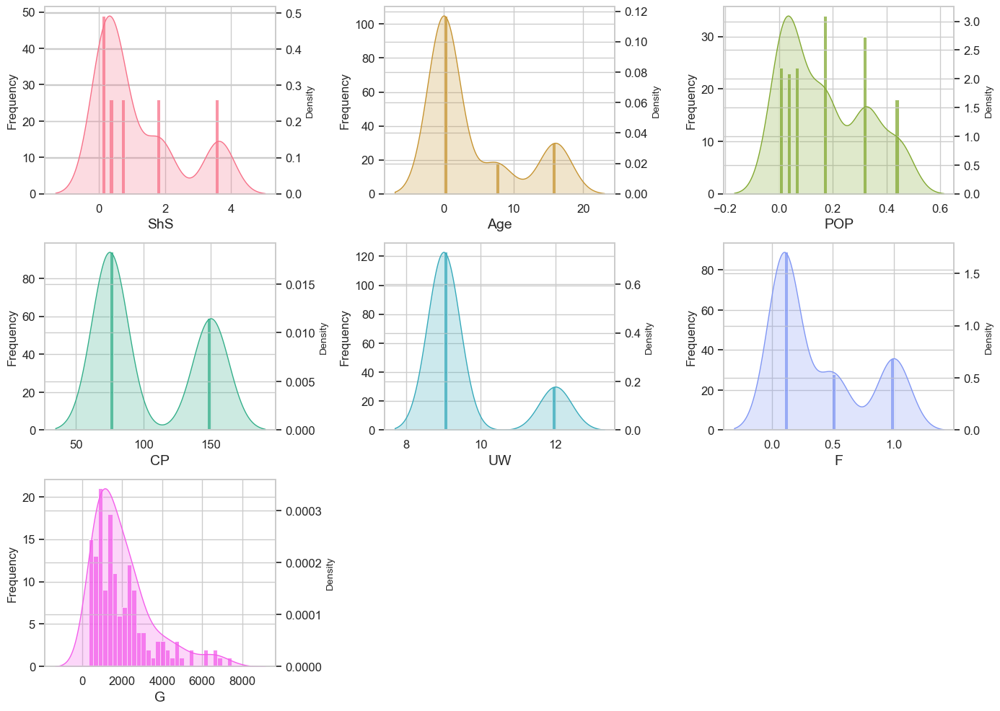

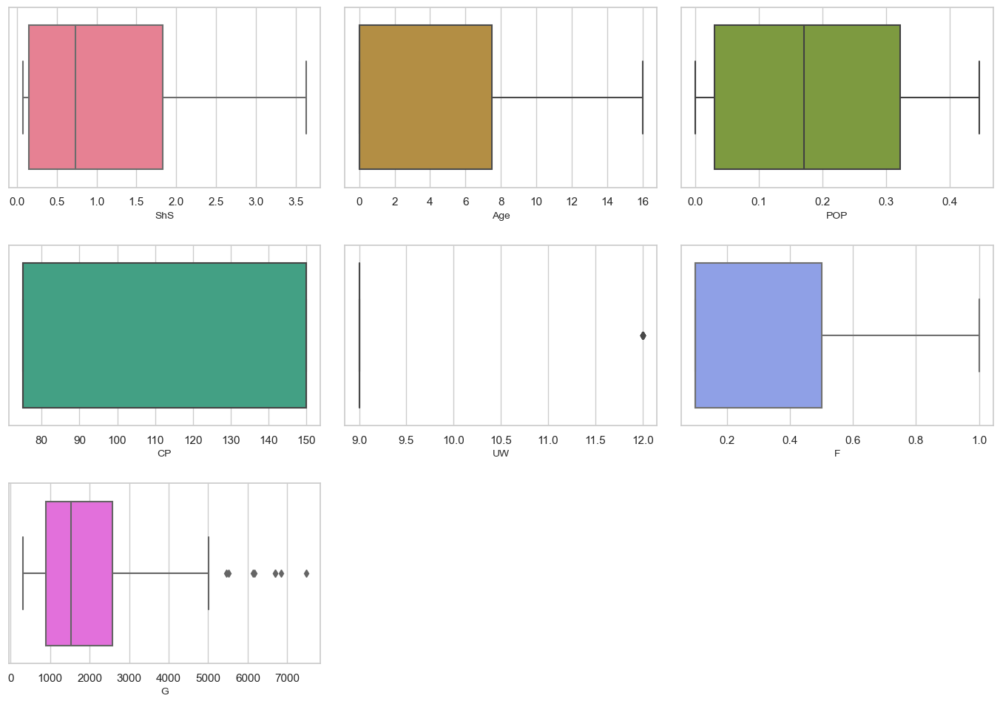

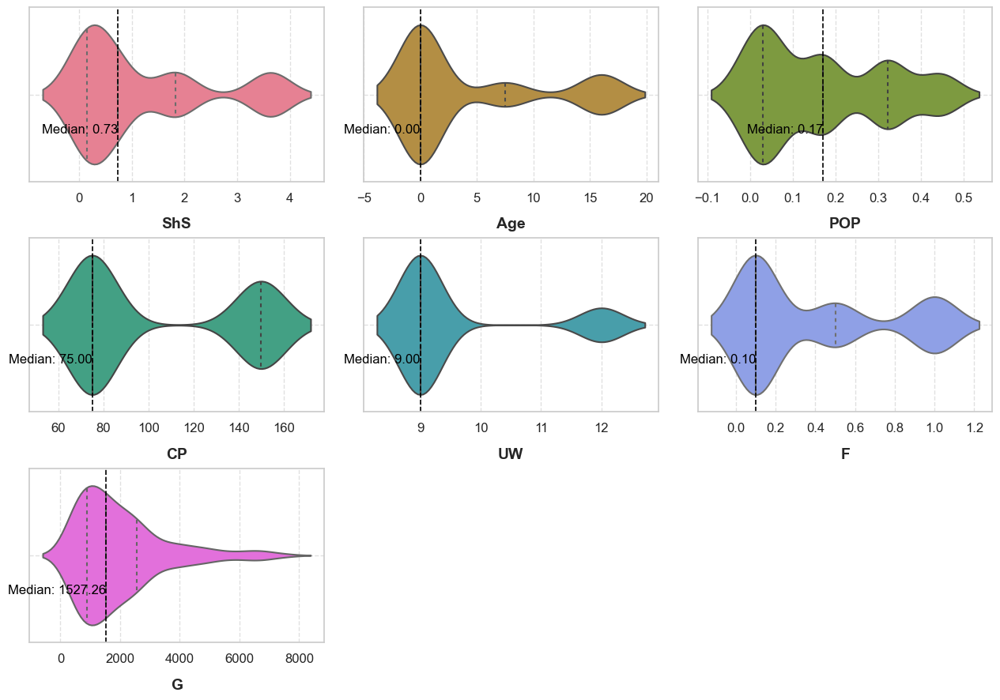

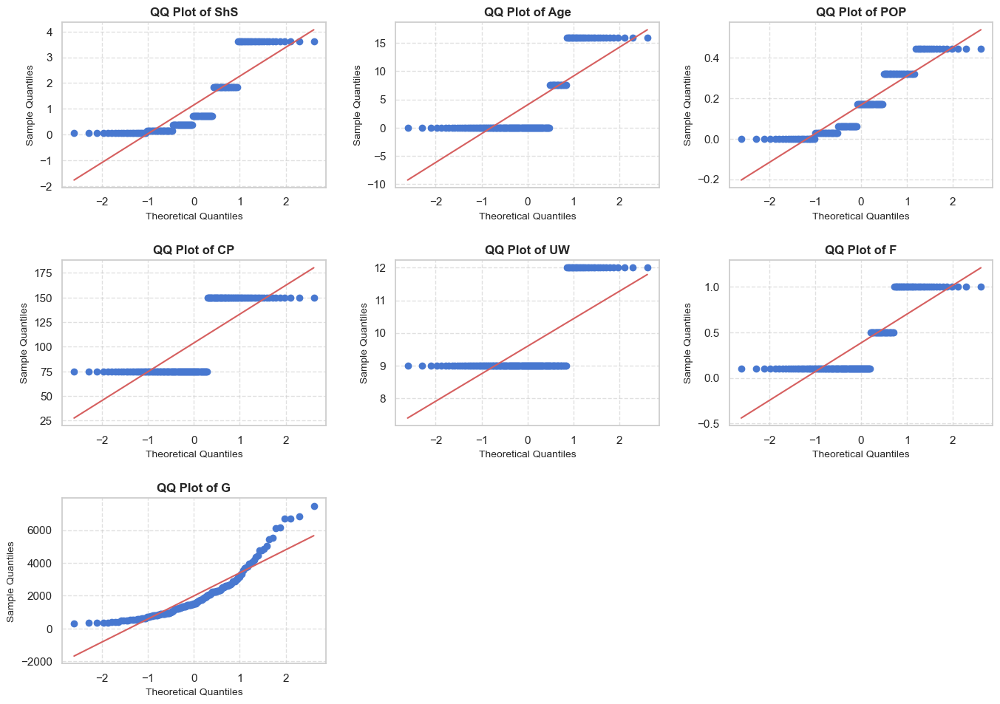

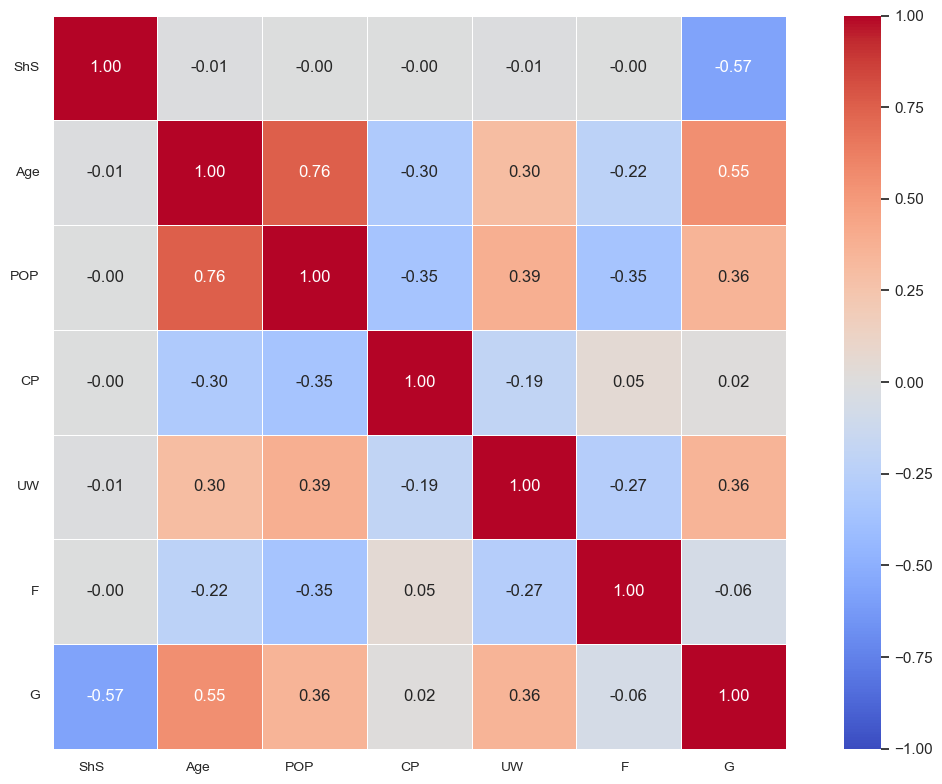

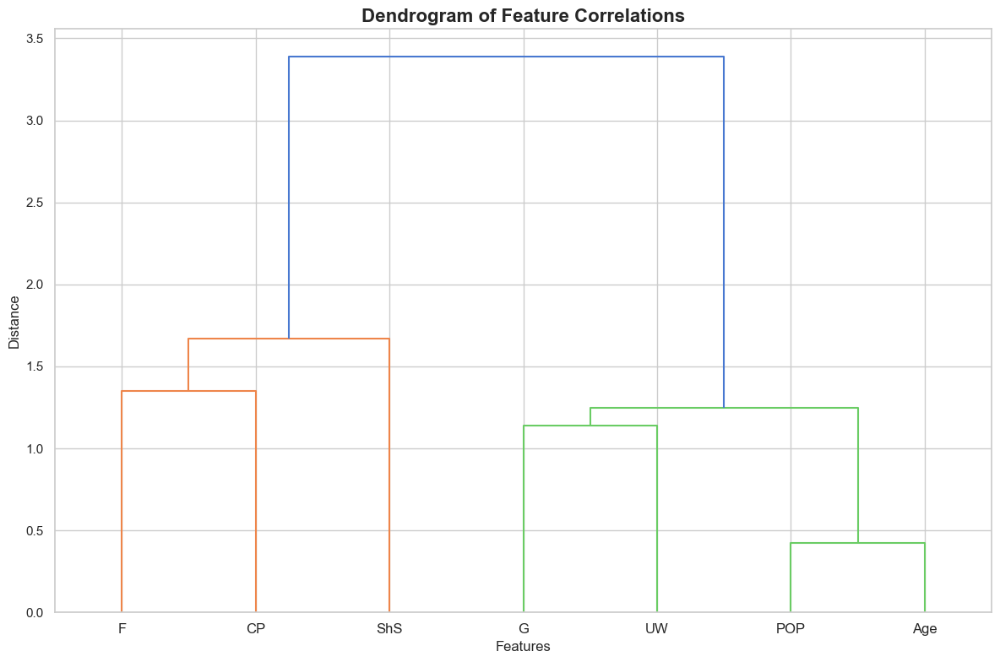

c:\ProgramData\anaconda3\lib\site-packages\plotly\express\_core.py:279: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  dims = [


c:\ProgramData\anaconda3\lib\site-packages\seaborn\axisgrid.py:1507: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.

c:\ProgramData\anaconda3\lib\site-packages\seaborn\axisgrid.py:1507: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.

c:\ProgramData\anaconda3\lib\site-packages\seaborn\axisgrid.py:1507: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.

c:\ProgramData\anaconda3\lib\site-packages\seaborn\axisgrid.py:1507: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.

c:\ProgramData\anaconda3\lib\site-packages\seaborn\axisgrid.py:1507: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.

c:\ProgramData\anaconda3\lib\site-packages\seaborn\axisgrid.py:1507: UserWarning:

Ignoring `palette` because no `hue` variable has been assigned.

c:\ProgramData\anaconda3\lib\site-packages\seaborn\axisgrid.py:1507: UserWarning:

Ignoring `palette` because no

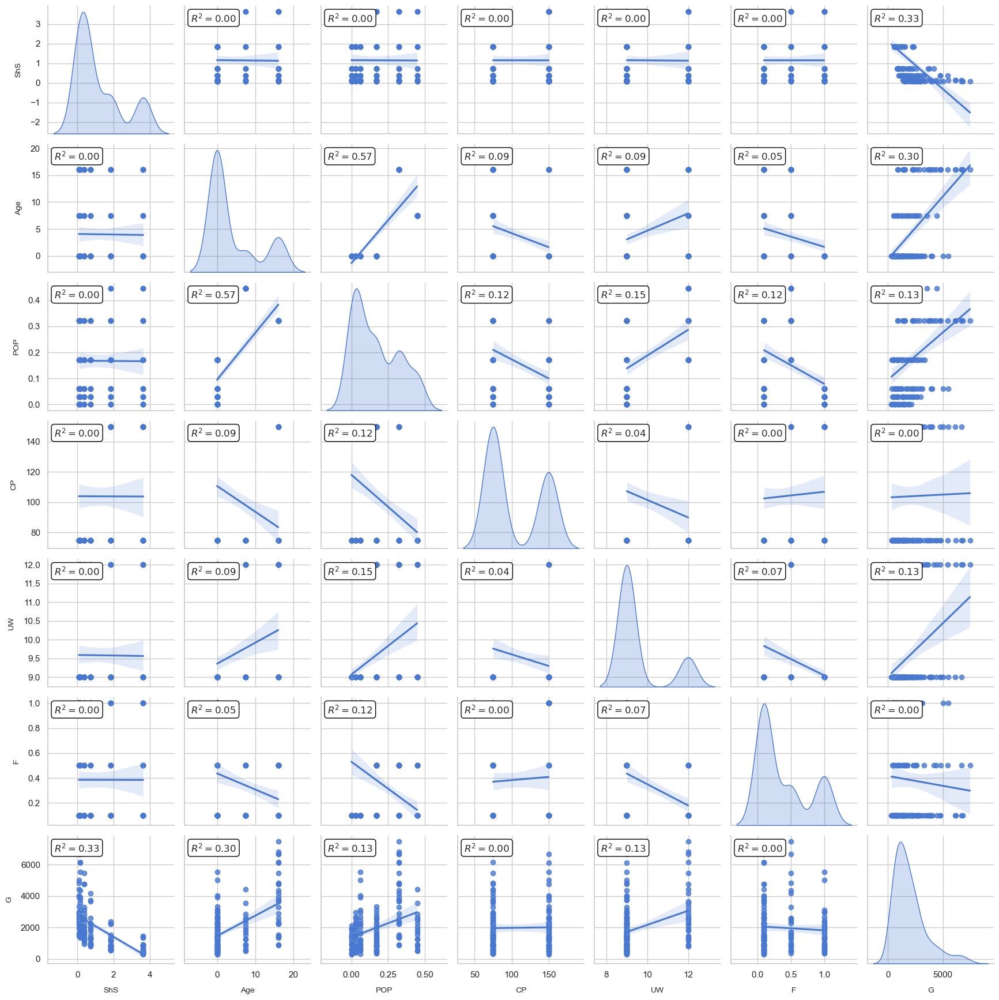

In [6]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sb
import scipy.stats as stats
from scipy.cluster.hierarchy import dendrogram, linkage
from openpyxl import load_workbook

# Set a beautiful theme for all plots
sb.set(style="whitegrid", palette="muted", color_codes=True)

# Descriptive Statistics
descriptive_stats = df.describe()
print("Descriptive Statistics:")
print(descriptive_stats)

# Additional statistical measures
descriptive_stats.loc['variance'] = df.var()
descriptive_stats.loc['skewness'] = df.skew()
descriptive_stats.loc['kurtosis'] = df.kurtosis()

# Perform t-tests between features
t_test_results = {}
for i in range(len(feature_names)):
    for j in range(i + 1, len(feature_names)):
        feature1 = df.columns[i]
        feature2 = df.columns[j]
        t_stat, p_value = stats.ttest_ind(df[feature1].dropna(), df[feature2].dropna())
        t_test_results[f'{feature1} vs {feature2}'] = {'t-statistic': t_stat, 'p-value': p_value}

t_test_df = pd.DataFrame.from_dict(t_test_results, orient='index')

# Save results to Excel
file_name = 'Descriptive_Statistics.xlsx'
with pd.ExcelWriter(file_name, engine='openpyxl', mode='w') as writer:
    descriptive_stats.to_excel(writer, sheet_name='Descriptive_Statistics')
    t_test_df.to_excel(writer, sheet_name='T_Test_Results')

# Custom color palette
custom_palette = sb.color_palette("husl", len(df.columns))

# Combined Histograms and Density Plots
plt.figure(figsize=(14, 10))
for i, column in enumerate(df.columns):
    plt.subplot(3, 3, i + 1)
    
    ax1 = plt.gca()
    sb.histplot(df[column], bins=30, kde=False, color=custom_palette[i], ax=ax1)
    ax1.set_xlabel(feature_names[i], fontsize=14)
    ax1.set_ylabel('Frequency', fontsize=12)
    
    ax2 = ax1.twinx()
    sb.kdeplot(df[column], fill=True, color=custom_palette[i], ax=ax2)
    ax2.set_ylabel('Density', fontsize=10)

    # Set tick label sizes
    ax1.tick_params(axis='both', which='major', labelsize=12)
    ax2.tick_params(axis='both', which='major', labelsize=12)
    
plt.tight_layout(pad=1.0)
#plt.show()

# Save the figure as a PDF with 300 DPI
plt.savefig("Fig5.pdf", format="pdf", dpi=300)

# Box Plots
plt.figure(figsize=(14, 10))
for i, column in enumerate(df.columns):
    plt.subplot(3, 3, i + 1)
    sb.boxplot(x=df[column], color=custom_palette[i])
    plt.xlabel(feature_names[i], fontsize=10)
plt.tight_layout(pad=2.0)
plt.show()

# Violin Plots
plt.figure(figsize=(14, 10))
for i, column in enumerate(df.columns):
    plt.subplot(3, 3, i + 1)
    sb.violinplot(x=df[column], inner="quart", bw=0.3, color=custom_palette[i],
                  linewidth=1.5)
    plt.xlabel(feature_names[i], fontsize=14, fontweight='bold', labelpad=12)
    plt.xticks(fontsize=12)
    plt.yticks(fontsize=12)
    plt.grid(True, which='major', linestyle='--', alpha=0.6)
    ax = plt.gca()
    ax.spines['top'].set_visible(True)
    ax.spines['right'].set_visible(True)
    median = df[column].median()
    plt.axvline(median, color='black', linestyle='--', linewidth=1.2)
    plt.text(median, 0.2, f'Median: {median:.2f}', horizontalalignment='right',
             verticalalignment='center', fontsize=12, color='black')
plt.tight_layout(pad=4.0, w_pad=0.5, h_pad=0.5)
#plt.show()

# Save the figure as a PDF with 300 DPI
plt.savefig("Fig6.pdf", format="pdf", dpi=300)

# QQ Plots
plt.figure(figsize=(14, 10))
for i, column in enumerate(df.columns):
    plt.subplot(3, 3, i + 1)
    stats.probplot(df[column].dropna(), dist="norm", plot=plt)
    plt.title(f'QQ Plot of {feature_names[i]}', fontsize=12, fontweight='bold')
    plt.grid(True, linestyle='--', alpha=0.6)
    plt.xlabel('Theoretical Quantiles', fontsize=10)
    plt.ylabel('Sample Quantiles', fontsize=10)
plt.tight_layout(pad=2.0)
plt.show()

# Correlation Matrix
plt.figure(figsize=(12, 8))
correlation_matrix = df.corr()

sb.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt='.2f', vmin=-1, vmax=1,
           linewidths=.5, square=True,
           xticklabels=feature_names, yticklabels=feature_names)

plt.xticks(rotation=0, ha='right', fontsize=10)
plt.yticks(rotation=0, fontsize=10)
plt.tight_layout()
plt.show()

# Dendrogram
plt.figure(figsize=(12, 8))
linked = linkage(df.corr(), 'ward')

dendrogram(linked, orientation='top', labels=feature_names,
           distance_sort='descending', show_leaf_counts=True)

plt.title('Dendrogram of Feature Correlations', fontsize=16, fontweight='bold')
plt.xlabel('Features', fontsize=12)
plt.ylabel('Distance', fontsize=12)
plt.tight_layout()
plt.show()

# Parallel coordinate plots
import plotly.express as px

regression_colorscale = [[0, 'blue'], [1, 'red']]

fig = px.parallel_coordinates(df, color="G",
                             dimensions=['ShS', 'Age', 'POP', 'CP', 'UW', 'F',"G"],
                             color_continuous_scale=regression_colorscale,
                             color_continuous_midpoint=df['F'].median())
fig.show()

# Pairplot with R² annotations
import seaborn as sb
import matplotlib.pyplot as plt
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score

def annotate_r2(x, y, ax):
    model = LinearRegression()
    x = x.values.reshape(-1, 1)
    y = y.values.reshape(-1, 1)
    model.fit(x, y)
    y_pred = model.predict(x)
    r2 = r2_score(y, y_pred)
    ax.text(0.05, 0.95, f'$R^2 = {r2:.2f}$', transform=ax.transAxes,
            fontsize=12, verticalalignment='top',
            bbox=dict(boxstyle="round,pad=0.3", edgecolor='black', facecolor='white'))

pairplot = sb.pairplot(df, kind="reg", diag_kind="kde", palette="viridis")

for i, ax in enumerate(pairplot.axes.flatten()):
    row_idx = i // len(df.columns)
    col_idx = i % len(df.columns)
    if row_idx != col_idx:
        x_col = df.iloc[:, col_idx]
        y_col = df.iloc[:, row_idx]
        annotate_r2(x_col, y_col, ax)

for i, ax in enumerate(pairplot.axes.flatten()):
    if i % len(df.columns) < len(feature_names):
        ax.set_xlabel(feature_names[i % len(feature_names)], fontsize=10, labelpad=10)
    if i // len(df.columns) < len(feature_names):
        ax.set_ylabel(feature_names[i // len(feature_names)], fontsize=10, labelpad=10)

plt.tight_layout()
#plt.show()
# Save the figure as a PDF with 300 DPI
plt.savefig("Fig7.pdf", format="pdf", dpi=300)


 Single Learners (Non-Ensemble Methods)
 These models work independently and do not rely on combinations of other models


1. Decision Tree

Evaluating Decision Tree model


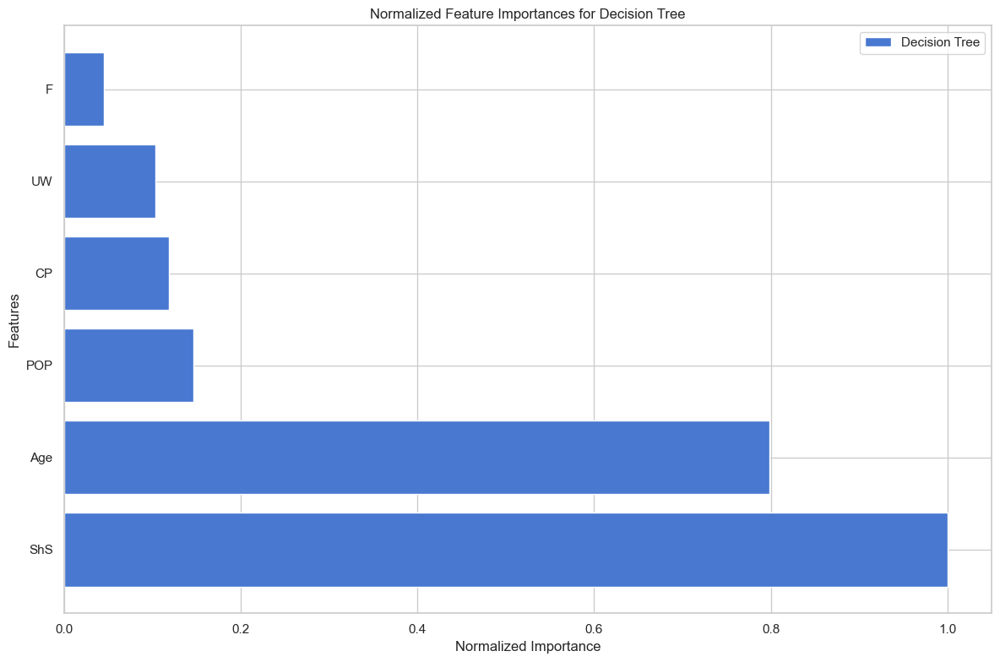

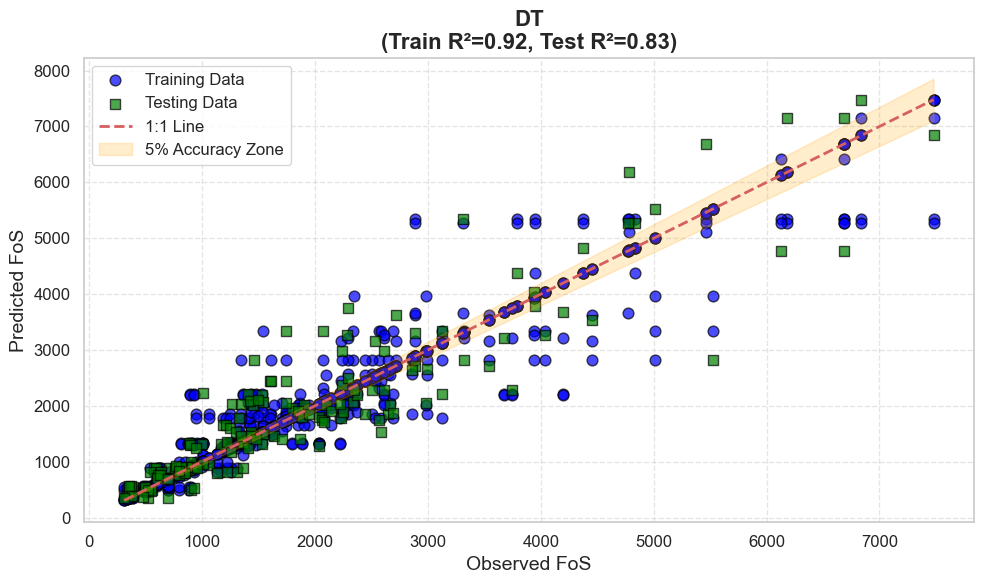

['trained_DT_model.joblib']

In [10]:
import numpy as np
import pandas as pd
import joblib
from sklearn.model_selection import KFold, GridSearchCV
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
from sklearn.tree import DecisionTreeRegressor
from sklearn.preprocessing import StandardScaler
import time
import matplotlib.pyplot as plt

# Define the Decision Tree model
dt_model = DecisionTreeRegressor()

# Parameter tuning for Decision Tree
param_grid = {
    'max_depth': [None, 5, 10, 25],
    'min_samples_split': [2, 5, 20],
    'min_samples_leaf': [1, 2, 4, 10]
}
grid_search = GridSearchCV(dt_model, param_grid, cv=5)
model = grid_search

# Feature names
feature_names = ['ShS', 'Age', 'POP', 'CP', 'UW', 'F']

# Initialize KFold
kfold = KFold(n_splits=7, random_state=42, shuffle=True)

# Prepare a dictionary to store the results
results = []
feature_importances_dict = {}

# Define the function to plot predicted vs observed values
def plot_predicted_vs_observed(y_train, y_train_pred, y_test, y_test_pred, train_r2, test_r2, ax):
    ax.scatter(y_train, y_train_pred, label='Training Data', color='blue', alpha=0.7, edgecolor='black', marker='o', s=60)
    ax.scatter(y_test, y_test_pred, label='Testing Data', color='green', alpha=0.7, edgecolor='black', marker='s', s=60)
    min_val = min(min(y_train), min(y_test))
    max_val = max(max(y_train), max(y_test))
    ax.plot([min_val, max_val], [min_val, max_val], 'r--', label='1:1 Line', linewidth=2)
    ax.fill_between([min_val, max_val], [min_val * 0.95, max_val * 0.95], [min_val * 1.05, max_val * 1.05], color='orange', alpha=0.2, label='5% Accuracy Zone')
    ax.set_title(f'DT\n(Train R²={train_r2:.2f}, Test R²={test_r2:.2f})', fontsize=16, fontweight='bold')
    ax.set_xlabel('Observed FoS', fontsize=14)
    ax.set_ylabel('Predicted FoS', fontsize=14)
    ax.tick_params(axis='both', which='major', labelsize=12)
    ax.legend(loc='upper left', fontsize=12, frameon=True)
    ax.grid(True, linestyle='--', alpha=0.5)
    ax.set_aspect('auto')

# Loop over the model and perform cross-validation
print("Evaluating Decision Tree model")
train_mae_list = []
test_mae_list = []
train_rmse_list = []
test_rmse_list = []
train_r2_list = []
test_r2_list = []

y_train_all = []
y_train_pred_all = []
y_test_all = []
y_test_pred_all = []

start_time = time.time()

for fold_idx, (train_index, test_index) in enumerate(kfold.split(X)):
    X_train, X_test = X[train_index], X[test_index]
    y_train, y_test = y[train_index], y[test_index]

    scaler = StandardScaler()
    X_train_scaled = scaler.fit_transform(X_train)
    X_test_scaled = scaler.transform(X_test)

    model.fit(X_train_scaled, y_train)

    y_train_pred = model.predict(X_train_scaled)
    y_test_pred = model.predict(X_test_scaled)

    y_train_all.extend(y_train)
    y_train_pred_all.extend(y_train_pred)
    y_test_all.extend(y_test)
    y_test_pred_all.extend(y_test_pred)

    train_mae_list.append(mean_absolute_error(y_train, y_train_pred))
    test_mae_list.append(mean_absolute_error(y_test, y_test_pred))
    train_rmse_list.append(np.sqrt(mean_squared_error(y_train, y_train_pred)))
    test_rmse_list.append(np.sqrt(mean_squared_error(y_test, y_test_pred)))
    train_r2_list.append(r2_score(y_train, y_train_pred))
    test_r2_list.append(r2_score(y_test, y_test_pred))

runtime = time.time() - start_time

# Compute mean and std of metrics
def compute_metrics(metrics_list):
    return {
        'mean': np.mean(metrics_list),
        'std': np.std(metrics_list)
    }

results.append({
    'Model': 'DT',
    'Train MAE Mean': compute_metrics(train_mae_list)['mean'],
    'Train MAE Std': compute_metrics(train_mae_list)['std'],
    'Test MAE Mean': compute_metrics(test_mae_list)['mean'],
    'Test MAE Std': compute_metrics(test_mae_list)['std'],
    'Train RMSE Mean': compute_metrics(train_rmse_list)['mean'],
    'Train RMSE Std': compute_metrics(train_rmse_list)['std'],
    'Test RMSE Mean': compute_metrics(test_rmse_list)['mean'],
    'Test RMSE Std': compute_metrics(test_rmse_list)['std'],
    'Train R2 Mean': compute_metrics(train_r2_list)['mean'],
    'Train R2 Std': compute_metrics(train_r2_list)['std'],
    'Test R2 Mean': compute_metrics(test_r2_list)['mean'],
    'Test R2 Std': compute_metrics(test_r2_list)['std'],
    'Runtime (s)': runtime
})

# Collect feature importances
if hasattr(model.best_estimator_, 'feature_importances_'):
    normalized_importances = model.best_estimator_.feature_importances_ / np.max(model.best_estimator_.feature_importances_)
    feature_importances_dict['Decision Tree'] = normalized_importances

# Save predictions for plotting
np.save('DT_y_train.npy', np.array(y_train_all))
np.save('DT_y_train_pred.npy', np.array(y_train_pred_all))
np.save('DT_y_test.npy', np.array(y_test_all))
np.save('DT_y_test_pred.npy', np.array(y_test_pred_all))

# Convert results into DataFrame
results_df = pd.DataFrame(results)

# Save to Excel
with pd.ExcelWriter('Regression_results.xlsx', engine='openpyxl', mode='a', if_sheet_exists='replace') as writer:
    results_df.to_excel(writer, sheet_name='DT', index=False)

    if feature_importances_dict:
        feature_importances_df = pd.DataFrame(feature_importances_dict, index=feature_names)
        feature_importances_df.to_excel(writer, sheet_name='DT Feature Importances')

# Plot normalized feature importances
plt.figure(figsize=(12, 8))
bar_width = 0.8
indices = np.arange(len(feature_names))

for i, (model_name, importances) in enumerate(feature_importances_dict.items()):
    plt.barh(indices + i * bar_width, importances, bar_width, label=model_name)

plt.yticks(indices + (len(feature_importances_dict) - 1) * bar_width / 2, feature_names)
plt.xlabel('Normalized Importance')
plt.ylabel('Features')
plt.title('Normalized Feature Importances for Decision Tree')
plt.legend(loc='best')
plt.tight_layout()
plt.show()

# Prepare the subplot for plotting predicted vs observed
fig, ax = plt.subplots(figsize=(10, 6))

# Load the saved predictions and observed values
y_train = np.load('DT_y_train.npy')
y_train_pred = np.load('DT_y_train_pred.npy')
y_test = np.load('DT_y_test.npy')
y_test_pred = np.load('DT_y_test_pred.npy')

# Calculate R² scores
train_r2 = r2_score(y_train, y_train_pred)
test_r2 = r2_score(y_test, y_test_pred)

# Plot for the Decision Tree model
plot_predicted_vs_observed(y_train, y_train_pred, y_test, y_test_pred, train_r2, test_r2, ax)

plt.tight_layout()
plt.show()

joblib.dump(model.best_estimator_, 'trained_DT_model.joblib')


2. K-Nearest Neighbour

Evaluating KNN model


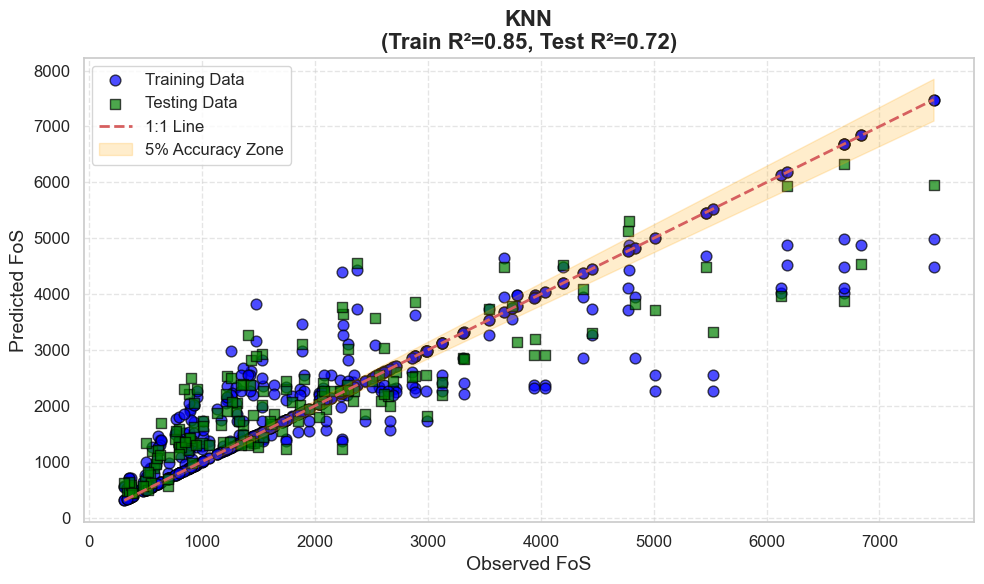

['trained_KNN_model.joblib']

In [12]:
import numpy as np
import pandas as pd
import joblib
from sklearn.model_selection import KFold, GridSearchCV
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
from sklearn.neighbors import KNeighborsRegressor
from sklearn.preprocessing import StandardScaler
import time
import matplotlib.pyplot as plt

# Define the KNN model
knn_model = KNeighborsRegressor()

# Parameter tuning for KNN
param_grid = {
    'n_neighbors': [3, 5, 7, 9, 11],
    'weights': ['uniform', 'distance'],
    'p': [1, 2]  # p=1 for Manhattan, p=2 for Euclidean
}
grid_search = GridSearchCV(knn_model, param_grid, cv=5)
model = grid_search

# Feature names
#feature_names = ['$\\gamma$', 'c', '$\\phi$', '$\\beta$', 'H', '$r_u$']

# Initialize KFold
kfold = KFold(n_splits=5, random_state=42, shuffle=True)

# Prepare a dictionary to store the results
results = []
feature_importances_dict = {}

# Define the function to plot predicted vs observed values
def plot_predicted_vs_observed(y_train, y_train_pred, y_test, y_test_pred, train_r2, test_r2, ax):
    ax.scatter(y_train, y_train_pred, label='Training Data', color='blue', alpha=0.7, edgecolor='black', marker='o', s=60)
    ax.scatter(y_test, y_test_pred, label='Testing Data', color='green', alpha=0.7, edgecolor='black', marker='s', s=60)
    min_val = min(min(y_train), min(y_test))
    max_val = max(max(y_train), max(y_test))
    ax.plot([min_val, max_val], [min_val, max_val], 'r--', label='1:1 Line', linewidth=2)
    ax.fill_between([min_val, max_val], [min_val * 0.95, max_val * 0.95], [min_val * 1.05, max_val * 1.05], color='orange', alpha=0.2, label='5% Accuracy Zone')
    ax.set_title(f'KNN\n(Train R²={train_r2:.2f}, Test R²={test_r2:.2f})', fontsize=16, fontweight='bold')
    ax.set_xlabel('Observed FoS', fontsize=14)
    ax.set_ylabel('Predicted FoS', fontsize=14)
    ax.tick_params(axis='both', which='major', labelsize=12)
    ax.legend(loc='upper left', fontsize=12, frameon=True)
    ax.grid(True, linestyle='--', alpha=0.5)
    ax.set_aspect('auto')

# Loop over the model and perform cross-validation
print("Evaluating KNN model")
train_mae_list = []
test_mae_list = []
train_rmse_list = []
test_rmse_list = []
train_r2_list = []
test_r2_list = []

y_train_all = []
y_train_pred_all = []
y_test_all = []
y_test_pred_all = []

start_time = time.time()

for fold_idx, (train_index, test_index) in enumerate(kfold.split(X)):
    X_train, X_test = X[train_index], X[test_index]
    y_train, y_test = y[train_index], y[test_index]

    scaler = StandardScaler()
    X_train_scaled = scaler.fit_transform(X_train)
    X_test_scaled = scaler.transform(X_test)

    model.fit(X_train_scaled, y_train)

    y_train_pred = model.predict(X_train_scaled)
    y_test_pred = model.predict(X_test_scaled)

    y_train_all.extend(y_train)
    y_train_pred_all.extend(y_train_pred)
    y_test_all.extend(y_test)
    y_test_pred_all.extend(y_test_pred)

    train_mae_list.append(mean_absolute_error(y_train, y_train_pred))
    test_mae_list.append(mean_absolute_error(y_test, y_test_pred))
    train_rmse_list.append(np.sqrt(mean_squared_error(y_train, y_train_pred)))
    test_rmse_list.append(np.sqrt(mean_squared_error(y_test, y_test_pred)))
    train_r2_list.append(r2_score(y_train, y_train_pred))
    test_r2_list.append(r2_score(y_test, y_test_pred))

runtime = time.time() - start_time

# Compute mean and std of metrics
def compute_metrics(metrics_list):
    return {
        'mean': np.mean(metrics_list),
        'std': np.std(metrics_list)
    }

results.append({
    'Model': 'KNN',
    'Train MAE Mean': compute_metrics(train_mae_list)['mean'],
    'Train MAE Std': compute_metrics(train_mae_list)['std'],
    'Test MAE Mean': compute_metrics(test_mae_list)['mean'],
    'Test MAE Std': compute_metrics(test_mae_list)['std'],
    'Train RMSE Mean': compute_metrics(train_rmse_list)['mean'],
    'Train RMSE Std': compute_metrics(train_rmse_list)['std'],
    'Test RMSE Mean': compute_metrics(test_rmse_list)['mean'],
    'Test RMSE Std': compute_metrics(test_rmse_list)['std'],
    'Train R2 Mean': compute_metrics(train_r2_list)['mean'],
    'Train R2 Std': compute_metrics(train_r2_list)['std'],
    'Test R2 Mean': compute_metrics(test_r2_list)['mean'],
    'Test R2 Std': compute_metrics(test_r2_list)['std'],
    'Runtime (s)': runtime
})

# Save predictions for plotting
np.save('KNN_y_train.npy', np.array(y_train_all))
np.save('KNN_y_train_pred.npy', np.array(y_train_pred_all))
np.save('KNN_y_test.npy', np.array(y_test_all))
np.save('KNN_y_test_pred.npy', np.array(y_test_pred_all))

# Convert results into DataFrame
results_df = pd.DataFrame(results)

# Save to Excel
with pd.ExcelWriter('Regression_results.xlsx', engine='openpyxl', mode='a', if_sheet_exists='replace') as writer:
    results_df.to_excel(writer, sheet_name='KNN', index=False)

# Prepare the subplot for plotting predicted vs observed
fig, ax = plt.subplots(figsize=(10, 6))

# Load the saved predictions and observed values
y_train = np.load('KNN_y_train.npy')
y_train_pred = np.load('KNN_y_train_pred.npy')
y_test = np.load('KNN_y_test.npy')
y_test_pred = np.load('KNN_y_test_pred.npy')

# Calculate R² scores
train_r2 = r2_score(y_train, y_train_pred)
test_r2 = r2_score(y_test, y_test_pred)

# Plot for the KNN model
plot_predicted_vs_observed(y_train, y_train_pred, y_test, y_test_pred, train_r2, test_r2, ax)

plt.tight_layout()
plt.show()

joblib.dump(model.best_estimator_, 'trained_KNN_model.joblib')

3. Support Vector Machine

Evaluating SVM model


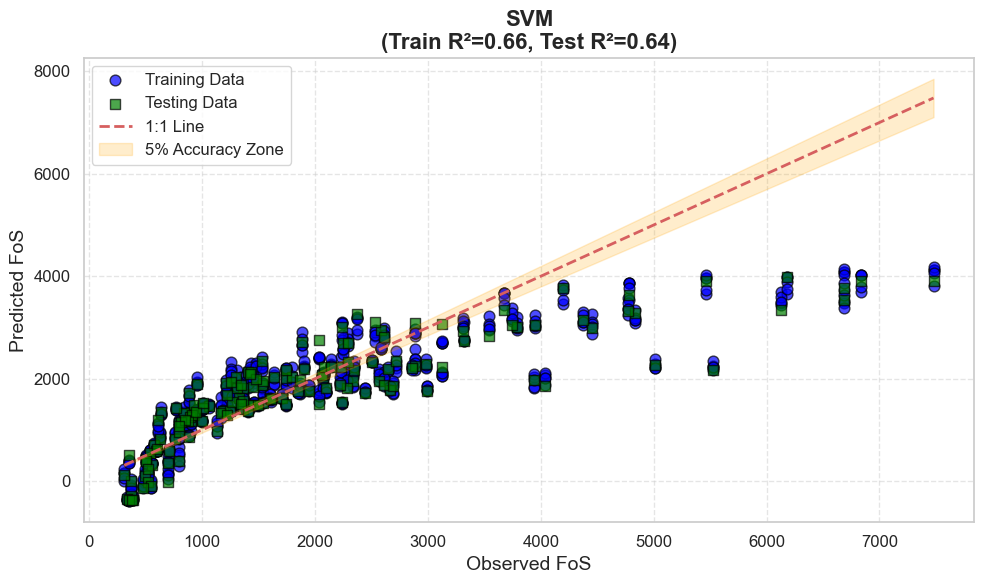

['trained_SVM_model.joblib']

In [13]:
import numpy as np
import pandas as pd
import joblib
from sklearn.model_selection import KFold, GridSearchCV
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
from sklearn.svm import SVR
from sklearn.preprocessing import StandardScaler
import time
import matplotlib.pyplot as plt

# Define the SVM model
svm_model = SVR()

# Parameter tuning for SVM
param_grid = {
    'kernel': ['linear', 'rbf', 'poly'],
    'C': [0.1, 1, 10, 100],
    'gamma': ['scale', 'auto'],
    'epsilon': [0.1, 0.01, 0.001]
}
grid_search = GridSearchCV(svm_model, param_grid, cv=5)
model = grid_search

# Feature names
#feature_names = ['$\\gamma$', 'c', '$\\phi$', '$\\beta$', 'H', '$r_u$']

# Initialize KFold
kfold = KFold(n_splits=6, random_state=42, shuffle=True)

# Prepare a dictionary to store the results
results = []
feature_importances_dict = {}  # SVM doesn't provide feature importances directly

# Define the function to plot predicted vs observed values
def plot_predicted_vs_observed(y_train, y_train_pred, y_test, y_test_pred, train_r2, test_r2, ax):
    ax.scatter(y_train, y_train_pred, label='Training Data', color='blue', alpha=0.7, edgecolor='black', marker='o', s=60)
    ax.scatter(y_test, y_test_pred, label='Testing Data', color='green', alpha=0.7, edgecolor='black', marker='s', s=60)
    min_val = min(min(y_train), min(y_test))
    max_val = max(max(y_train), max(y_test))
    ax.plot([min_val, max_val], [min_val, max_val], 'r--', label='1:1 Line', linewidth=2)
    ax.fill_between([min_val, max_val], [min_val * 0.95, max_val * 0.95], [min_val * 1.05, max_val * 1.05], color='orange', alpha=0.2, label='5% Accuracy Zone')
    ax.set_title(f'SVM\n(Train R²={train_r2:.2f}, Test R²={test_r2:.2f})', fontsize=16, fontweight='bold')
    ax.set_xlabel('Observed FoS', fontsize=14)
    ax.set_ylabel('Predicted FoS', fontsize=14)
    ax.tick_params(axis='both', which='major', labelsize=12)
    ax.legend(loc='upper left', fontsize=12, frameon=True)
    ax.grid(True, linestyle='--', alpha=0.5)
    ax.set_aspect('auto')

# Loop over the model and perform cross-validation
print("Evaluating SVM model")
train_mae_list = []
test_mae_list = []
train_rmse_list = []
test_rmse_list = []
train_r2_list = []
test_r2_list = []

y_train_all = []
y_train_pred_all = []
y_test_all = []
y_test_pred_all = []

start_time = time.time()

for fold_idx, (train_index, test_index) in enumerate(kfold.split(X)):
    X_train, X_test = X[train_index], X[test_index]
    y_train, y_test = y[train_index], y[test_index]

    scaler = StandardScaler()
    X_train_scaled = scaler.fit_transform(X_train)
    X_test_scaled = scaler.transform(X_test)

    model.fit(X_train_scaled, y_train)

    y_train_pred = model.predict(X_train_scaled)
    y_test_pred = model.predict(X_test_scaled)

    y_train_all.extend(y_train)
    y_train_pred_all.extend(y_train_pred)
    y_test_all.extend(y_test)
    y_test_pred_all.extend(y_test_pred)

    train_mae_list.append(mean_absolute_error(y_train, y_train_pred))
    test_mae_list.append(mean_absolute_error(y_test, y_test_pred))
    train_rmse_list.append(np.sqrt(mean_squared_error(y_train, y_train_pred)))
    test_rmse_list.append(np.sqrt(mean_squared_error(y_test, y_test_pred)))
    train_r2_list.append(r2_score(y_train, y_train_pred))
    test_r2_list.append(r2_score(y_test, y_test_pred))

runtime = time.time() - start_time

# Compute mean and std of metrics
def compute_metrics(metrics_list):
    return {
        'mean': np.mean(metrics_list),
        'std': np.std(metrics_list)
    }

results.append({
    'Model': 'SVM',
    'Train MAE Mean': compute_metrics(train_mae_list)['mean'],
    'Train MAE Std': compute_metrics(train_mae_list)['std'],
    'Test MAE Mean': compute_metrics(test_mae_list)['mean'],
    'Test MAE Std': compute_metrics(test_mae_list)['std'],
    'Train RMSE Mean': compute_metrics(train_rmse_list)['mean'],
    'Train RMSE Std': compute_metrics(train_rmse_list)['std'],
    'Test RMSE Mean': compute_metrics(test_rmse_list)['mean'],
    'Test RMSE Std': compute_metrics(test_rmse_list)['std'],
    'Train R2 Mean': compute_metrics(train_r2_list)['mean'],
    'Train R2 Std': compute_metrics(train_r2_list)['std'],
    'Test R2 Mean': compute_metrics(test_r2_list)['mean'],
    'Test R2 Std': compute_metrics(test_r2_list)['std'],
    'Runtime (s)': runtime
})

# Save predictions for plotting
np.save('SVM_y_train.npy', np.array(y_train_all))
np.save('SVM_y_train_pred.npy', np.array(y_train_pred_all))
np.save('SVM_y_test.npy', np.array(y_test_all))
np.save('SVM_y_test_pred.npy', np.array(y_test_pred_all))

# Convert results into DataFrame
results_df = pd.DataFrame(results)

# Save to Excel
with pd.ExcelWriter('Regression_results.xlsx', engine='openpyxl', mode='a', if_sheet_exists='replace') as writer:
    results_df.to_excel(writer, sheet_name='SVM', index=False)

# Prepare the subplot for plotting predicted vs observed
fig, ax = plt.subplots(figsize=(10, 6))

# Load the saved predictions and observed values
y_train = np.load('SVM_y_train.npy')
y_train_pred = np.load('SVM_y_train_pred.npy')
y_test = np.load('SVM_y_test.npy')
y_test_pred = np.load('SVM_y_test_pred.npy')

# Calculate R² scores
train_r2 = r2_score(y_train, y_train_pred)
test_r2 = r2_score(y_test, y_test_pred)

# Plot for the SVM model
plot_predicted_vs_observed(y_train, y_train_pred, y_test, y_test_pred, train_r2, test_r2, ax)

plt.tight_layout()
plt.show()

joblib.dump(model.best_estimator_, 'trained_SVM_model.joblib')

Ensemble Methods (Combination of Models)
These models combine multiple models (either through stacking or voting) to make predictions.

1. Voting Regressor

Evaluating Voting Regressor model


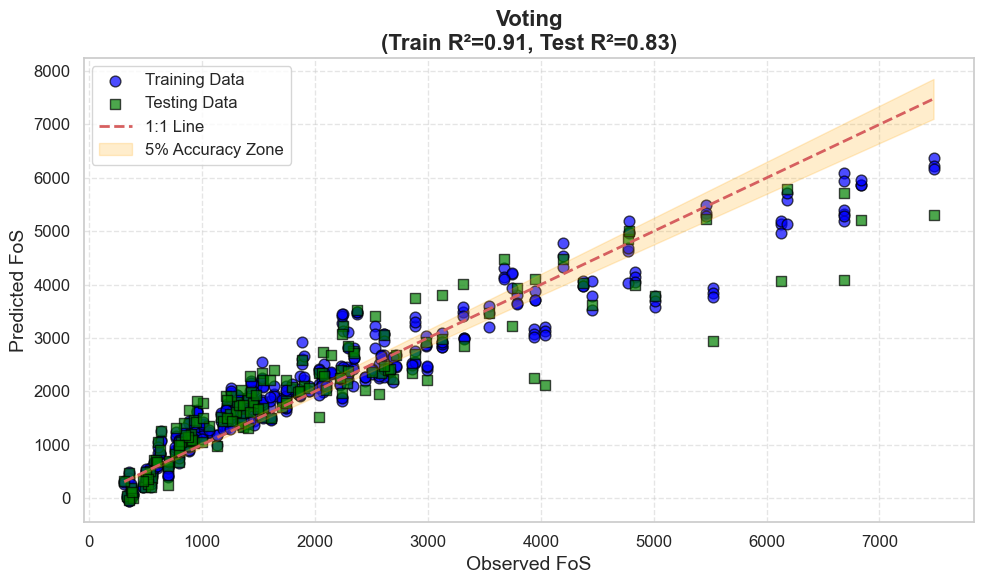

['trained_Voting_model.joblib']

In [14]:
import numpy as np
import pandas as pd
import joblib
from sklearn.model_selection import KFold, GridSearchCV
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
from sklearn.tree import DecisionTreeRegressor
from sklearn.neighbors import KNeighborsRegressor
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import VotingRegressor
from sklearn.preprocessing import StandardScaler
import time
import matplotlib.pyplot as plt

# Define the individual models
dt_model = DecisionTreeRegressor()
knn_model = KNeighborsRegressor()
lr_model = LinearRegression()

# Combine models in a Voting Regressor
voting_regressor = VotingRegressor(estimators=[
    ('dt', dt_model),
    ('knn', knn_model),
    ('lr', lr_model)
])

# Feature names
#feature_names = ['$\\gamma$', 'c', '$\\phi$', '$\\beta$', 'H', '$r_u$']

# Initialize KFold
kfold = KFold(n_splits=4, random_state=42, shuffle=True)

# Prepare a dictionary to store the results
results = []
feature_importances_dict = {}

# Define the function to plot predicted vs observed values
def plot_predicted_vs_observed(y_train, y_train_pred, y_test, y_test_pred, train_r2, test_r2, ax):
    ax.scatter(y_train, y_train_pred, label='Training Data', color='blue', alpha=0.7, edgecolor='black', marker='o', s=60)
    ax.scatter(y_test, y_test_pred, label='Testing Data', color='green', alpha=0.7, edgecolor='black', marker='s', s=60)
    min_val = min(min(y_train), min(y_test))
    max_val = max(max(y_train), max(y_test))
    ax.plot([min_val, max_val], [min_val, max_val], 'r--', label='1:1 Line', linewidth=2)
    ax.fill_between([min_val, max_val], [min_val * 0.95, max_val * 0.95], [min_val * 1.05, max_val * 1.05], color='orange', alpha=0.2, label='5% Accuracy Zone')
    ax.set_title(f'Voting\n(Train R²={train_r2:.2f}, Test R²={test_r2:.2f})', fontsize=16, fontweight='bold')
    ax.set_xlabel('Observed FoS', fontsize=14)
    ax.set_ylabel('Predicted FoS', fontsize=14)
    ax.tick_params(axis='both', which='major', labelsize=12)
    ax.legend(loc='upper left', fontsize=12, frameon=True)
    ax.grid(True, linestyle='--', alpha=0.5)
    ax.set_aspect('auto')

# Loop over the model and perform cross-validation
print("Evaluating Voting Regressor model")
train_mae_list = []
test_mae_list = []
train_rmse_list = []
test_rmse_list = []
train_r2_list = []
test_r2_list = []

y_train_all = []
y_train_pred_all = []
y_test_all = []
y_test_pred_all = []

start_time = time.time()

for fold_idx, (train_index, test_index) in enumerate(kfold.split(X)):
    X_train, X_test = X[train_index], X[test_index]
    y_train, y_test = y[train_index], y[test_index]

    scaler = StandardScaler()
    X_train_scaled = scaler.fit_transform(X_train)
    X_test_scaled = scaler.transform(X_test)

    voting_regressor.fit(X_train_scaled, y_train)

    y_train_pred = voting_regressor.predict(X_train_scaled)
    y_test_pred = voting_regressor.predict(X_test_scaled)

    y_train_all.extend(y_train)
    y_train_pred_all.extend(y_train_pred)
    y_test_all.extend(y_test)
    y_test_pred_all.extend(y_test_pred)

    train_mae_list.append(mean_absolute_error(y_train, y_train_pred))
    test_mae_list.append(mean_absolute_error(y_test, y_test_pred))
    train_rmse_list.append(np.sqrt(mean_squared_error(y_train, y_train_pred)))
    test_rmse_list.append(np.sqrt(mean_squared_error(y_test, y_test_pred)))
    train_r2_list.append(r2_score(y_train, y_train_pred))
    test_r2_list.append(r2_score(y_test, y_test_pred))

runtime = time.time() - start_time

# Compute mean and std of metrics
def compute_metrics(metrics_list):
    return {
        'mean': np.mean(metrics_list),
        'std': np.std(metrics_list)
    }

results.append({
    'Model': 'Voting',
    'Train MAE Mean': compute_metrics(train_mae_list)['mean'],
    'Train MAE Std': compute_metrics(train_mae_list)['std'],
    'Test MAE Mean': compute_metrics(test_mae_list)['mean'],
    'Test MAE Std': compute_metrics(test_mae_list)['std'],
    'Train RMSE Mean': compute_metrics(train_rmse_list)['mean'],
    'Train RMSE Std': compute_metrics(train_rmse_list)['std'],
    'Test RMSE Mean': compute_metrics(test_rmse_list)['mean'],
    'Test RMSE Std': compute_metrics(test_rmse_list)['std'],
    'Train R2 Mean': compute_metrics(train_r2_list)['mean'],
    'Train R2 Std': compute_metrics(train_r2_list)['std'],
    'Test R2 Mean': compute_metrics(test_r2_list)['mean'],
    'Test R2 Std': compute_metrics(test_r2_list)['std'],
    'Runtime (s)': runtime
})

# Save predictions for plotting
np.save('Voting_y_train.npy', np.array(y_train_all))
np.save('Voting_y_train_pred.npy', np.array(y_train_pred_all))
np.save('Voting_y_test.npy', np.array(y_test_all))
np.save('Voting_y_test_pred.npy', np.array(y_test_pred_all))

# Convert results into DataFrame
results_df = pd.DataFrame(results)

# Save to Excel
with pd.ExcelWriter('Regression_results.xlsx', engine='openpyxl', mode='a', if_sheet_exists='replace') as writer:
    results_df.to_excel(writer, sheet_name='Voting', index=False)

# Prepare the subplot for plotting predicted vs observed
fig, ax = plt.subplots(figsize=(10, 6))

# Load the saved predictions and observed values
y_train = np.load('Voting_y_train.npy')
y_train_pred = np.load('Voting_y_train_pred.npy')
y_test = np.load('Voting_y_test.npy')
y_test_pred = np.load('Voting_y_test_pred.npy')

# Calculate R² scores
train_r2 = r2_score(y_train, y_train_pred)
test_r2 = r2_score(y_test, y_test_pred)

# Plot for the Voting Regressor model
plot_predicted_vs_observed(y_train, y_train_pred, y_test, y_test_pred, train_r2, test_r2, ax)

plt.tight_layout()
plt.show()

joblib.dump(voting_regressor, 'trained_Voting_model.joblib')


2. Stacking Regressor: 

Evaluating Stacking Regressor model


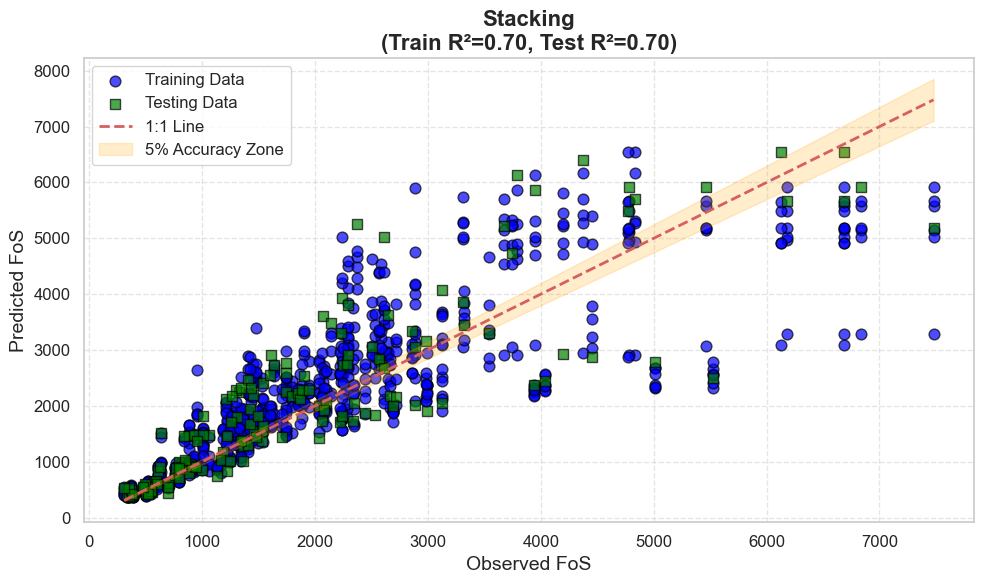

['trained_Stacking_model.joblib']

In [15]:
import numpy as np
import pandas as pd
import joblib
from sklearn.model_selection import KFold
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
from sklearn.tree import DecisionTreeRegressor
from sklearn.neighbors import KNeighborsRegressor
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import StackingRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.preprocessing import StandardScaler
import time
import matplotlib.pyplot as plt

# Define the individual models
dt_model = DecisionTreeRegressor()
knn_model = KNeighborsRegressor()
lr_model = LinearRegression()

# Combine models in a Stacking Regressor
stacking_regressor = StackingRegressor(
    estimators=[
        ('dt', dt_model),
        ('knn', knn_model),
        ('lr', lr_model)
    ],
    final_estimator=RandomForestRegressor()  # Meta-model
)

# Feature names
#feature_names = ['$\\gamma$', 'c', '$\\phi$', '$\\beta$', 'H', '$r_u$']

# Initialize KFold
kfold = KFold(n_splits=7, random_state=42, shuffle=True)

# Prepare a dictionary to store the results
results = []
feature_importances_dict = {}

# Define the function to plot predicted vs observed values
def plot_predicted_vs_observed(y_train, y_train_pred, y_test, y_test_pred, train_r2, test_r2, ax):
    ax.scatter(y_train, y_train_pred, label='Training Data', color='blue', alpha=0.7, edgecolor='black', marker='o', s=60)
    ax.scatter(y_test, y_test_pred, label='Testing Data', color='green', alpha=0.7, edgecolor='black', marker='s', s=60)
    min_val = min(min(y_train), min(y_test))
    max_val = max(max(y_train), max(y_test))
    ax.plot([min_val, max_val], [min_val, max_val], 'r--', label='1:1 Line', linewidth=2)
    ax.fill_between([min_val, max_val], [min_val * 0.95, max_val * 0.95], [min_val * 1.05, max_val * 1.05], color='orange', alpha=0.2, label='5% Accuracy Zone')
    ax.set_title(f'Stacking\n(Train R²={train_r2:.2f}, Test R²={test_r2:.2f})', fontsize=16, fontweight='bold')
    ax.set_xlabel('Observed FoS', fontsize=14)
    ax.set_ylabel('Predicted FoS', fontsize=14)
    ax.tick_params(axis='both', which='major', labelsize=12)
    ax.legend(loc='upper left', fontsize=12, frameon=True)
    ax.grid(True, linestyle='--', alpha=0.5)
    ax.set_aspect('auto')

# Loop over the model and perform cross-validation
print("Evaluating Stacking Regressor model")
train_mae_list = []
test_mae_list = []
train_rmse_list = []
test_rmse_list = []
train_r2_list = []
test_r2_list = []

y_train_all = []
y_train_pred_all = []
y_test_all = []
y_test_pred_all = []

start_time = time.time()

for fold_idx, (train_index, test_index) in enumerate(kfold.split(X)):
    X_train, X_test = X[train_index], X[test_index]
    y_train, y_test = y[train_index], y[test_index]

    scaler = StandardScaler()
    X_train_scaled = scaler.fit_transform(X_train)
    X_test_scaled = scaler.transform(X_test)

    stacking_regressor.fit(X_train_scaled, y_train)

    y_train_pred = stacking_regressor.predict(X_train_scaled)
    y_test_pred = stacking_regressor.predict(X_test_scaled)

    y_train_all.extend(y_train)
    y_train_pred_all.extend(y_train_pred)
    y_test_all.extend(y_test)
    y_test_pred_all.extend(y_test_pred)

    train_mae_list.append(mean_absolute_error(y_train, y_train_pred))
    test_mae_list.append(mean_absolute_error(y_test, y_test_pred))
    train_rmse_list.append(np.sqrt(mean_squared_error(y_train, y_train_pred)))
    test_rmse_list.append(np.sqrt(mean_squared_error(y_test, y_test_pred)))
    train_r2_list.append(r2_score(y_train, y_train_pred))
    test_r2_list.append(r2_score(y_test, y_test_pred))

runtime = time.time() - start_time

# Compute mean and std of metrics
def compute_metrics(metrics_list):
    return {
        'mean': np.mean(metrics_list),
        'std': np.std(metrics_list)
    }

results.append({
    'Model': 'Stacking',
    'Train MAE Mean': compute_metrics(train_mae_list)['mean'],
    'Train MAE Std': compute_metrics(train_mae_list)['std'],
    'Test MAE Mean': compute_metrics(test_mae_list)['mean'],
    'Test MAE Std': compute_metrics(test_mae_list)['std'],
    'Train RMSE Mean': compute_metrics(train_rmse_list)['mean'],
    'Train RMSE Std': compute_metrics(train_rmse_list)['std'],
    'Test RMSE Mean': compute_metrics(test_rmse_list)['mean'],
    'Test RMSE Std': compute_metrics(test_rmse_list)['std'],
    'Train R2 Mean': compute_metrics(train_r2_list)['mean'],
    'Train R2 Std': compute_metrics(train_r2_list)['std'],
    'Test R2 Mean': compute_metrics(test_r2_list)['mean'],
    'Test R2 Std': compute_metrics(test_r2_list)['std'],
    'Runtime (s)': runtime
})

# Save predictions for plotting
np.save('Stacking_y_train.npy', np.array(y_train_all))
np.save('Stacking_y_train_pred.npy', np.array(y_train_pred_all))
np.save('Stacking_y_test.npy', np.array(y_test_all))
np.save('Stacking_y_test_pred.npy', np.array(y_test_pred_all))

# Convert results into DataFrame
results_df = pd.DataFrame(results)

# Save to Excel
with pd.ExcelWriter('Regression_results.xlsx', engine='openpyxl', mode='a', if_sheet_exists='replace') as writer:
    results_df.to_excel(writer, sheet_name='Stacking', index=False)

# Prepare the subplot for plotting predicted vs observed
fig, ax = plt.subplots(figsize=(10, 6))

# Load the saved predictions and observed values
y_train = np.load('Stacking_y_train.npy')
y_train_pred = np.load('Stacking_y_train_pred.npy')
y_test = np.load('Stacking_y_test.npy')
y_test_pred = np.load('Stacking_y_test_pred.npy')

# Calculate R² scores
train_r2 = r2_score(y_train, y_train_pred)
test_r2 = r2_score(y_test, y_test_pred)

# Plot for the Stacking Regressor model
plot_predicted_vs_observed(y_train, y_train_pred, y_test, y_test_pred, train_r2, test_r2, ax)

plt.tight_layout()
plt.show()

joblib.dump(stacking_regressor, 'trained_Stacking_model.joblib')


Bagging Methods

Bagging trains multiple models independently and combines their results to reduce variance.

1. Bagging

Evaluating Bagging Regressor model


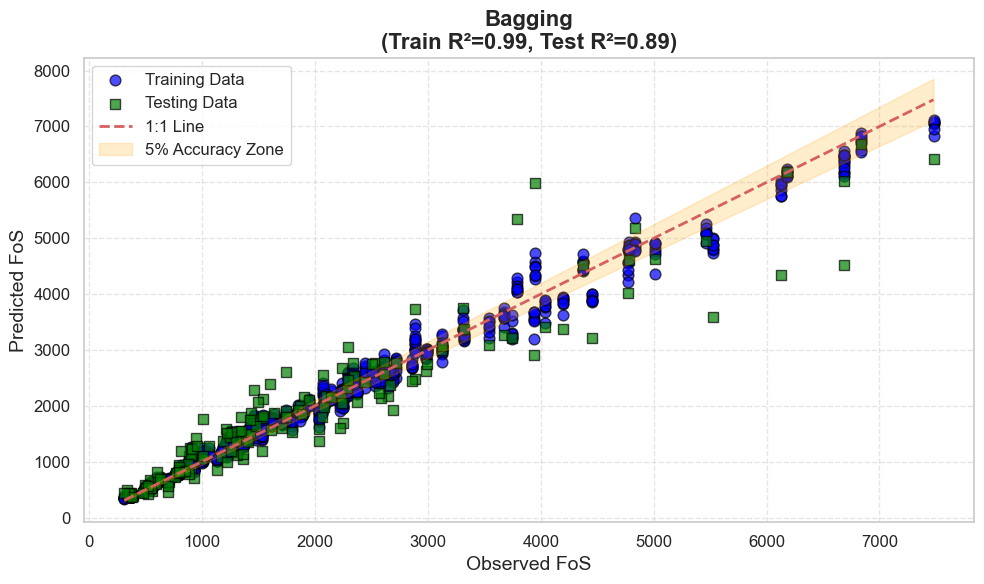

['trained_Bagging_model.joblib']

In [16]:
import numpy as np
import pandas as pd
import joblib
from sklearn.model_selection import KFold
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import BaggingRegressor
from sklearn.preprocessing import StandardScaler
import time
import matplotlib.pyplot as plt

# Define the individual model
dt_model = DecisionTreeRegressor()

# Define the Bagging Regressor model using DecisionTreeRegressor by default
bagging_regressor = BaggingRegressor(n_estimators=100, random_state=42)  # You can adjust n_estimators

# Feature names
#feature_names = ['$\\gamma$', 'c', '$\\phi$', '$\\beta$', 'H', '$r_u$']

# Initialize KFold
kfold = KFold(n_splits=8, random_state=42, shuffle=True)

# Prepare a dictionary to store the results
results = []

# Define the function to plot predicted vs observed values
def plot_predicted_vs_observed(y_train, y_train_pred, y_test, y_test_pred, train_r2, test_r2, ax):
    ax.scatter(y_train, y_train_pred, label='Training Data', color='blue', alpha=0.7, edgecolor='black', marker='o', s=60)
    ax.scatter(y_test, y_test_pred, label='Testing Data', color='green', alpha=0.7, edgecolor='black', marker='s', s=60)
    min_val = min(min(y_train), min(y_test))
    max_val = max(max(y_train), max(y_test))
    ax.plot([min_val, max_val], [min_val, max_val], 'r--', label='1:1 Line', linewidth=2)
    ax.fill_between([min_val, max_val], [min_val * 0.95, max_val * 0.95], [min_val * 1.05, max_val * 1.05], color='orange', alpha=0.2, label='5% Accuracy Zone')
    ax.set_title(f'Bagging\n(Train R²={train_r2:.2f}, Test R²={test_r2:.2f})', fontsize=16, fontweight='bold')
    ax.set_xlabel('Observed FoS', fontsize=14)
    ax.set_ylabel('Predicted FoS', fontsize=14)
    ax.tick_params(axis='both', which='major', labelsize=12)
    ax.legend(loc='upper left', fontsize=12, frameon=True)
    ax.grid(True, linestyle='--', alpha=0.5)
    ax.set_aspect('auto')

# Loop over the model and perform cross-validation
print("Evaluating Bagging Regressor model")
train_mae_list = []
test_mae_list = []
train_rmse_list = []
test_rmse_list = []
train_r2_list = []
test_r2_list = []

y_train_all = []
y_train_pred_all = []
y_test_all = []
y_test_pred_all = []

start_time = time.time()

for fold_idx, (train_index, test_index) in enumerate(kfold.split(X)):
    X_train, X_test = X[train_index], X[test_index]
    y_train, y_test = y[train_index], y[test_index]

    scaler = StandardScaler()
    X_train_scaled = scaler.fit_transform(X_train)
    X_test_scaled = scaler.transform(X_test)

    bagging_regressor.fit(X_train_scaled, y_train)

    y_train_pred = bagging_regressor.predict(X_train_scaled)
    y_test_pred = bagging_regressor.predict(X_test_scaled)

    y_train_all.extend(y_train)
    y_train_pred_all.extend(y_train_pred)
    y_test_all.extend(y_test)
    y_test_pred_all.extend(y_test_pred)

    train_mae_list.append(mean_absolute_error(y_train, y_train_pred))
    test_mae_list.append(mean_absolute_error(y_test, y_test_pred))
    train_rmse_list.append(np.sqrt(mean_squared_error(y_train, y_train_pred)))
    test_rmse_list.append(np.sqrt(mean_squared_error(y_test, y_test_pred)))
    train_r2_list.append(r2_score(y_train, y_train_pred))
    test_r2_list.append(r2_score(y_test, y_test_pred))

runtime = time.time() - start_time

# Compute mean and std of metrics
def compute_metrics(metrics_list):
    return {
        'mean': np.mean(metrics_list),
        'std': np.std(metrics_list)
    }

results.append({
    'Model': 'Bagging',
    'Train MAE Mean': compute_metrics(train_mae_list)['mean'],
    'Train MAE Std': compute_metrics(train_mae_list)['std'],
    'Test MAE Mean': compute_metrics(test_mae_list)['mean'],
    'Test MAE Std': compute_metrics(test_mae_list)['std'],
    'Train RMSE Mean': compute_metrics(train_rmse_list)['mean'],
    'Train RMSE Std': compute_metrics(train_rmse_list)['std'],
    'Test RMSE Mean': compute_metrics(test_rmse_list)['mean'],
    'Test RMSE Std': compute_metrics(test_rmse_list)['std'],
    'Train R2 Mean': compute_metrics(train_r2_list)['mean'],
    'Train R2 Std': compute_metrics(train_r2_list)['std'],
    'Test R2 Mean': compute_metrics(test_r2_list)['mean'],
    'Test R2 Std': compute_metrics(test_r2_list)['std'],
    'Runtime (s)': runtime
})

# Save predictions for plotting
np.save('Bagging_y_train.npy', np.array(y_train_all))
np.save('Bagging_y_train_pred.npy', np.array(y_train_pred_all))
np.save('Bagging_y_test.npy', np.array(y_test_all))
np.save('Bagging_y_test_pred.npy', np.array(y_test_pred_all))

# Convert results into DataFrame
results_df = pd.DataFrame(results)

# Append new results to the existing Excel file
with pd.ExcelWriter('Regression_results.xlsx', engine='openpyxl', mode='a', if_sheet_exists='replace') as writer:
    results_df.to_excel(writer, sheet_name='Bagging', index=False)

# Prepare the subplot for plotting predicted vs observed
fig, ax = plt.subplots(figsize=(10, 6))

# Load the saved predictions and observed values
y_train = np.load('Bagging_y_train.npy')
y_train_pred = np.load('Bagging_y_train_pred.npy')
y_test = np.load('Bagging_y_test.npy')
y_test_pred = np.load('Bagging_y_test_pred.npy')

# Calculate R² scores
train_r2 = r2_score(y_train, y_train_pred)
test_r2 = r2_score(y_test, y_test_pred)

# Plot for the Bagging Regressor model
plot_predicted_vs_observed(y_train, y_train_pred, y_test, y_test_pred, train_r2, test_r2, ax)

plt.tight_layout()
plt.show()

joblib.dump(bagging_regressor, 'trained_Bagging_model.joblib')

2. Random Forest

Evaluating Random Forest model


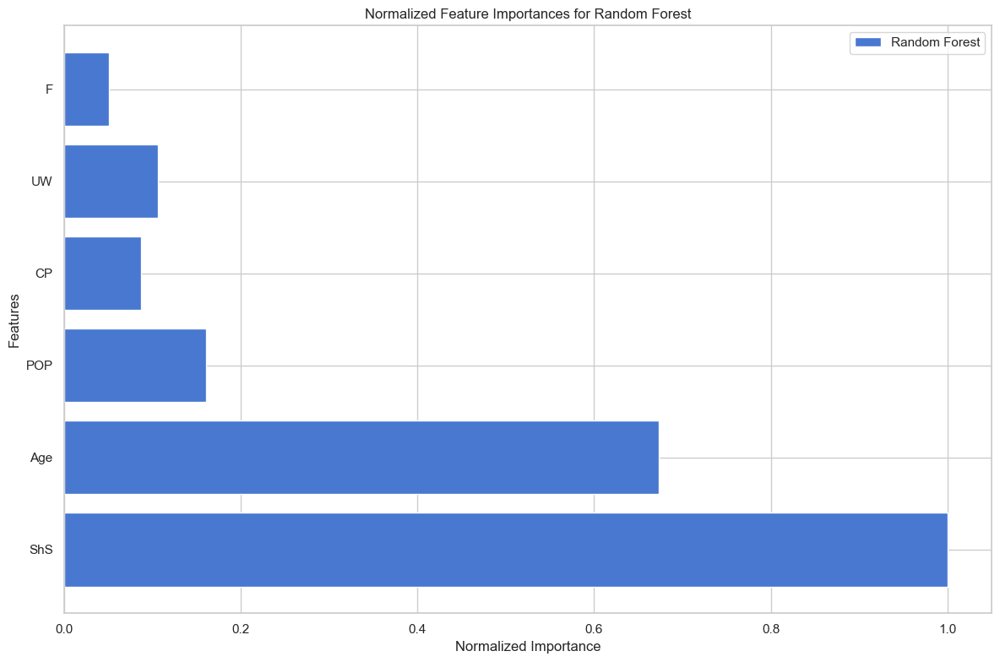

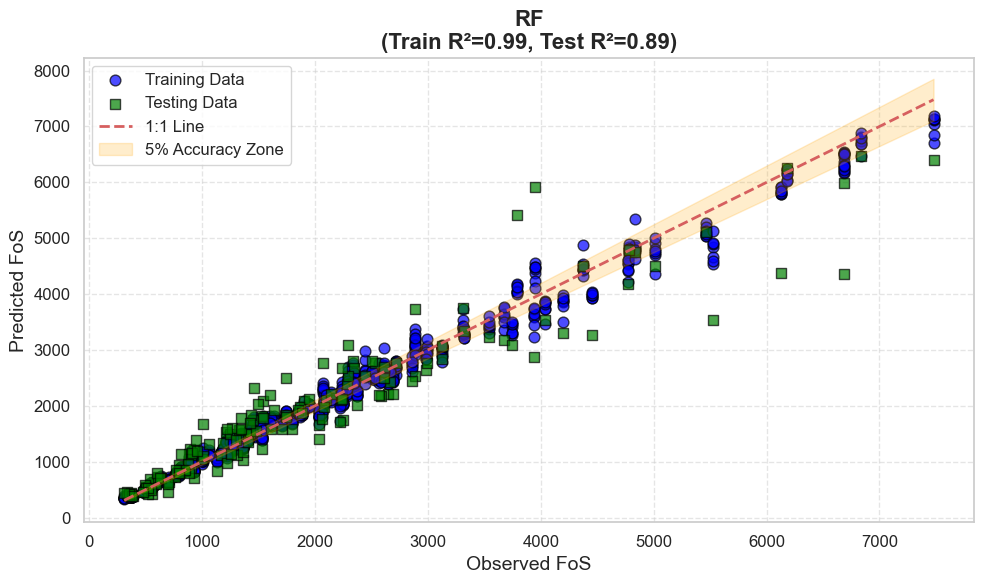

['trained_RF_model.joblib']

In [ ]:
import numpy as np
import pandas as pd
import joblib
from sklearn.model_selection import KFold, GridSearchCV
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
from sklearn.ensemble import RandomForestRegressor
from sklearn.preprocessing import StandardScaler
import time
import matplotlib.pyplot as plt

# Define the Random Forest model
rf_model = RandomForestRegressor()

# Parameter tuning for Random Forest
param_grid = {
    'n_estimators': [100, 150],
    'max_depth': [None, 5,  15],
    'min_samples_split': [2, 15],
    'min_samples_leaf': [1, 2, 6]
}
grid_search = GridSearchCV(rf_model, param_grid, cv=5)
model = grid_search

# Feature names
#feature_names = ['$\\gamma$', 'c', '$\\phi$', '$\\beta$', 'H', '$r_u$']

# Initialize KFold
kfold = KFold(n_splits=8, random_state=42, shuffle=True)

# Prepare a dictionary to store the results
results = []
feature_importances_dict = {}

# Define the function to plot predicted vs observed values
def plot_predicted_vs_observed(y_train, y_train_pred, y_test, y_test_pred, train_r2, test_r2, ax):
    ax.scatter(y_train, y_train_pred, label='Training Data', color='blue', alpha=0.7, edgecolor='black', marker='o', s=60)
    ax.scatter(y_test, y_test_pred, label='Testing Data', color='green', alpha=0.7, edgecolor='black', marker='s', s=60)
    min_val = min(min(y_train), min(y_test))
    max_val = max(max(y_train), max(y_test))
    ax.plot([min_val, max_val], [min_val, max_val], 'r--', label='1:1 Line', linewidth=2)
    ax.fill_between([min_val, max_val], [min_val * 0.95, max_val * 0.95], [min_val * 1.05, max_val * 1.05], color='orange', alpha=0.2, label='5% Accuracy Zone')
    ax.set_title(f'RF\n(Train R²={train_r2:.2f}, Test R²={test_r2:.2f})', fontsize=16, fontweight='bold')
    ax.set_xlabel('Observed FoS', fontsize=14)
    ax.set_ylabel('Predicted FoS', fontsize=14)
    ax.tick_params(axis='both', which='major', labelsize=12)
    ax.legend(loc='upper left', fontsize=12, frameon=True)
    ax.grid(True, linestyle='--', alpha=0.5)
    ax.set_aspect('auto')

# Loop over the model and perform cross-validation
print("Evaluating Random Forest model")
train_mae_list = []
test_mae_list = []
train_rmse_list = []
test_rmse_list = []
train_r2_list = []
test_r2_list = []

y_train_all = []
y_train_pred_all = []
y_test_all = []
y_test_pred_all = []

start_time = time.time()

for fold_idx, (train_index, test_index) in enumerate(kfold.split(X)):
    X_train, X_test = X[train_index], X[test_index]
    y_train, y_test = y[train_index], y[test_index]

    scaler = StandardScaler()
    X_train_scaled = scaler.fit_transform(X_train)
    X_test_scaled = scaler.transform(X_test)

    model.fit(X_train_scaled, y_train)

    y_train_pred = model.predict(X_train_scaled)
    y_test_pred = model.predict(X_test_scaled)

    y_train_all.extend(y_train)
    y_train_pred_all.extend(y_train_pred)
    y_test_all.extend(y_test)
    y_test_pred_all.extend(y_test_pred)

    train_mae_list.append(mean_absolute_error(y_train, y_train_pred))
    test_mae_list.append(mean_absolute_error(y_test, y_test_pred))
    train_rmse_list.append(np.sqrt(mean_squared_error(y_train, y_train_pred)))
    test_rmse_list.append(np.sqrt(mean_squared_error(y_test, y_test_pred)))
    train_r2_list.append(r2_score(y_train, y_train_pred))
    test_r2_list.append(r2_score(y_test, y_test_pred))

runtime = time.time() - start_time

# Compute mean and std of metrics
def compute_metrics(metrics_list):
    return {
        'mean': np.mean(metrics_list),
        'std': np.std(metrics_list)
    }

results.append({
    'Model': 'RF',
    'Train MAE Mean': compute_metrics(train_mae_list)['mean'],
    'Train MAE Std': compute_metrics(train_mae_list)['std'],
    'Test MAE Mean': compute_metrics(test_mae_list)['mean'],
    'Test MAE Std': compute_metrics(test_mae_list)['std'],
    'Train RMSE Mean': compute_metrics(train_rmse_list)['mean'],
    'Train RMSE Std': compute_metrics(train_rmse_list)['std'],
    'Test RMSE Mean': compute_metrics(test_rmse_list)['mean'],
    'Test RMSE Std': compute_metrics(test_rmse_list)['std'],
    'Train R2 Mean': compute_metrics(train_r2_list)['mean'],
    'Train R2 Std': compute_metrics(train_r2_list)['std'],
    'Test R2 Mean': compute_metrics(test_r2_list)['mean'],
    'Test R2 Std': compute_metrics(test_r2_list)['std'],
    'Runtime (s)': runtime
})

# Collect feature importances
if hasattr(model.best_estimator_, 'feature_importances_'):
    normalized_importances = model.best_estimator_.feature_importances_ / np.max(model.best_estimator_.feature_importances_)
    feature_importances_dict['Random Forest'] = normalized_importances

# Save predictions for plotting
np.save('RF_y_train.npy', np.array(y_train_all))
np.save('RF_y_train_pred.npy', np.array(y_train_pred_all))
np.save('RF_y_test.npy', np.array(y_test_all))
np.save('RF_y_test_pred.npy', np.array(y_test_pred_all))

# Convert results into DataFrame
results_df = pd.DataFrame(results)

# Save to Excel
with pd.ExcelWriter('Regression_results.xlsx', engine='openpyxl', mode='a', if_sheet_exists='replace') as writer:
    results_df.to_excel(writer, sheet_name='RF', index=False)

    if feature_importances_dict:
        feature_importances_df = pd.DataFrame(feature_importances_dict, index=feature_names)
        feature_importances_df.to_excel(writer, sheet_name='RF Feature Importances')

# Plot normalized feature importances
plt.figure(figsize=(12, 8))
bar_width = 0.8
indices = np.arange(len(feature_names))

for i, (model_name, importances) in enumerate(feature_importances_dict.items()):
    plt.barh(indices + i * bar_width, importances, bar_width, label=model_name)

plt.yticks(indices + (len(feature_importances_dict) - 1) * bar_width / 2, feature_names)
plt.xlabel('Normalized Importance')
plt.ylabel('Features')
plt.title('Normalized Feature Importances for Random Forest')
plt.legend(loc='best')
plt.tight_layout()
plt.show()

# Prepare the subplot for plotting predicted vs observed
fig, ax = plt.subplots(figsize=(10, 6))

# Load the saved predictions and observed values
y_train = np.load('RF_y_train.npy')
y_train_pred = np.load('RF_y_train_pred.npy')
y_test = np.load('RF_y_test.npy')
y_test_pred = np.load('RF_y_test_pred.npy')

# Calculate R² scores
train_r2 = r2_score(y_train, y_train_pred)
test_r2 = r2_score(y_test, y_test_pred)

# Plot for the Random Forest model
plot_predicted_vs_observed(y_train, y_train_pred, y_test, y_test_pred, train_r2, test_r2, ax)

plt.tight_layout()
plt.show()

joblib.dump(model.best_estimator_, 'trained_RF_model.joblib')

3. Extra Tree

Evaluating Extra Trees model


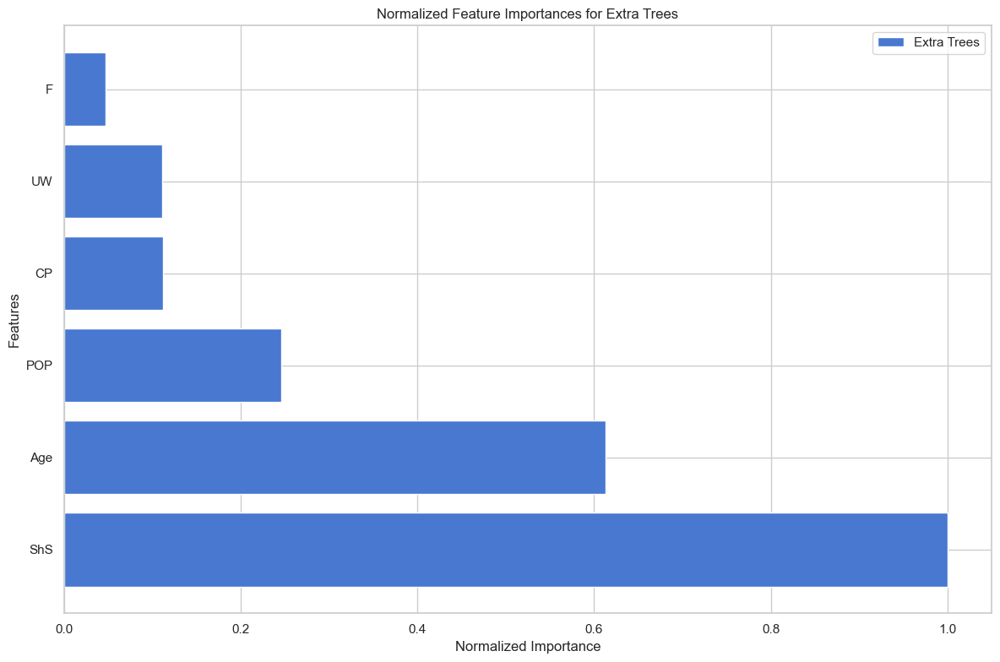

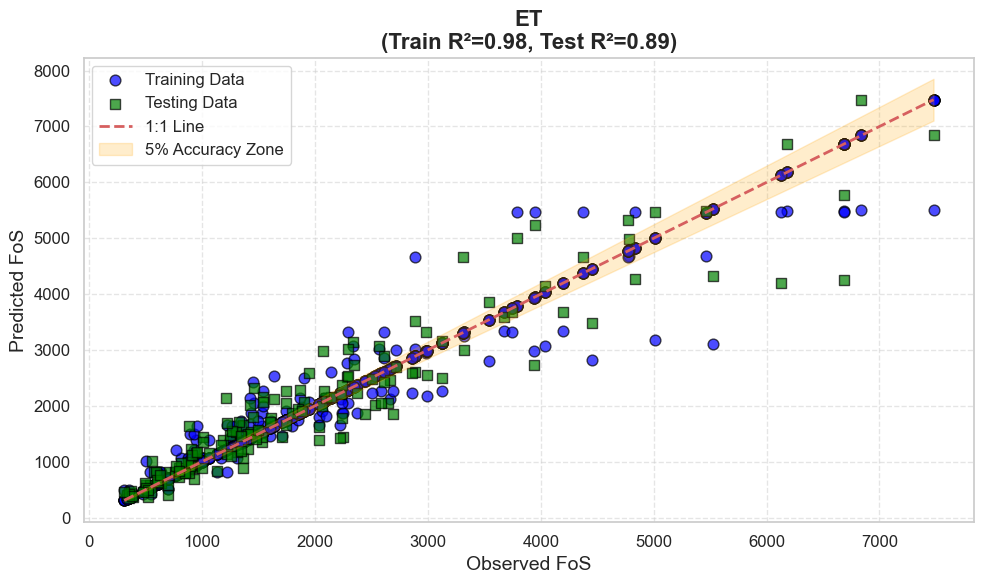

['trained_ET_model.joblib']

In [19]:
import numpy as np
import pandas as pd
import joblib
from sklearn.model_selection import KFold, GridSearchCV
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
from sklearn.ensemble import ExtraTreesRegressor
from sklearn.preprocessing import StandardScaler
import time
import matplotlib.pyplot as plt

# Define the Extra Trees model
et_model = ExtraTreesRegressor()

# Parameter tuning for Extra Trees
param_grid = {
    'n_estimators': [50, 150],
    'max_depth': [None, 5, 15],
    'min_samples_split': [2, 5, 15],
    'min_samples_leaf': [1, 2, 6]
}
grid_search = GridSearchCV(et_model, param_grid, cv=5)
model = grid_search

# Feature names
#feature_names = ['$\\gamma$', 'c', '$\\phi$', '$\\beta$', 'H', '$r_u$']

# Initialize KFold
kfold = KFold(n_splits=8, random_state=42, shuffle=True)

# Prepare a dictionary to store the results
results = []
feature_importances_dict = {}

# Define the function to plot predicted vs observed values
def plot_predicted_vs_observed(y_train, y_train_pred, y_test, y_test_pred, train_r2, test_r2, ax):
    ax.scatter(y_train, y_train_pred, label='Training Data', color='blue', alpha=0.7, edgecolor='black', marker='o', s=60)
    ax.scatter(y_test, y_test_pred, label='Testing Data', color='green', alpha=0.7, edgecolor='black', marker='s', s=60)
    min_val = min(min(y_train), min(y_test))
    max_val = max(max(y_train), max(y_test))
    ax.plot([min_val, max_val], [min_val, max_val], 'r--', label='1:1 Line', linewidth=2)
    ax.fill_between([min_val, max_val], [min_val * 0.95, max_val * 0.95], [min_val * 1.05, max_val * 1.05], color='orange', alpha=0.2, label='5% Accuracy Zone')
    ax.set_title(f'ET\n(Train R²={train_r2:.2f}, Test R²={test_r2:.2f})', fontsize=16, fontweight='bold')
    ax.set_xlabel('Observed FoS', fontsize=14)
    ax.set_ylabel('Predicted FoS', fontsize=14)
    ax.tick_params(axis='both', which='major', labelsize=12)
    ax.legend(loc='upper left', fontsize=12, frameon=True)
    ax.grid(True, linestyle='--', alpha=0.5)
    ax.set_aspect('auto')

# Loop over the model and perform cross-validation
print("Evaluating Extra Trees model")
train_mae_list = []
test_mae_list = []
train_rmse_list = []
test_rmse_list = []
train_r2_list = []
test_r2_list = []

y_train_all = []
y_train_pred_all = []
y_test_all = []
y_test_pred_all = []

start_time = time.time()

for fold_idx, (train_index, test_index) in enumerate(kfold.split(X)):
    X_train, X_test = X[train_index], X[test_index]
    y_train, y_test = y[train_index], y[test_index]

    scaler = StandardScaler()
    X_train_scaled = scaler.fit_transform(X_train)
    X_test_scaled = scaler.transform(X_test)

    model.fit(X_train_scaled, y_train)

    y_train_pred = model.predict(X_train_scaled)
    y_test_pred = model.predict(X_test_scaled)

    y_train_all.extend(y_train)
    y_train_pred_all.extend(y_train_pred)
    y_test_all.extend(y_test)
    y_test_pred_all.extend(y_test_pred)

    train_mae_list.append(mean_absolute_error(y_train, y_train_pred))
    test_mae_list.append(mean_absolute_error(y_test, y_test_pred))
    train_rmse_list.append(np.sqrt(mean_squared_error(y_train, y_train_pred)))
    test_rmse_list.append(np.sqrt(mean_squared_error(y_test, y_test_pred)))
    train_r2_list.append(r2_score(y_train, y_train_pred))
    test_r2_list.append(r2_score(y_test, y_test_pred))

runtime = time.time() - start_time

# Compute mean and std of metrics
def compute_metrics(metrics_list):
    return {
        'mean': np.mean(metrics_list),
        'std': np.std(metrics_list)
    }

results.append({
    'Model': 'ET',
    'Train MAE Mean': compute_metrics(train_mae_list)['mean'],
    'Train MAE Std': compute_metrics(train_mae_list)['std'],
    'Test MAE Mean': compute_metrics(test_mae_list)['mean'],
    'Test MAE Std': compute_metrics(test_mae_list)['std'],
    'Train RMSE Mean': compute_metrics(train_rmse_list)['mean'],
    'Train RMSE Std': compute_metrics(train_rmse_list)['std'],
    'Test RMSE Mean': compute_metrics(test_rmse_list)['mean'],
    'Test RMSE Std': compute_metrics(test_rmse_list)['std'],
    'Train R2 Mean': compute_metrics(train_r2_list)['mean'],
    'Train R2 Std': compute_metrics(train_r2_list)['std'],
    'Test R2 Mean': compute_metrics(test_r2_list)['mean'],
    'Test R2 Std': compute_metrics(test_r2_list)['std'],
    'Runtime (s)': runtime
})

# Collect feature importances
if hasattr(model.best_estimator_, 'feature_importances_'):
    normalized_importances = model.best_estimator_.feature_importances_ / np.max(model.best_estimator_.feature_importances_)
    feature_importances_dict['Extra Trees'] = normalized_importances

# Save predictions for plotting
np.save('ET_y_train.npy', np.array(y_train_all))
np.save('ET_y_train_pred.npy', np.array(y_train_pred_all))
np.save('ET_y_test.npy', np.array(y_test_all))
np.save('ET_y_test_pred.npy', np.array(y_test_pred_all))

# Convert results into DataFrame
results_df = pd.DataFrame(results)

# Save to Excel
with pd.ExcelWriter('Regression_results.xlsx', engine='openpyxl', mode='a', if_sheet_exists='replace') as writer:
    results_df.to_excel(writer, sheet_name='ET', index=False)

    if feature_importances_dict:
        feature_importances_df = pd.DataFrame(feature_importances_dict, index=feature_names)
        feature_importances_df.to_excel(writer, sheet_name='ET Feature Importances')

# Plot normalized feature importances
plt.figure(figsize=(12, 8))
bar_width = 0.8
indices = np.arange(len(feature_names))

for i, (model_name, importances) in enumerate(feature_importances_dict.items()):
    plt.barh(indices + i * bar_width, importances, bar_width, label=model_name)

plt.yticks(indices + (len(feature_importances_dict) - 1) * bar_width / 2, feature_names)
plt.xlabel('Normalized Importance')
plt.ylabel('Features')
plt.title('Normalized Feature Importances for Extra Trees')
plt.legend(loc='best')
plt.tight_layout()
plt.show()

# Prepare the subplot for plotting predicted vs observed
fig, ax = plt.subplots(figsize=(10, 6))

# Load the saved predictions and observed values
y_train = np.load('ET_y_train.npy')
y_train_pred = np.load('ET_y_train_pred.npy')
y_test = np.load('ET_y_test.npy')
y_test_pred = np.load('ET_y_test_pred.npy')

# Calculate R² scores
train_r2 = r2_score(y_train, y_train_pred)
test_r2 = r2_score(y_test, y_test_pred)

# Plot for the Extra Trees model
plot_predicted_vs_observed(y_train, y_train_pred, y_test, y_test_pred, train_r2, test_r2, ax)

plt.tight_layout()
plt.show()

joblib.dump(model.best_estimator_, 'trained_ET_model.joblib')

Boosting Methods

Boosting involves sequentially training models where each model tries to correct the errors of its predecessor.

1. XGBoost

Evaluating XGBoost model


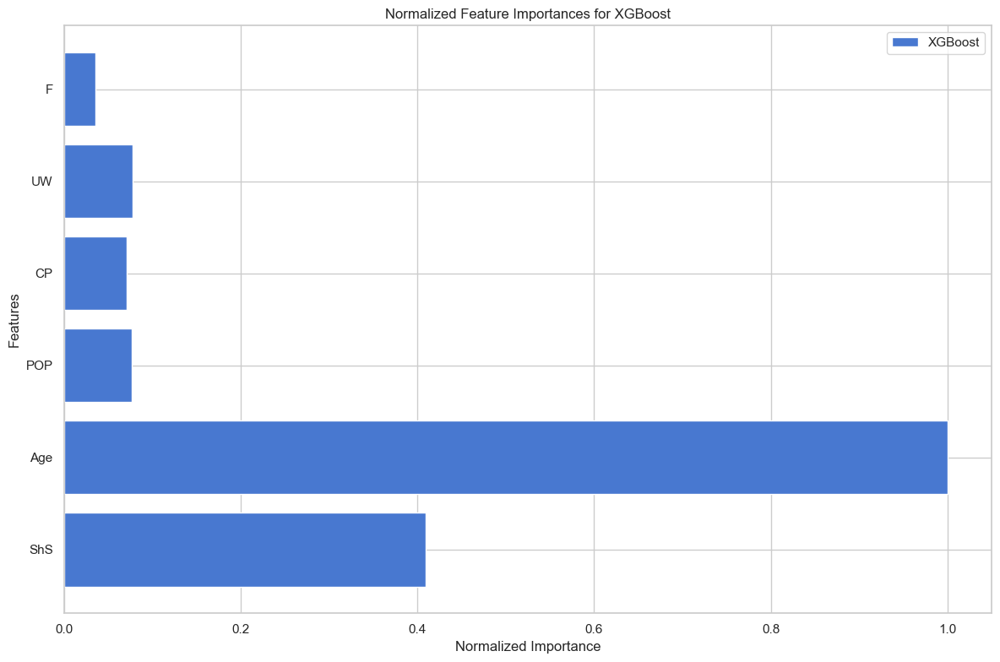

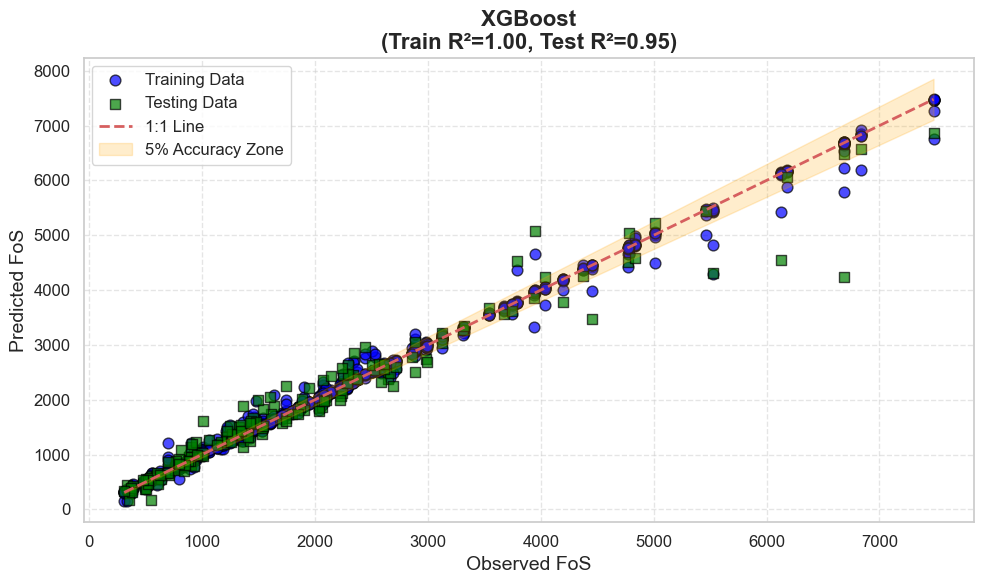

['trained_XGBoost_model.joblib']

In [18]:
import numpy as np
import pandas as pd
import joblib
from sklearn.model_selection import KFold, GridSearchCV
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
from xgboost import XGBRegressor
from sklearn.preprocessing import StandardScaler
import time
import matplotlib.pyplot as plt

# Define the XGBoost model
xgb_model = XGBRegressor(objective='reg:squarederror')

# Parameter tuning for XGBoost
param_grid = {
    'max_depth': [5, 5],
    'learning_rate': [0.01, 0.1],
    'n_estimators': [50, 200],
    'subsample': [0.6, 1.0],
    'colsample_bytree': [0.6, 1.0]
}
grid_search = GridSearchCV(xgb_model, param_grid, cv=5)
model = grid_search

# Feature names
#feature_names = ['$\\gamma$', 'c', '$\\phi$', '$\\beta$', 'H', '$r_u$']

# Initialize KFold
kfold = KFold(n_splits=8, random_state=42, shuffle=True)

# Prepare a dictionary to store the results
results = []
feature_importances_dict = {}

# Define the function to plot predicted vs observed values
def plot_predicted_vs_observed(y_train, y_train_pred, y_test, y_test_pred, train_r2, test_r2, ax):
    ax.scatter(y_train, y_train_pred, label='Training Data', color='blue', alpha=0.7, edgecolor='black', marker='o', s=60)
    ax.scatter(y_test, y_test_pred, label='Testing Data', color='green', alpha=0.7, edgecolor='black', marker='s', s=60)
    min_val = min(min(y_train), min(y_test))
    max_val = max(max(y_train), max(y_test))
    ax.plot([min_val, max_val], [min_val, max_val], 'r--', label='1:1 Line', linewidth=2)
    ax.fill_between([min_val, max_val], [min_val * 0.95, max_val * 0.95], [min_val * 1.05, max_val * 1.05], color='orange', alpha=0.2, label='5% Accuracy Zone')
    ax.set_title(f'XGBoost\n(Train R²={train_r2:.2f}, Test R²={test_r2:.2f})', fontsize=16, fontweight='bold')
    ax.set_xlabel('Observed FoS', fontsize=14)
    ax.set_ylabel('Predicted FoS', fontsize=14)
    ax.tick_params(axis='both', which='major', labelsize=12)
    ax.legend(loc='upper left', fontsize=12, frameon=True)
    ax.grid(True, linestyle='--', alpha=0.5)
    ax.set_aspect('auto')

# Loop over the model and perform cross-validation
print("Evaluating XGBoost model")
train_mae_list = []
test_mae_list = []
train_rmse_list = []
test_rmse_list = []
train_r2_list = []
test_r2_list = []

y_train_all = []
y_train_pred_all = []
y_test_all = []
y_test_pred_all = []

start_time = time.time()

for fold_idx, (train_index, test_index) in enumerate(kfold.split(X)):
    X_train, X_test = X[train_index], X[test_index]
    y_train, y_test = y[train_index], y[test_index]

    scaler = StandardScaler()
    X_train_scaled = scaler.fit_transform(X_train)
    X_test_scaled = scaler.transform(X_test)

    model.fit(X_train_scaled, y_train)

    y_train_pred = model.predict(X_train_scaled)
    y_test_pred = model.predict(X_test_scaled)

    y_train_all.extend(y_train)
    y_train_pred_all.extend(y_train_pred)
    y_test_all.extend(y_test)
    y_test_pred_all.extend(y_test_pred)

    train_mae_list.append(mean_absolute_error(y_train, y_train_pred))
    test_mae_list.append(mean_absolute_error(y_test, y_test_pred))
    train_rmse_list.append(np.sqrt(mean_squared_error(y_train, y_train_pred)))
    test_rmse_list.append(np.sqrt(mean_squared_error(y_test, y_test_pred)))
    train_r2_list.append(r2_score(y_train, y_train_pred))
    test_r2_list.append(r2_score(y_test, y_test_pred))

runtime = time.time() - start_time

# Compute mean and std of metrics
def compute_metrics(metrics_list):
    return {
        'mean': np.mean(metrics_list),
        'std': np.std(metrics_list)
    }

results.append({
    'Model': 'XGBoost',
    'Train MAE Mean': compute_metrics(train_mae_list)['mean'],
    'Train MAE Std': compute_metrics(train_mae_list)['std'],
    'Test MAE Mean': compute_metrics(test_mae_list)['mean'],
    'Test MAE Std': compute_metrics(test_mae_list)['std'],
    'Train RMSE Mean': compute_metrics(train_rmse_list)['mean'],
    'Train RMSE Std': compute_metrics(train_rmse_list)['std'],
    'Test RMSE Mean': compute_metrics(test_rmse_list)['mean'],
    'Test RMSE Std': compute_metrics(test_rmse_list)['std'],
    'Train R2 Mean': compute_metrics(train_r2_list)['mean'],
    'Train R2 Std': compute_metrics(train_r2_list)['std'],
    'Test R2 Mean': compute_metrics(test_r2_list)['mean'],
    'Test R2 Std': compute_metrics(test_r2_list)['std'],
    'Runtime (s)': runtime
})

# Collect feature importances
if hasattr(model.best_estimator_, 'feature_importances_'):
    normalized_importances = model.best_estimator_.feature_importances_ / np.max(model.best_estimator_.feature_importances_)
    feature_importances_dict['XGBoost'] = normalized_importances

# Save predictions for plotting
np.save('XGBoost_y_train.npy', np.array(y_train_all))
np.save('XGBoost_y_train_pred.npy', np.array(y_train_pred_all))
np.save('XGBoost_y_test.npy', np.array(y_test_all))
np.save('XGBoost_y_test_pred.npy', np.array(y_test_pred_all))

# Convert results into DataFrame
results_df = pd.DataFrame(results)

# Save to Excel
with pd.ExcelWriter('Regression_results.xlsx', engine='openpyxl', mode='a', if_sheet_exists='replace') as writer:
    results_df.to_excel(writer, sheet_name='XGBoost', index=False)

    if feature_importances_dict:
        feature_importances_df = pd.DataFrame(feature_importances_dict, index=feature_names)
        feature_importances_df.to_excel(writer, sheet_name='XGB Feature Importances')

# Plot normalized feature importances
plt.figure(figsize=(12, 8))
bar_width = 0.8
indices = np.arange(len(feature_names))

for i, (model_name, importances) in enumerate(feature_importances_dict.items()):
    plt.barh(indices + i * bar_width, importances, bar_width, label=model_name)

plt.yticks(indices + (len(feature_importances_dict) - 1) * bar_width / 2, feature_names)
plt.xlabel('Normalized Importance')
plt.ylabel('Features')
plt.title('Normalized Feature Importances for XGBoost')
plt.legend(loc='best')
plt.tight_layout()
plt.show()

# Prepare the subplot for plotting predicted vs observed
fig, ax = plt.subplots(figsize=(10, 6))

# Load the saved predictions and observed values
y_train = np.load('XGBoost_y_train.npy')
y_train_pred = np.load('XGBoost_y_train_pred.npy')
y_test = np.load('XGBoost_y_test.npy')
y_test_pred = np.load('XGBoost_y_test_pred.npy')

# Calculate R² scores
train_r2 = r2_score(y_train, y_train_pred)
test_r2 = r2_score(y_test, y_test_pred)

# Plot for the XGBoost model
plot_predicted_vs_observed(y_train, y_train_pred, y_test, y_test_pred, train_r2, test_r2, ax)

plt.tight_layout()
plt.show()

# Save the XGBoost model
joblib.dump(model.best_estimator_, 'trained_XGBoost_model.joblib')

2. AdaBoost

Evaluating AdaBoost model


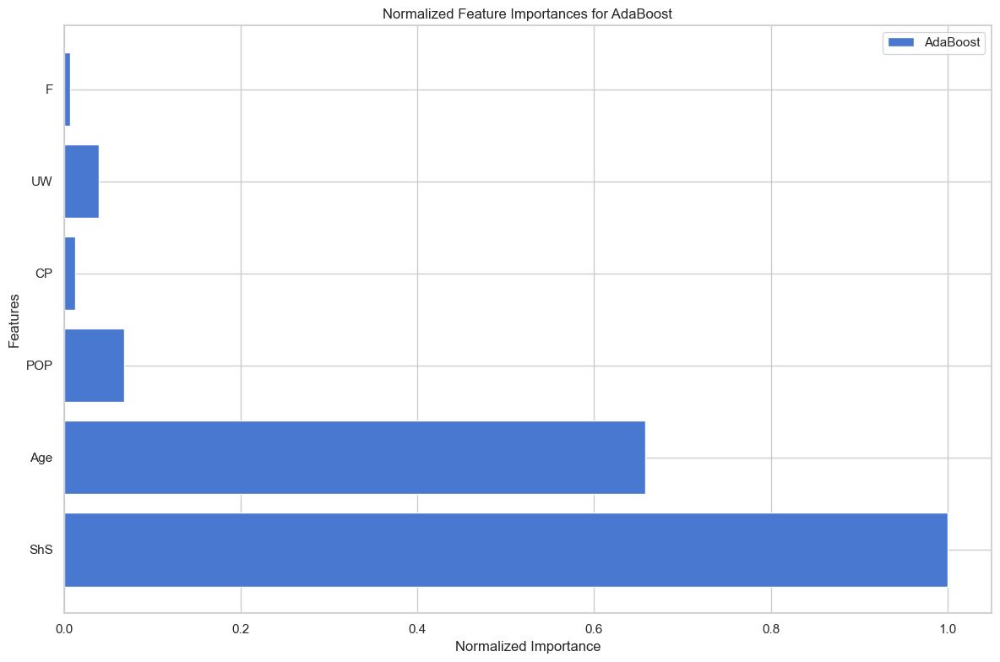

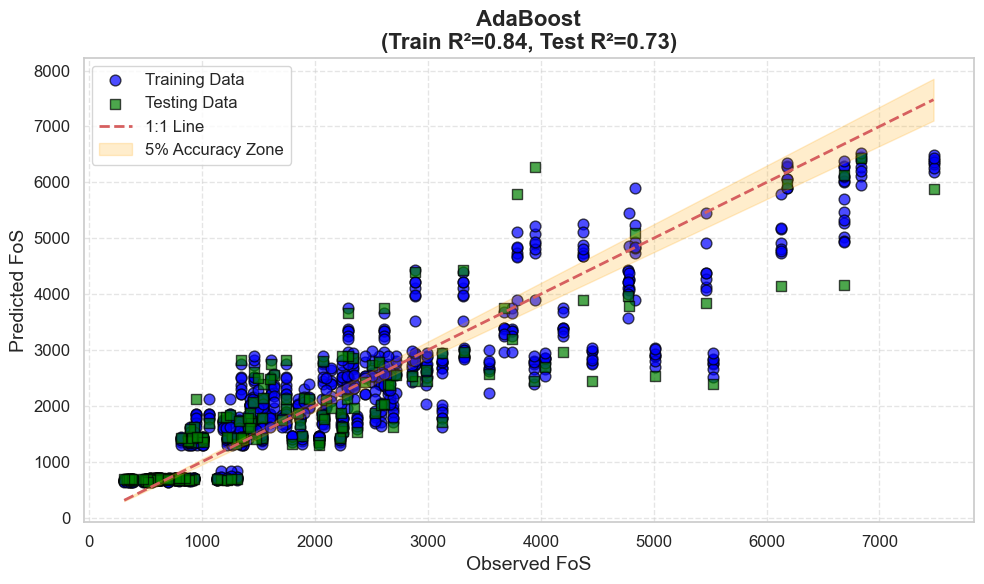

['trained_AdaBoost_model.joblib']

In [20]:
import numpy as np
import pandas as pd
import joblib
from sklearn.model_selection import KFold, GridSearchCV
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
from sklearn.ensemble import AdaBoostRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.preprocessing import StandardScaler
import time
import matplotlib.pyplot as plt

# Define the AdaBoost model with a default base estimator
ada_model = AdaBoostRegressor(n_estimators=100)  # Adjust n_estimators as needed

# Parameter tuning for AdaBoost
param_grid = {
    'n_estimators': [50, 100, 150],
    'learning_rate': [0.01, 0.1, 0.2]
}
grid_search = GridSearchCV(ada_model, param_grid, cv=5)
model = grid_search

# Feature names
#feature_names = ['$\\gamma$', 'c', '$\\phi$', '$\\beta$', 'H', '$r_u$']

# Initialize KFold
kfold = KFold(n_splits=8, random_state=42, shuffle=True)

# Prepare a dictionary to store the results
results = []
feature_importances_dict = {}

# Define the function to plot predicted vs observed values
def plot_predicted_vs_observed(y_train, y_train_pred, y_test, y_test_pred, train_r2, test_r2, ax):
    ax.scatter(y_train, y_train_pred, label='Training Data', color='blue', alpha=0.7, edgecolor='black', marker='o', s=60)
    ax.scatter(y_test, y_test_pred, label='Testing Data', color='green', alpha=0.7, edgecolor='black', marker='s', s=60)
    min_val = min(min(y_train), min(y_test))
    max_val = max(max(y_train), max(y_test))
    ax.plot([min_val, max_val], [min_val, max_val], 'r--', label='1:1 Line', linewidth=2)
    ax.fill_between([min_val, max_val], [min_val * 0.95, max_val * 0.95], [min_val * 1.05, max_val * 1.05], color='orange', alpha=0.2, label='5% Accuracy Zone')
    ax.set_title(f'AdaBoost\n(Train R²={train_r2:.2f}, Test R²={test_r2:.2f})', fontsize=16, fontweight='bold')
    ax.set_xlabel('Observed FoS', fontsize=14)
    ax.set_ylabel('Predicted FoS', fontsize=14)
    ax.tick_params(axis='both', which='major', labelsize=12)
    ax.legend(loc='upper left', fontsize=12, frameon=True)
    ax.grid(True, linestyle='--', alpha=0.5)
    ax.set_aspect('auto')

# Loop over the model and perform cross-validation
print("Evaluating AdaBoost model")
train_mae_list = []
test_mae_list = []
train_rmse_list = []
test_rmse_list = []
train_r2_list = []
test_r2_list = []

y_train_all = []
y_train_pred_all = []
y_test_all = []
y_test_pred_all = []

start_time = time.time()

for fold_idx, (train_index, test_index) in enumerate(kfold.split(X)):
    X_train, X_test = X[train_index], X[test_index]
    y_train, y_test = y[train_index], y[test_index]

    scaler = StandardScaler()
    X_train_scaled = scaler.fit_transform(X_train)
    X_test_scaled = scaler.transform(X_test)

    model.fit(X_train_scaled, y_train)

    y_train_pred = model.predict(X_train_scaled)
    y_test_pred = model.predict(X_test_scaled)

    y_train_all.extend(y_train)
    y_train_pred_all.extend(y_train_pred)
    y_test_all.extend(y_test)
    y_test_pred_all.extend(y_test_pred)

    train_mae_list.append(mean_absolute_error(y_train, y_train_pred))
    test_mae_list.append(mean_absolute_error(y_test, y_test_pred))
    train_rmse_list.append(np.sqrt(mean_squared_error(y_train, y_train_pred)))
    test_rmse_list.append(np.sqrt(mean_squared_error(y_test, y_test_pred)))
    train_r2_list.append(r2_score(y_train, y_train_pred))
    test_r2_list.append(r2_score(y_test, y_test_pred))

runtime = time.time() - start_time

# Compute mean and std of metrics
def compute_metrics(metrics_list):
    return {
        'mean': np.mean(metrics_list),
        'std': np.std(metrics_list)
    }

results.append({
    'Model': 'AdaBoost',
    'Train MAE Mean': compute_metrics(train_mae_list)['mean'],
    'Train MAE Std': compute_metrics(train_mae_list)['std'],
    'Test MAE Mean': compute_metrics(test_mae_list)['mean'],
    'Test MAE Std': compute_metrics(test_mae_list)['std'],
    'Train RMSE Mean': compute_metrics(train_rmse_list)['mean'],
    'Train RMSE Std': compute_metrics(train_rmse_list)['std'],
    'Test RMSE Mean': compute_metrics(test_rmse_list)['mean'],
    'Test RMSE Std': compute_metrics(test_rmse_list)['std'],
    'Train R2 Mean': compute_metrics(train_r2_list)['mean'],
    'Train R2 Std': compute_metrics(train_r2_list)['std'],
    'Test R2 Mean': compute_metrics(test_r2_list)['mean'],
    'Test R2 Std': compute_metrics(test_r2_list)['std'],
    'Runtime (s)': runtime
})

# Collect feature importances
if hasattr(model.best_estimator_, 'feature_importances_'):
    normalized_importances = model.best_estimator_.feature_importances_ / np.max(model.best_estimator_.feature_importances_)
    feature_importances_dict['AdaBoost'] = normalized_importances

# Save predictions for plotting
np.save('AdaBoost_y_train.npy', np.array(y_train_all))
np.save('AdaBoost_y_train_pred.npy', np.array(y_train_pred_all))
np.save('AdaBoost_y_test.npy', np.array(y_test_all))
np.save('AdaBoost_y_test_pred.npy', np.array(y_test_pred_all))

# Convert results into DataFrame
results_df = pd.DataFrame(results)

# Save to Excel
with pd.ExcelWriter('Regression_results.xlsx', engine='openpyxl', mode='a', if_sheet_exists='replace') as writer:
    results_df.to_excel(writer, sheet_name='AdaBoost', index=False)

    if feature_importances_dict:
        feature_importances_df = pd.DataFrame(feature_importances_dict, index=feature_names)
        feature_importances_df.to_excel(writer, sheet_name='AdaBoost Feature Importances')

# Plot normalized feature importances
plt.figure(figsize=(12, 8))
bar_width = 0.8
indices = np.arange(len(feature_names))

for i, (model_name, importances) in enumerate(feature_importances_dict.items()):
    plt.barh(indices + i * bar_width, importances, bar_width, label=model_name)

plt.yticks(indices + (len(feature_importances_dict) - 1) * bar_width / 2, feature_names)
plt.xlabel('Normalized Importance')
plt.ylabel('Features')
plt.title('Normalized Feature Importances for AdaBoost')
plt.legend(loc='best')
plt.tight_layout()
plt.show()

# Prepare the subplot for plotting predicted vs observed
fig, ax = plt.subplots(figsize=(10, 6))

# Load the saved predictions and observed values
y_train = np.load('AdaBoost_y_train.npy')
y_train_pred = np.load('AdaBoost_y_train_pred.npy')
y_test = np.load('AdaBoost_y_test.npy')
y_test_pred = np.load('AdaBoost_y_test_pred.npy')

# Calculate R² scores
train_r2 = r2_score(y_train, y_train_pred)
test_r2 = r2_score(y_test, y_test_pred)

# Plot for the AdaBoost model
plot_predicted_vs_observed(y_train, y_train_pred, y_test, y_test_pred, train_r2, test_r2, ax)

plt.tight_layout()
plt.show()

joblib.dump(model.best_estimator_, 'trained_AdaBoost_model.joblib')


3. Gradient Boosting

Evaluating Gradient Boosting model


c:\ProgramData\anaconda3\lib\site-packages\openpyxl\workbook\child.py:99: UserWarning:

Title is more than 31 characters. Some applications may not be able to read the file



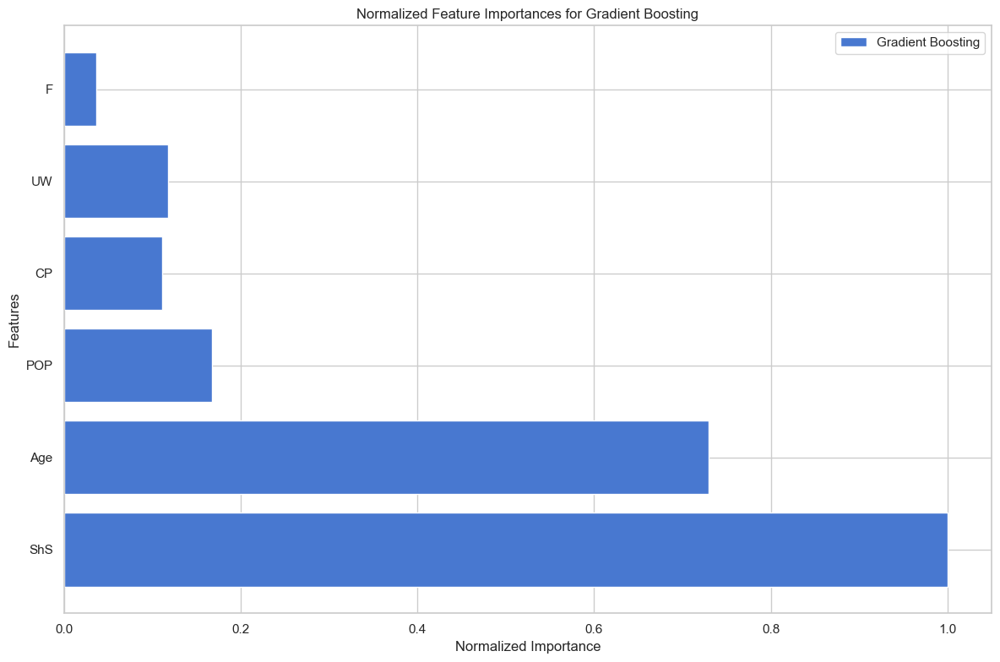

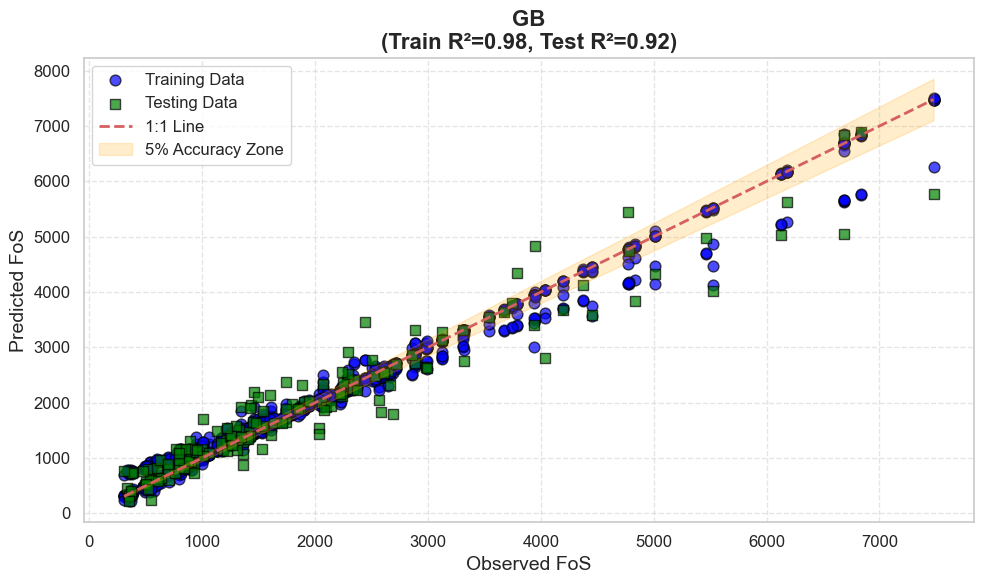

['trained_GB_model.joblib']

In [21]:
import numpy as np
import pandas as pd
import joblib
from sklearn.model_selection import KFold, GridSearchCV
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.preprocessing import StandardScaler
import time
import matplotlib.pyplot as plt

# Define the Gradient Boosting model
gb_model = GradientBoostingRegressor()

# Parameter tuning for Gradient Boosting
param_grid = {
    'n_estimators': [50, 150],
    'learning_rate': [0.01,0.2],
    'max_depth': [3, 7],
    'min_samples_split': [2, 10]
}
grid_search = GridSearchCV(gb_model, param_grid, cv=5)
model = grid_search

# Feature names
#feature_names = ['$\\gamma$', 'c', '$\\phi$', '$\\beta$', 'H', '$r_u$']

# Initialize KFold
kfold = KFold(n_splits=8, random_state=42, shuffle=True)

# Prepare a dictionary to store the results
results = []
feature_importances_dict = {}

# Define the function to plot predicted vs observed values
def plot_predicted_vs_observed(y_train, y_train_pred, y_test, y_test_pred, train_r2, test_r2, ax):
    ax.scatter(y_train, y_train_pred, label='Training Data', color='blue', alpha=0.7, edgecolor='black', marker='o', s=60)
    ax.scatter(y_test, y_test_pred, label='Testing Data', color='green', alpha=0.7, edgecolor='black', marker='s', s=60)
    min_val = min(min(y_train), min(y_test))
    max_val = max(max(y_train), max(y_test))
    ax.plot([min_val, max_val], [min_val, max_val], 'r--', label='1:1 Line', linewidth=2)
    ax.fill_between([min_val, max_val], [min_val * 0.95, max_val * 0.95], [min_val * 1.05, max_val * 1.05], color='orange', alpha=0.2, label='5% Accuracy Zone')
    ax.set_title(f'GB\n(Train R²={train_r2:.2f}, Test R²={test_r2:.2f})', fontsize=16, fontweight='bold')
    ax.set_xlabel('Observed FoS', fontsize=14)
    ax.set_ylabel('Predicted FoS', fontsize=14)
    ax.tick_params(axis='both', which='major', labelsize=12)
    ax.legend(loc='upper left', fontsize=12, frameon=True)
    ax.grid(True, linestyle='--', alpha=0.5)
    ax.set_aspect('auto')

# Loop over the model and perform cross-validation
print("Evaluating Gradient Boosting model")
train_mae_list = []
test_mae_list = []
train_rmse_list = []
test_rmse_list = []
train_r2_list = []
test_r2_list = []

y_train_all = []
y_train_pred_all = []
y_test_all = []
y_test_pred_all = []

start_time = time.time()

for fold_idx, (train_index, test_index) in enumerate(kfold.split(X)):
    X_train, X_test = X[train_index], X[test_index]
    y_train, y_test = y[train_index], y[test_index]

    scaler = StandardScaler()
    X_train_scaled = scaler.fit_transform(X_train)
    X_test_scaled = scaler.transform(X_test)

    model.fit(X_train_scaled, y_train)

    y_train_pred = model.predict(X_train_scaled)
    y_test_pred = model.predict(X_test_scaled)

    y_train_all.extend(y_train)
    y_train_pred_all.extend(y_train_pred)
    y_test_all.extend(y_test)
    y_test_pred_all.extend(y_test_pred)

    train_mae_list.append(mean_absolute_error(y_train, y_train_pred))
    test_mae_list.append(mean_absolute_error(y_test, y_test_pred))
    train_rmse_list.append(np.sqrt(mean_squared_error(y_train, y_train_pred)))
    test_rmse_list.append(np.sqrt(mean_squared_error(y_test, y_test_pred)))
    train_r2_list.append(r2_score(y_train, y_train_pred))
    test_r2_list.append(r2_score(y_test, y_test_pred))

runtime = time.time() - start_time

# Compute mean and std of metrics
def compute_metrics(metrics_list):
    return {
        'mean': np.mean(metrics_list),
        'std': np.std(metrics_list)
    }

results.append({
    'Model': 'GB',
    'Train MAE Mean': compute_metrics(train_mae_list)['mean'],
    'Train MAE Std': compute_metrics(train_mae_list)['std'],
    'Test MAE Mean': compute_metrics(test_mae_list)['mean'],
    'Test MAE Std': compute_metrics(test_mae_list)['std'],
    'Train RMSE Mean': compute_metrics(train_rmse_list)['mean'],
    'Train RMSE Std': compute_metrics(train_rmse_list)['std'],
    'Test RMSE Mean': compute_metrics(test_rmse_list)['mean'],
    'Test RMSE Std': compute_metrics(test_rmse_list)['std'],
    'Train R2 Mean': compute_metrics(train_r2_list)['mean'],
    'Train R2 Std': compute_metrics(train_r2_list)['std'],
    'Test R2 Mean': compute_metrics(test_r2_list)['mean'],
    'Test R2 Std': compute_metrics(test_r2_list)['std'],
    'Runtime (s)': runtime
})

# Collect feature importances
if hasattr(model.best_estimator_, 'feature_importances_'):
    normalized_importances = model.best_estimator_.feature_importances_ / np.max(model.best_estimator_.feature_importances_)
    feature_importances_dict['Gradient Boosting'] = normalized_importances

# Save predictions for plotting
np.save('GB_y_train.npy', np.array(y_train_all))
np.save('GB_y_train_pred.npy', np.array(y_train_pred_all))
np.save('GB_y_test.npy', np.array(y_test_all))
np.save('GB_y_test_pred.npy', np.array(y_test_pred_all))

# Convert results into DataFrame
results_df = pd.DataFrame(results)

# Save to Excel
with pd.ExcelWriter('Regression_results.xlsx', engine='openpyxl', mode='a', if_sheet_exists='replace') as writer:
    results_df.to_excel(writer, sheet_name='Gradient Boosting', index=False)

    if feature_importances_dict:
        feature_importances_df = pd.DataFrame(feature_importances_dict, index=feature_names)
        feature_importances_df.to_excel(writer, sheet_name='Gradient Boosting Feature Importances')

# Plot normalized feature importances
plt.figure(figsize=(12, 8))
bar_width = 0.8
indices = np.arange(len(feature_names))

for i, (model_name, importances) in enumerate(feature_importances_dict.items()):
    plt.barh(indices + i * bar_width, importances, bar_width, label=model_name)

plt.yticks(indices + (len(feature_importances_dict) - 1) * bar_width / 2, feature_names)
plt.xlabel('Normalized Importance')
plt.ylabel('Features')
plt.title('Normalized Feature Importances for Gradient Boosting')
plt.legend(loc='best')
plt.tight_layout()
plt.show()

# Prepare the subplot for plotting predicted vs observed
fig, ax = plt.subplots(figsize=(10, 6))

# Load the saved predictions and observed values
y_train = np.load('GB_y_train.npy')
y_train_pred = np.load('GB_y_train_pred.npy')
y_test = np.load('GB_y_test.npy')
y_test_pred = np.load('GB_y_test_pred.npy')

# Calculate R² scores
train_r2 = r2_score(y_train, y_train_pred)
test_r2 = r2_score(y_test, y_test_pred)

# Plot for the Gradient Boosting model
plot_predicted_vs_observed(y_train, y_train_pred, y_test, y_test_pred, train_r2, test_r2, ax)

plt.tight_layout()
plt.show()

joblib.dump(model.best_estimator_, 'trained_GB_model.joblib')


4. Hist Gradient Boosting

Evaluating Hist Gradient Boosting model


c:\ProgramData\anaconda3\lib\site-packages\openpyxl\workbook\child.py:99: UserWarning:

Title is more than 31 characters. Some applications may not be able to read the file



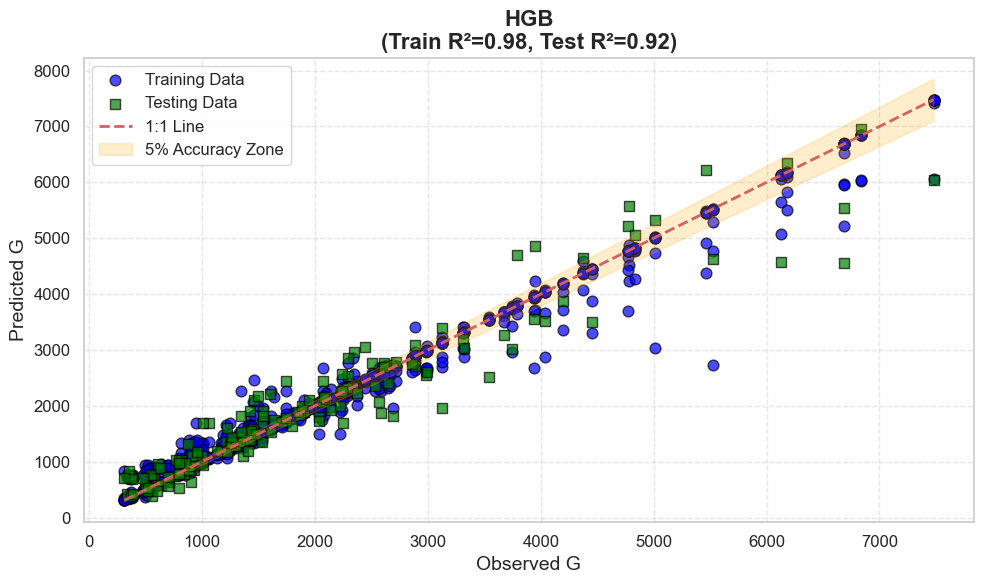

['trained_HGB_model.joblib']

In [22]:
import numpy as np
import pandas as pd
import joblib
from sklearn.model_selection import KFold, GridSearchCV
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
from sklearn.ensemble import HistGradientBoostingRegressor
from sklearn.preprocessing import StandardScaler
import time
import matplotlib.pyplot as plt

# Define the HistGradientBoosting model
hgb_model = HistGradientBoostingRegressor()

# Parameter tuning for HistGradientBoosting
param_grid = {
    'max_iter': [100, 200],
    'learning_rate': [0.01, 0.1],
    'max_depth': [3, 7],
    'min_samples_leaf': [1, 5]
}
grid_search = GridSearchCV(hgb_model, param_grid, cv=5)
model = grid_search

# Feature names
#feature_names = ['$\\gamma$', 'c', '$\\phi$', '$\\beta$', 'H', '$r_u$']

# Initialize KFold
kfold = KFold(n_splits=8, random_state=42, shuffle=True)

# Prepare a dictionary to store the results
results = []

# Define the function to plot predicted vs observed values
def plot_predicted_vs_observed(y_train, y_train_pred, y_test, y_test_pred, train_r2, test_r2, ax):
    ax.scatter(y_train, y_train_pred, label='Training Data', color='blue', alpha=0.7, edgecolor='black', marker='o', s=60)
    ax.scatter(y_test, y_test_pred, label='Testing Data', color='green', alpha=0.7, edgecolor='black', marker='s', s=60)
    min_val = min(min(y_train), min(y_test))
    max_val = max(max(y_train), max(y_test))
    ax.plot([min_val, max_val], [min_val, max_val], 'r--', label='1:1 Line', linewidth=2)
    ax.fill_between([min_val, max_val], [min_val * 0.95, max_val * 0.95], [min_val * 1.05, max_val * 1.05], color='orange', alpha=0.2, label='5% Accuracy Zone')
    ax.set_title(f'HGB\n(Train R²={train_r2:.2f}, Test R²={test_r2:.2f})', fontsize=16, fontweight='bold')
    ax.set_xlabel('Observed G', fontsize=14)
    ax.set_ylabel('Predicted G', fontsize=14)
    ax.tick_params(axis='both', which='major', labelsize=12)
    ax.legend(loc='upper left', fontsize=12, frameon=True)
    ax.grid(True, linestyle='--', alpha=0.5)
    ax.set_aspect('auto')

# Loop over the model and perform cross-validation
print("Evaluating Hist Gradient Boosting model")
train_mae_list = []
test_mae_list = []
train_rmse_list = []
test_rmse_list = []
train_r2_list = []
test_r2_list = []

y_train_all = []
y_train_pred_all = []
y_test_all = []
y_test_pred_all = []

start_time = time.time()

for fold_idx, (train_index, test_index) in enumerate(kfold.split(X)):
    X_train, X_test = X[train_index], X[test_index]
    y_train, y_test = y[train_index], y[test_index]

    scaler = StandardScaler()
    X_train_scaled = scaler.fit_transform(X_train)
    X_test_scaled = scaler.transform(X_test)

    model.fit(X_train_scaled, y_train)

    y_train_pred = model.predict(X_train_scaled)
    y_test_pred = model.predict(X_test_scaled)

    y_train_all.extend(y_train)
    y_train_pred_all.extend(y_train_pred)
    y_test_all.extend(y_test)
    y_test_pred_all.extend(y_test_pred)

    train_mae_list.append(mean_absolute_error(y_train, y_train_pred))
    test_mae_list.append(mean_absolute_error(y_test, y_test_pred))
    train_rmse_list.append(np.sqrt(mean_squared_error(y_train, y_train_pred)))
    test_rmse_list.append(np.sqrt(mean_squared_error(y_test, y_test_pred)))
    train_r2_list.append(r2_score(y_train, y_train_pred))
    test_r2_list.append(r2_score(y_test, y_test_pred))

runtime = time.time() - start_time

# Compute mean and std of metrics
def compute_metrics(metrics_list):
    return {
        'mean': np.mean(metrics_list),
        'std': np.std(metrics_list)
    }

results.append({
    'Model': 'HGB',
    'Train MAE Mean': compute_metrics(train_mae_list)['mean'],
    'Train MAE Std': compute_metrics(train_mae_list)['std'],
    'Test MAE Mean': compute_metrics(test_mae_list)['mean'],
    'Test MAE Std': compute_metrics(test_mae_list)['std'],
    'Train RMSE Mean': compute_metrics(train_rmse_list)['mean'],
    'Train RMSE Std': compute_metrics(train_rmse_list)['std'],
    'Test RMSE Mean': compute_metrics(test_rmse_list)['mean'],
    'Test RMSE Std': compute_metrics(test_rmse_list)['std'],
    'Train R2 Mean': compute_metrics(train_r2_list)['mean'],
    'Train R2 Std': compute_metrics(train_r2_list)['std'],
    'Test R2 Mean': compute_metrics(test_r2_list)['mean'],
    'Test R2 Std': compute_metrics(test_r2_list)['std'],
    'Runtime (s)': runtime
})

# Save predictions for plotting
np.save('HGB_y_train.npy', np.array(y_train_all))
np.save('HGB_y_train_pred.npy', np.array(y_train_pred_all))
np.save('HGB_y_test.npy', np.array(y_test_all))
np.save('HGB_y_test_pred.npy', np.array(y_test_pred_all))

# Convert results into DataFrame
results_df = pd.DataFrame(results)

# Save to Excel
with pd.ExcelWriter('Regression_results.xlsx', engine='openpyxl', mode='a', if_sheet_exists='replace') as writer:
    results_df.to_excel(writer, sheet_name='Hist Gradient Boosting', index=False)

# Prepare the subplot for plotting predicted vs observed
fig, ax = plt.subplots(figsize=(10, 6))

# Load the saved predictions and observed values
y_train = np.load('HGB_y_train.npy')
y_train_pred = np.load('HGB_y_train_pred.npy')
y_test = np.load('HGB_y_test.npy')
y_test_pred = np.load('HGB_y_test_pred.npy')

# Calculate R² scores
train_r2 = r2_score(y_train, y_train_pred)
test_r2 = r2_score(y_test, y_test_pred)

# Plot for the Hist Gradient Boosting model
plot_predicted_vs_observed(y_train, y_train_pred, y_test, y_test_pred, train_r2, test_r2, ax)

plt.tight_layout()
plt.show()

joblib.dump(model.best_estimator_, 'trained_HGB_model.joblib')


5. LightGBM

Evaluating LGBM model
[LightGBM] [Warning] min_data_in_leaf is set=20, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=20
[LightGBM] [Warning] min_data_in_leaf is set=20, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=20
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000757 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 24
[LightGBM] [Info] Number of data points in the train set: 106, number of used features: 5
[LightGBM] [Info] Start training from score 2208.178630
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No furthe

c:\ProgramData\anaconda3\lib\site-packages\openpyxl\workbook\child.py:99: UserWarning:

Title is more than 31 characters. Some applications may not be able to read the file



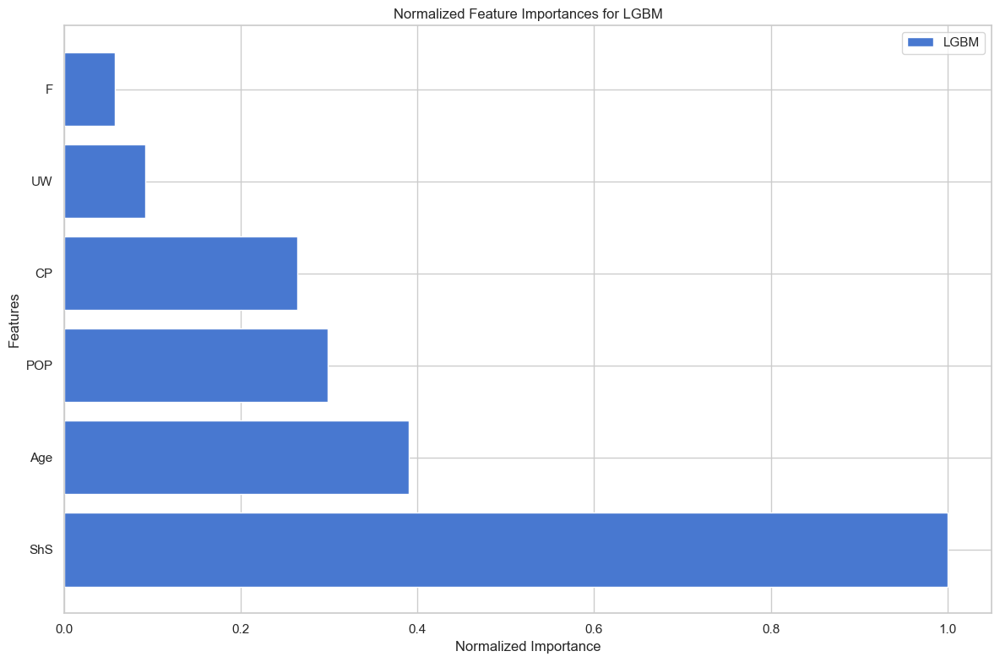

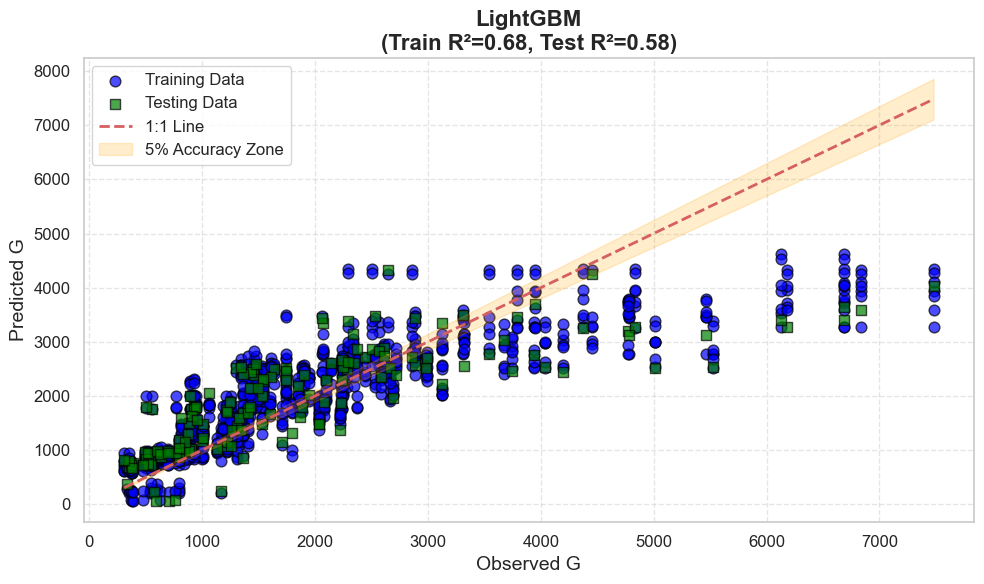

['trained_LightGBM_model.joblib']

In [23]:
import numpy as np
import pandas as pd
import joblib
from sklearn.model_selection import KFold, GridSearchCV
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
from lightgbm import LGBMRegressor
from sklearn.preprocessing import StandardScaler
import time
import matplotlib.pyplot as plt

# Define the LGBM model
lgb_model = LGBMRegressor()

# Parameter tuning for LGBM
param_grid = {
    'n_estimators': [100, 200],
    'learning_rate': [0.01, 0.1],
    'max_depth': [-1, 3],
    'num_leaves': [31, 63],
    'min_data_in_leaf': [20, 40]
}
grid_search = GridSearchCV(lgb_model, param_grid, cv=5)
model = grid_search

# Feature names
#feature_names = ['$\\gamma$', 'c', '$\\phi$', '$\\beta$', 'H', '$r_u$']

# Initialize KFold
kfold = KFold(n_splits=8, random_state=42, shuffle=True)

# Prepare a dictionary to store the results
results = []
feature_importances_dict = {}

# Define the function to plot predicted vs observed values
def plot_predicted_vs_observed(y_train, y_train_pred, y_test, y_test_pred, train_r2, test_r2, ax):
    ax.scatter(y_train, y_train_pred, label='Training Data', color='blue', alpha=0.7, edgecolor='black', marker='o', s=60)
    ax.scatter(y_test, y_test_pred, label='Testing Data', color='green', alpha=0.7, edgecolor='black', marker='s', s=60)
    min_val = min(min(y_train), min(y_test))
    max_val = max(max(y_train), max(y_test))
    ax.plot([min_val, max_val], [min_val, max_val], 'r--', label='1:1 Line', linewidth=2)
    ax.fill_between([min_val, max_val], [min_val * 0.95, max_val * 0.95], [min_val * 1.05, max_val * 1.05], color='orange', alpha=0.2, label='5% Accuracy Zone')
    ax.set_title(f'LightGBM\n(Train R²={train_r2:.2f}, Test R²={test_r2:.2f})', fontsize=16, fontweight='bold')
    ax.set_xlabel('Observed G', fontsize=14)
    ax.set_ylabel('Predicted G', fontsize=14)
    ax.tick_params(axis='both', which='major', labelsize=12)
    ax.legend(loc='upper left', fontsize=12, frameon=True)
    ax.grid(True, linestyle='--', alpha=0.5)
    ax.set_aspect('auto')

# Loop over the model and perform cross-validation
print("Evaluating LGBM model")
train_mae_list = []
test_mae_list = []
train_rmse_list = []
test_rmse_list = []
train_r2_list = []
test_r2_list = []

y_train_all = []
y_train_pred_all = []
y_test_all = []
y_test_pred_all = []

start_time = time.time()

for fold_idx, (train_index, test_index) in enumerate(kfold.split(X)):
    X_train, X_test = X[train_index], X[test_index]
    y_train, y_test = y[train_index], y[test_index]

    scaler = StandardScaler()
    X_train_scaled = scaler.fit_transform(X_train)
    X_test_scaled = scaler.transform(X_test)

    model.fit(X_train_scaled, y_train)

    y_train_pred = model.predict(X_train_scaled)
    y_test_pred = model.predict(X_test_scaled)

    y_train_all.extend(y_train)
    y_train_pred_all.extend(y_train_pred)
    y_test_all.extend(y_test)
    y_test_pred_all.extend(y_test_pred)

    train_mae_list.append(mean_absolute_error(y_train, y_train_pred))
    test_mae_list.append(mean_absolute_error(y_test, y_test_pred))
    train_rmse_list.append(np.sqrt(mean_squared_error(y_train, y_train_pred)))
    test_rmse_list.append(np.sqrt(mean_squared_error(y_test, y_test_pred)))
    train_r2_list.append(r2_score(y_train, y_train_pred))
    test_r2_list.append(r2_score(y_test, y_test_pred))

runtime = time.time() - start_time

# Compute mean and std of metrics
def compute_metrics(metrics_list):
    return {
        'mean': np.mean(metrics_list),
        'std': np.std(metrics_list)
    }

results.append({
    'Model': 'LightGBM',
    'Train MAE Mean': compute_metrics(train_mae_list)['mean'],
    'Train MAE Std': compute_metrics(train_mae_list)['std'],
    'Test MAE Mean': compute_metrics(test_mae_list)['mean'],
    'Test MAE Std': compute_metrics(test_mae_list)['std'],
    'Train RMSE Mean': compute_metrics(train_rmse_list)['mean'],
    'Train RMSE Std': compute_metrics(train_rmse_list)['std'],
    'Test RMSE Mean': compute_metrics(test_rmse_list)['mean'],
    'Test RMSE Std': compute_metrics(test_rmse_list)['std'],
    'Train R2 Mean': compute_metrics(train_r2_list)['mean'],
    'Train R2 Std': compute_metrics(train_r2_list)['std'],
    'Test R2 Mean': compute_metrics(test_r2_list)['mean'],
    'Test R2 Std': compute_metrics(test_r2_list)['std'],
    'Runtime (s)': runtime
})

# Collect feature importances
if hasattr(model.best_estimator_, 'feature_importances_'):
    normalized_importances = model.best_estimator_.feature_importances_ / np.max(model.best_estimator_.feature_importances_)
    feature_importances_dict['LGBM'] = normalized_importances

# Save predictions for plotting
np.save('LightGBM_y_train.npy', np.array(y_train_all))
np.save('LightGBM_y_train_pred.npy', np.array(y_train_pred_all))
np.save('LightGBM_y_test.npy', np.array(y_test_all))
np.save('LightGBM_y_test_pred.npy', np.array(y_test_pred_all))

# Convert results into DataFrame
results_df = pd.DataFrame(results)

# Save to Excel
with pd.ExcelWriter('Regression_results.xlsx', engine='openpyxl', mode='a', if_sheet_exists='replace') as writer:
    results_df.to_excel(writer, sheet_name='LGBM', index=False)

    if feature_importances_dict:
        feature_importances_df = pd.DataFrame(feature_importances_dict, index=feature_names)
        feature_importances_df.to_excel(writer, sheet_name='LGBM Feature Importances')

# Plot normalized feature importances
plt.figure(figsize=(12, 8))
bar_width = 0.8
indices = np.arange(len(feature_names))

for i, (model_name, importances) in enumerate(feature_importances_dict.items()):
    plt.barh(indices + i * bar_width, importances, bar_width, label=model_name)

plt.yticks(indices + (len(feature_importances_dict) - 1) * bar_width / 2, feature_names)
plt.xlabel('Normalized Importance')
plt.ylabel('Features')
plt.title('Normalized Feature Importances for LGBM')
plt.legend(loc='best')
plt.tight_layout()
plt.show()

# Prepare the subplot for plotting predicted vs observed
fig, ax = plt.subplots(figsize=(10, 6))

# Load the saved predictions and observed values
y_train = np.load('LightGBM_y_train.npy')
y_train_pred = np.load('LightGBM_y_train_pred.npy')
y_test = np.load('LightGBM_y_test.npy')
y_test_pred = np.load('LightGBM_y_test_pred.npy')

# Calculate R² scores
train_r2 = r2_score(y_train, y_train_pred)
test_r2 = r2_score(y_test, y_test_pred)

# Plot for the LGBM model
plot_predicted_vs_observed(y_train, y_train_pred, y_test, y_test_pred, train_r2, test_r2, ax)

plt.tight_layout()
plt.show()

joblib.dump(model.best_estimator_, 'trained_LightGBM_model.joblib')

6. CatBoost

Evaluating CatBoost model


c:\ProgramData\anaconda3\lib\site-packages\openpyxl\workbook\child.py:99: UserWarning:

Title is more than 31 characters. Some applications may not be able to read the file



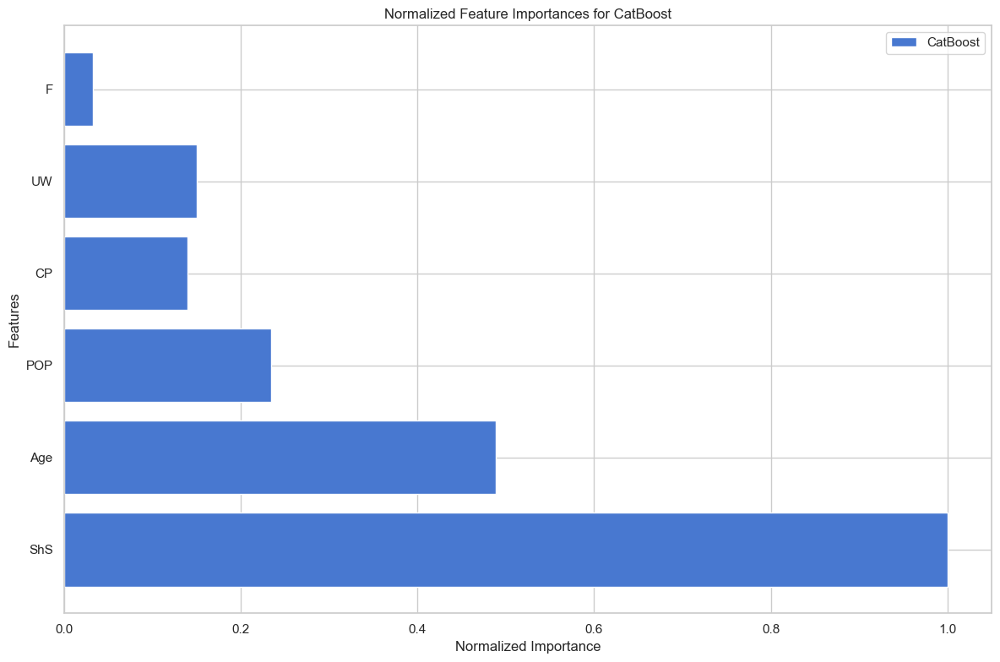

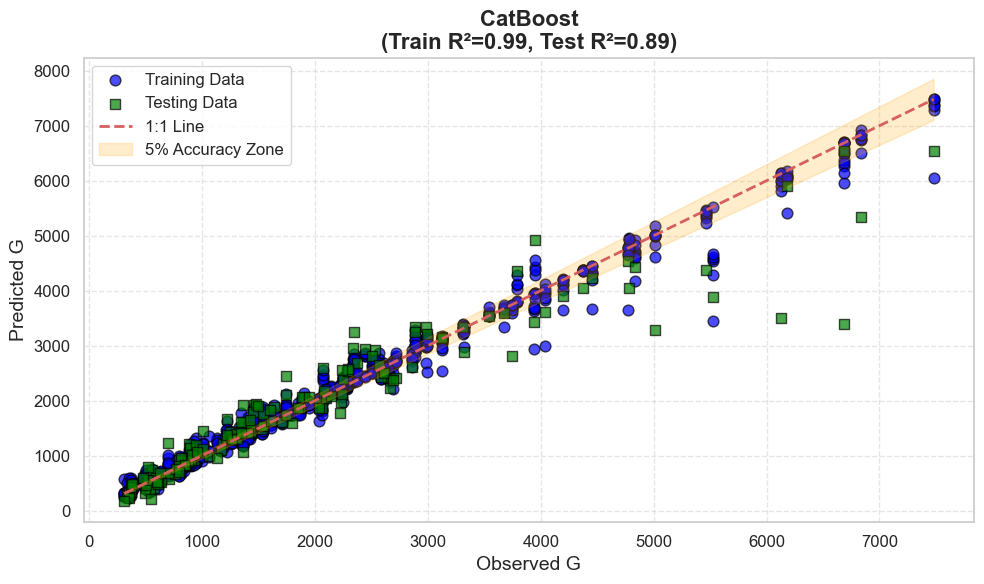

['trained_CatBoost_model.joblib']

In [24]:
import numpy as np
import pandas as pd
import joblib
from sklearn.model_selection import KFold, GridSearchCV
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
from catboost import CatBoostRegressor
from sklearn.preprocessing import StandardScaler
import time
import matplotlib.pyplot as plt

# Define the CatBoost model
cat_model = CatBoostRegressor(silent=True)

# Parameter tuning for CatBoost
param_grid = {
    'iterations': [300, 400],
    'learning_rate': [0.01, 0.1],
    'depth': [3, 9],
    'l2_leaf_reg': [3, 9]
}
grid_search = GridSearchCV(cat_model, param_grid, cv=5)
model = grid_search

# Feature names
#feature_names = ['$\\gamma$', 'c', '$\\phi$', '$\\beta$', 'H', '$r_u$']

# Initialize KFold
kfold = KFold(n_splits=8, random_state=42, shuffle=True)

# Prepare a dictionary to store the results
results = []
feature_importances_dict = {}

# Define the function to plot predicted vs observed values
def plot_predicted_vs_observed(y_train, y_train_pred, y_test, y_test_pred, train_r2, test_r2, ax):
    ax.scatter(y_train, y_train_pred, label='Training Data', color='blue', alpha=0.7, edgecolor='black', marker='o', s=60)
    ax.scatter(y_test, y_test_pred, label='Testing Data', color='green', alpha=0.7, edgecolor='black', marker='s', s=60)
    min_val = min(min(y_train), min(y_test))
    max_val = max(max(y_train), max(y_test))
    ax.plot([min_val, max_val], [min_val, max_val], 'r--', label='1:1 Line', linewidth=2)
    ax.fill_between([min_val, max_val], [min_val * 0.95, max_val * 0.95], [min_val * 1.05, max_val * 1.05], color='orange', alpha=0.2, label='5% Accuracy Zone')
    ax.set_title(f'CatBoost\n(Train R²={train_r2:.2f}, Test R²={test_r2:.2f})', fontsize=16, fontweight='bold')
    ax.set_xlabel('Observed G', fontsize=14)
    ax.set_ylabel('Predicted G', fontsize=14)
    ax.tick_params(axis='both', which='major', labelsize=12)
    ax.legend(loc='upper left', fontsize=12, frameon=True)
    ax.grid(True, linestyle='--', alpha=0.5)
    ax.set_aspect('auto')

# Loop over the model and perform cross-validation
print("Evaluating CatBoost model")
train_mae_list = []
test_mae_list = []
train_rmse_list = []
test_rmse_list = []
train_r2_list = []
test_r2_list = []

y_train_all = []
y_train_pred_all = []
y_test_all = []
y_test_pred_all = []

start_time = time.time()

for fold_idx, (train_index, test_index) in enumerate(kfold.split(X)):
    X_train, X_test = X[train_index], X[test_index]
    y_train, y_test = y[train_index], y[test_index]

    scaler = StandardScaler()
    X_train_scaled = scaler.fit_transform(X_train)
    X_test_scaled = scaler.transform(X_test)

    model.fit(X_train_scaled, y_train)

    y_train_pred = model.predict(X_train_scaled)
    y_test_pred = model.predict(X_test_scaled)

    y_train_all.extend(y_train)
    y_train_pred_all.extend(y_train_pred)
    y_test_all.extend(y_test)
    y_test_pred_all.extend(y_test_pred)

    train_mae_list.append(mean_absolute_error(y_train, y_train_pred))
    test_mae_list.append(mean_absolute_error(y_test, y_test_pred))
    train_rmse_list.append(np.sqrt(mean_squared_error(y_train, y_train_pred)))
    test_rmse_list.append(np.sqrt(mean_squared_error(y_test, y_test_pred)))
    train_r2_list.append(r2_score(y_train, y_train_pred))
    test_r2_list.append(r2_score(y_test, y_test_pred))

runtime = time.time() - start_time

# Compute mean and std of metrics
def compute_metrics(metrics_list):
    return {
        'mean': np.mean(metrics_list),
        'std': np.std(metrics_list)
    }

results.append({
    'Model': 'CatBoost',
    'Train MAE Mean': compute_metrics(train_mae_list)['mean'],
    'Train MAE Std': compute_metrics(train_mae_list)['std'],
    'Test MAE Mean': compute_metrics(test_mae_list)['mean'],
    'Test MAE Std': compute_metrics(test_mae_list)['std'],
    'Train RMSE Mean': compute_metrics(train_rmse_list)['mean'],
    'Train RMSE Std': compute_metrics(train_rmse_list)['std'],
    'Test RMSE Mean': compute_metrics(test_rmse_list)['mean'],
    'Test RMSE Std': compute_metrics(test_rmse_list)['std'],
    'Train R2 Mean': compute_metrics(train_r2_list)['mean'],
    'Train R2 Std': compute_metrics(train_r2_list)['std'],
    'Test R2 Mean': compute_metrics(test_r2_list)['mean'],
    'Test R2 Std': compute_metrics(test_r2_list)['std'],
    'Runtime (s)': runtime
})

# Collect feature importances
if hasattr(model.best_estimator_, 'feature_importances_'):
    normalized_importances = model.best_estimator_.feature_importances_ / np.max(model.best_estimator_.feature_importances_)
    feature_importances_dict['CatBoost'] = normalized_importances

# Save predictions for plotting
np.save('CatBoost_y_train.npy', np.array(y_train_all))
np.save('CatBoost_y_train_pred.npy', np.array(y_train_pred_all))
np.save('CatBoost_y_test.npy', np.array(y_test_all))
np.save('CatBoost_y_test_pred.npy', np.array(y_test_pred_all))

# Convert results into DataFrame
results_df = pd.DataFrame(results)

# Save to Excel
with pd.ExcelWriter('Regression_results.xlsx', engine='openpyxl', mode='a', if_sheet_exists='replace') as writer:
    results_df.to_excel(writer, sheet_name='CatBoost', index=False)

    if feature_importances_dict:
        feature_importances_df = pd.DataFrame(feature_importances_dict, index=feature_names)
        feature_importances_df.to_excel(writer, sheet_name='CatBoost Feature Importances')

# Plot normalized feature importances
plt.figure(figsize=(12, 8))
bar_width = 0.8
indices = np.arange(len(feature_names))

for i, (model_name, importances) in enumerate(feature_importances_dict.items()):
    plt.barh(indices + i * bar_width, importances, bar_width, label=model_name)

plt.yticks(indices + (len(feature_importances_dict) - 1) * bar_width / 2, feature_names)
plt.xlabel('Normalized Importance')
plt.ylabel('Features')
plt.title('Normalized Feature Importances for CatBoost')
plt.legend(loc='best')
plt.tight_layout()
plt.show()

# Prepare the subplot for plotting predicted vs observed
fig, ax = plt.subplots(figsize=(10, 6))

# Load the saved predictions and observed values
y_train = np.load('CatBoost_y_train.npy')
y_train_pred = np.load('CatBoost_y_train_pred.npy')
y_test = np.load('CatBoost_y_test.npy')
y_test_pred = np.load('CatBoost_y_test_pred.npy')

# Calculate R² scores
train_r2 = r2_score(y_train, y_train_pred)
test_r2 = r2_score(y_test, y_test_pred)

# Plot for the CatBoost model
plot_predicted_vs_observed(y_train, y_train_pred, y_test, y_test_pred, train_r2, test_r2, ax)

plt.tight_layout()
plt.show()

# Save the CatBoost model
joblib.dump(model.best_estimator_, 'trained_CatBoost_model.joblib')

Combined Plots

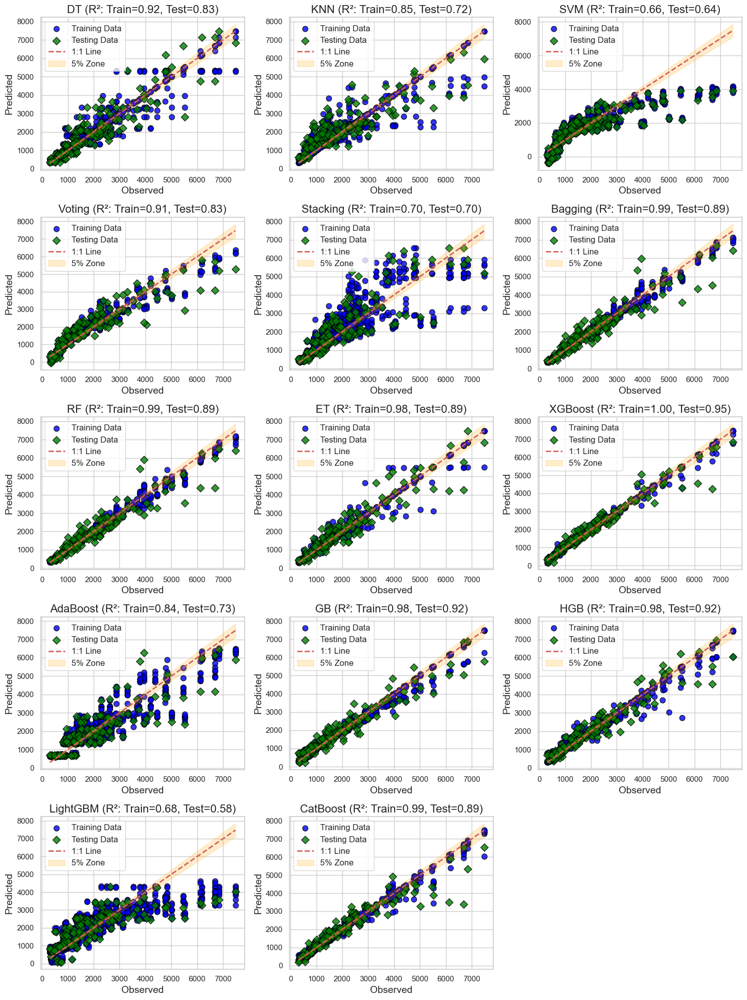

In [25]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import r2_score

# Define your models
models = ['DT', 'KNN', 'SVM', 'Voting', 'Stacking', 
          'Bagging', 'RF', 'ET', 'XGBoost', 
          'AdaBoost', 'GB', 'HGB', 'LightGBM', 'CatBoost']

# Create a figure for subplots with 3 columns
n_cols = 3
n_rows = (len(models) + n_cols - 1) // n_cols  # Calculate number of rows needed
fig, axs = plt.subplots(n_rows, n_cols, figsize=(15, n_rows * 4))
axs = axs.flatten()  # Flatten the 2D array of axes

# Loop through each model to load predicted and observed values
for i, model in enumerate(models):
    # Load the actual observed values for this model
    y_train = np.load(f'{model}_y_train.npy')  # Replace with actual filename
    y_test = np.load(f'{model}_y_test.npy')      # Replace with actual filename
    y_train_pred = np.load(f'{model}_y_train_pred.npy')
    y_test_pred = np.load(f'{model}_y_test_pred.npy')
    
    ax = axs[i]
    
    # Plot the training data with circular markers
    ax.scatter(y_train, y_train_pred, label='Training Data', color='blue', alpha=0.8, 
               marker='o', edgecolor='black', s=60)
    # Plot the testing data with diamond markers
    ax.scatter(y_test, y_test_pred, label='Testing Data', color='green', alpha=0.8, 
               marker='D', edgecolor='black', s=60)
    
    # Calculate R² values
    train_r2 = r2_score(y_train, y_train_pred)
    test_r2 = r2_score(y_test, y_test_pred)

    # Set 5% error zone
    min_val = min(min(y_train), min(y_test))
    max_val = max(max(y_train), max(y_test))
    ax.plot([min_val, max_val], [min_val, max_val], 'r--', label='1:1 Line', linewidth=2)
    ax.fill_between([min_val, max_val], 
                    [min_val * 0.95, max_val * 0.95], 
                    [min_val * 1.05, max_val * 1.05], 
                    color='orange', alpha=0.2, label='5% Zone')
    
    ax.set_title(f'{model} (R²: Train={train_r2:.2f}, Test={test_r2:.2f})', fontsize=16)
    ax.set_xlabel('Observed', fontsize=14)
    ax.set_ylabel('Predicted', fontsize=14)
    ax.legend(loc='best', fontsize=12)
    ax.grid(True)

# Hide any unused subplots
for j in range(i + 1, len(axs)):
    axs[j].axis('off')

plt.tight_layout()
#plt.show()
# Save the figure as a PDF with 300 DPI
#plt.savefig("Fig8.pdf", format="pdf", dpi=300)

Explainability of the Models

1. Cohort Plots

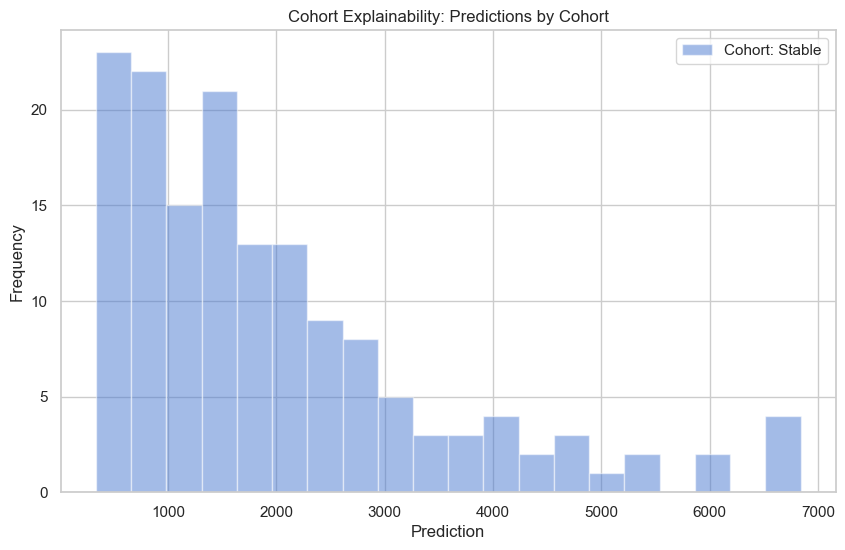

In [26]:
import numpy as np
import pandas as pd
import joblib
import matplotlib.pyplot as plt

# Load the trained Extra Trees model
model_name = 'ET'  # Example model name
model = joblib.load(f'trained_{model_name}_model.joblib')

# Standardize the features
X_scaled = scaler.transform(X)

# Predict using the loaded model
predictions = model.predict(X_scaled)

# Define a stability threshold
fos_threshold = 1.2  # Adjust this threshold based on your requirement

# Create cohorts based on the stability threshold
cohorts = np.where(predictions > fos_threshold, 'Stable', 'Failed')

# Create a DataFrame for analysis
df_cohort = pd.DataFrame({
    'Cohort': cohorts,
    'Prediction': predictions
})

# Plot the cohort explainability
fig, ax = plt.subplots(figsize=(10, 6))

# Iterate over each cohort to plot the predictions
for cohort in df_cohort['Cohort'].unique():
    subset = df_cohort[df_cohort['Cohort'] == cohort]
    ax.hist(subset['Prediction'], alpha=0.5, label=f'Cohort: {cohort}', bins=20)

ax.set_xlabel('Prediction')
ax.set_ylabel('Frequency')
ax.legend()
plt.title("Cohort Explainability: Predictions by Cohort")
plt.show()



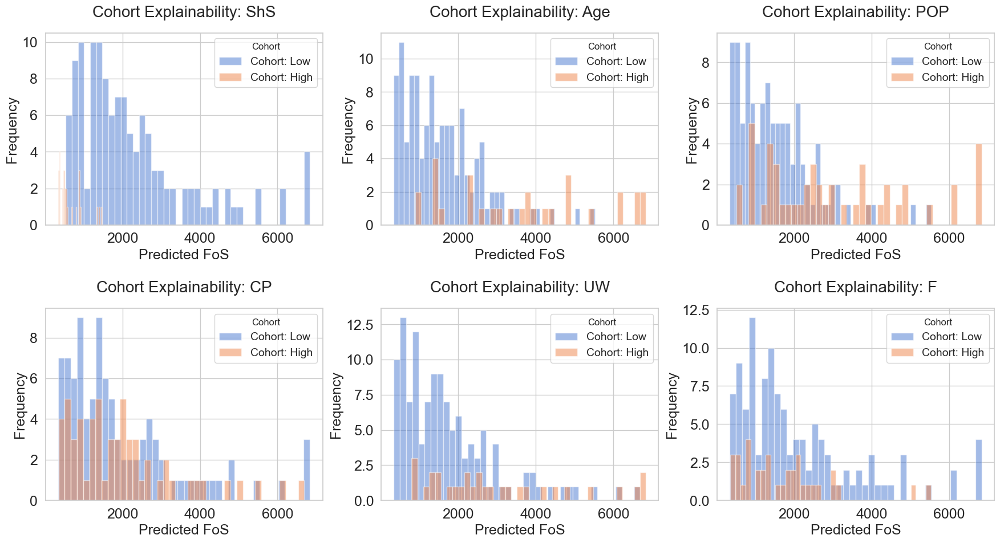

In [ ]:
import numpy as np
import pandas as pd
import joblib
import matplotlib.pyplot as plt

# Standardize the features
X_scaled = scaler.transform(X)

# Predict using the loaded model
predictions = model.predict(X_scaled)

# Define a stability threshold
fos_threshold = 1.2  # Adjust this threshold based on your requirement

# Create cohorts based on the stability threshold
cohorts = np.where(predictions > fos_threshold, 'Stable', 'Failed')

# Create a DataFrame for analysis
df_cohort = pd.DataFrame({
    'Cohort': cohorts,
    'Prediction': predictions
})

# Plot cohort explainability for each feature
n_features = X.shape[1]
n_rows = (n_features + 2) // 3  # Calculate rows based on the number of features
fig, axs = plt.subplots(nrows=n_rows, ncols=3, figsize=(18, n_rows * 5))
axs = axs.ravel()  # Flatten the 2D array of axes

# Font sizes for publication quality
font_size = 18
legend_font_size = 14
title_font_size = 20

# Iterate over each feature to plot predictions by cohort
for i in range(n_features):
    feature_name = df.columns[i]
    
    # Create cohorts for the current feature
    feature_cohorts = pd.cut(X[:, i], bins=2, labels=["Low", "High"])
    
    # Create a DataFrame for analysis by feature cohorts
    df_feature_cohort = pd.DataFrame({
        'Cohort': feature_cohorts,
        'Prediction': predictions
    })
    
    # Plotting the predictions by cohort for this feature
    for cohort in df_feature_cohort['Cohort'].unique():
        subset = df_feature_cohort[df_feature_cohort['Cohort'] == cohort]
        axs[i].hist(subset['Prediction'], alpha=0.5, label=f'Cohort: {cohort}', bins=40)
    
    # Set plot labels and title with increased font sizes
    axs[i].set_xlabel('Predicted FoS', fontsize=font_size)
    axs[i].set_ylabel('Frequency', fontsize=font_size)
    axs[i].legend(title='Cohort', fontsize=legend_font_size)
    axs[i].set_title(f'Cohort Explainability: {feature_names[i]}', fontsize=title_font_size, pad=20)
    axs[i].tick_params(axis='both', labelsize=font_size)  # Increase tick label size

# Hide any unused subplots
for j in range(i + 1, len(axs)):
    axs[j].axis('off')

# Adjust layout
plt.tight_layout(pad=2.0)  # Adjust padding as needed

#plt.show()
# Save the figure as a PDF with 300 DPI
#plt.savefig("Fig9.pdf", format="pdf", dpi=300)

2. Partial dependency plots

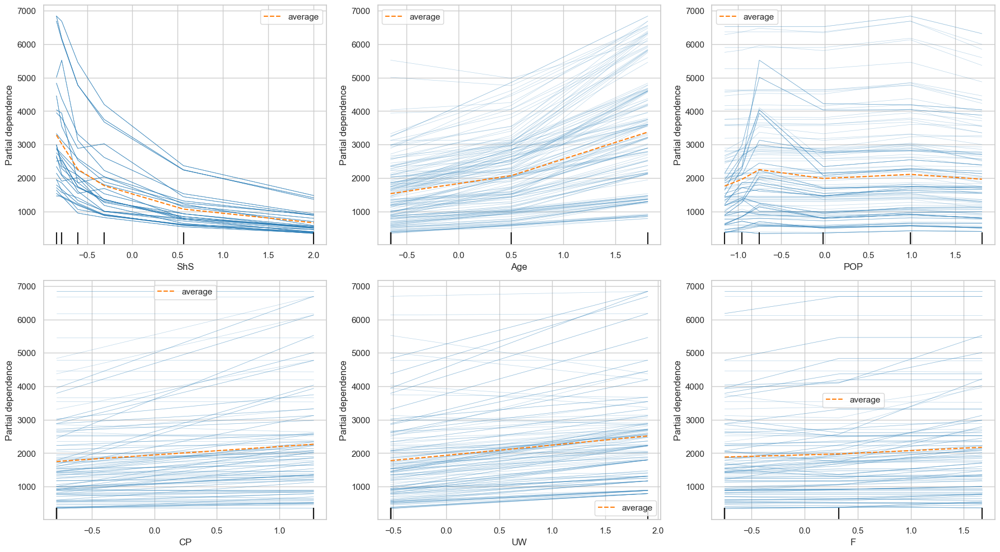

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.ensemble import ExtraTreesRegressor
from sklearn.inspection import PartialDependenceDisplay
from sklearn.preprocessing import StandardScaler
import joblib

# Standardize the features
X_scaled = scaler.transform(X)

# Define the features to plot
features_to_plot = list(range(X_scaled.shape[1]))  # Assuming you want to plot all features

# Create a figure with multiple subplots
n_features = len(features_to_plot)
n_rows = (n_features + 2) // 3  # Calculate rows based on the number of features
fig, axs = plt.subplots(nrows=n_rows, ncols=3, figsize=(18, n_rows * 5))
axs = axs.ravel()  # Flatten the 2D array of axes

# Define a color for ICE plots
ice_color = 'orange'

# Font sizes for publication quality
font_size = 40
title_font_size = 20
axis_title_font_size = 30  # Increased axis title font size
legend_font_size = 18

for i, feature in enumerate(features_to_plot):
    # Create the Partial Dependence and ICE plots
    display = PartialDependenceDisplay.from_estimator(
        model,
        X_scaled,
        features=[feature],
        feature_names=feature_names,
        kind='both',  # Both PDP and ICE plots
        ax=axs[i]
    )
    
    # Plot adjustments
    #axs[i].set_title(f'Feature: {feature_names[feature]}', pad=20, fontsize=title_font_size)  # Title with padding
    axs[i].set_xlabel('Feature Value', fontsize=axis_title_font_size)  # Increased axis title size
    axs[i].set_ylabel('Predicted Value', fontsize=axis_title_font_size)  # Increased axis title size
    
    # Adjust the ICE line
    for line in axs[i].lines:
        if line.get_label() == 'Individual Conditional Expectation':
            line.set_color(ice_color)
            line.set_linewidth(4)  # Make the ICE line bold
    
    # Set tick parameters
    axs[i].tick_params(axis='both', labelsize=font_size)  # Increase tick label size

# Hide any unused subplots
for j in range(i + 1, len(axs)):
    axs[j].axis('off')

# Reduce space between subplots
plt.tight_layout(pad=1)  # Adjust padding as needed

#plt.show()
# Save the figure as a PDF with 300 DPI
#plt.savefig("Fig14.pdf", format="pdf", dpi=300)

3. SHAP Explainability Plots

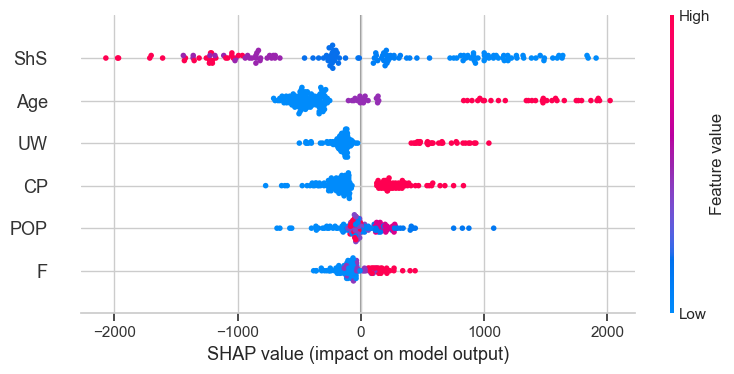

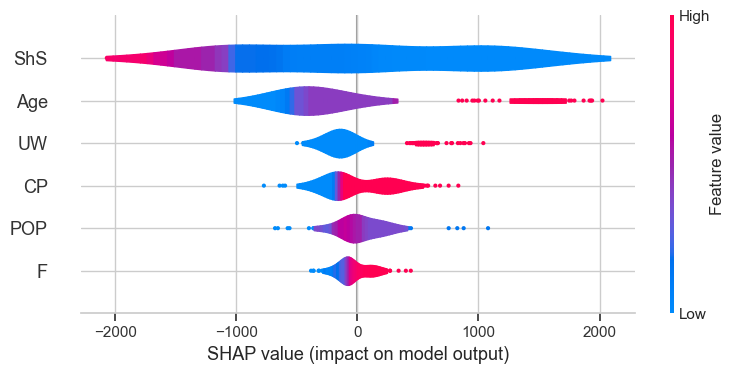

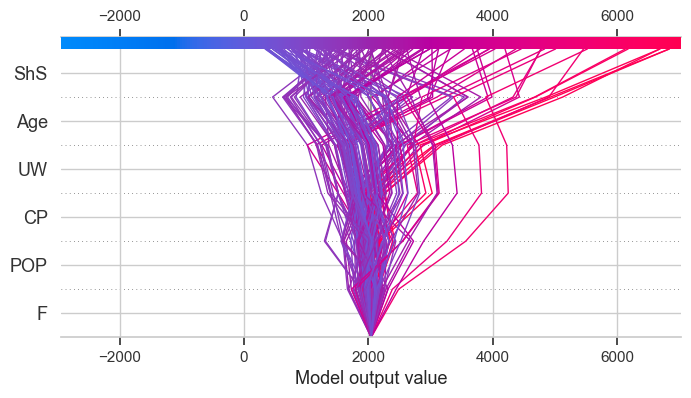

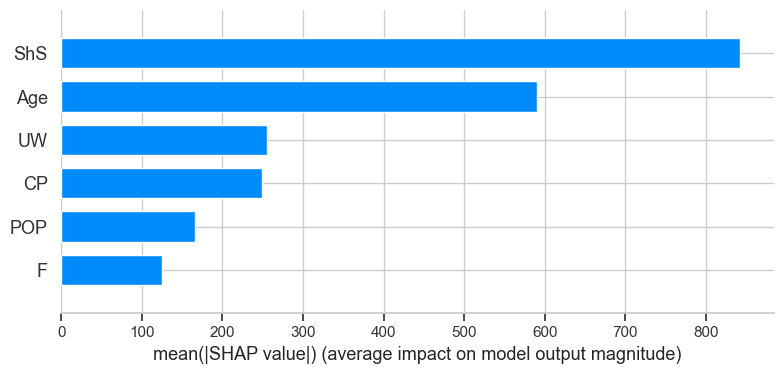

In [30]:
import shap
import joblib
import numpy as np
import matplotlib.pyplot as plt

# Load the trained CatBoost model
model_name = 'ET'
model = joblib.load(f'trained_{model_name}_model.joblib')

# Initialize SHAP TreeExplainer (specific for tree-based models)
explainer = shap.TreeExplainer(model)

# Calculate SHAP values for the dataset
shap_values = explainer.shap_values(X_scaled)

# Create the SHAP summary plot without displaying it
shap.summary_plot(shap_values, X, feature_names=feature_names, show=False)

# Save the current figure as a PDF file with 300 DPI
#plt.savefig('Fig11a.pdf', format='pdf', dpi=300, bbox_inches='tight')

plt.show()

# Clear the plot to avoid overlapping if running multiple plots in a loop
plt.clf()

# SHAP Layered Violin Plot
shap.summary_plot(shap_values, X, feature_names=feature_names, plot_type='violin')

# SHAP Decision Plot
shap.decision_plot(explainer.expected_value, shap_values, X, feature_names=feature_names, show=False)
# Save the current figure as a PDF file with 300 DPI
#plt.savefig('Fig11b.pdf', format='pdf', dpi=300, bbox_inches='tight')
plt.show()

# SHAP Feature Importance Plot
shap.summary_plot(shap_values, X, feature_names=feature_names, plot_type='bar')

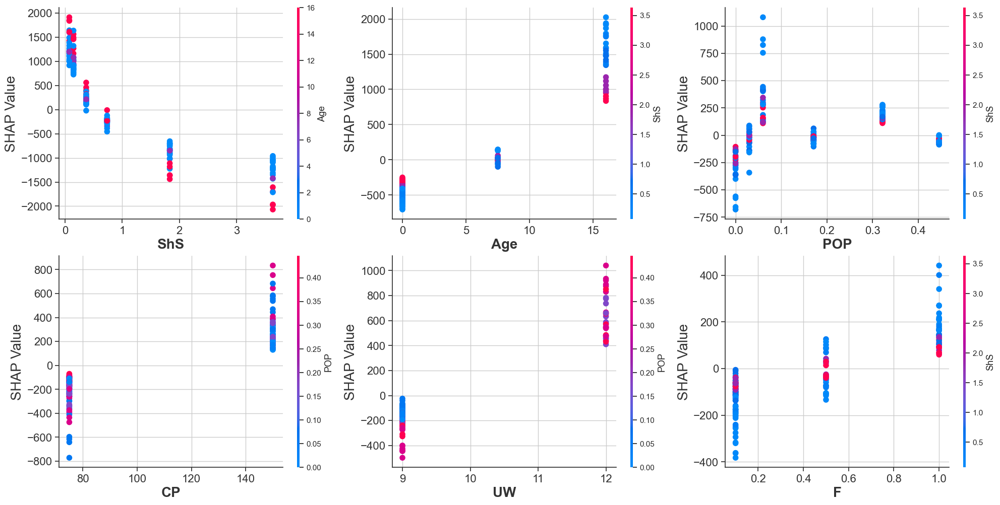

In [31]:
# Define the number of rows and columns for the subplots (2 rows and 3 columns for 6 features)
n_rows = 2
n_cols = 3

# Set up the figure with subplots
fig, axes = plt.subplots(n_rows, n_cols, figsize=(20, 10))  # Increased figure size for better readability
axes = axes.flatten()  # Flatten the axes for easy iteration

# Loop over each feature and plot its SHAP dependence plot in the corresponding subplot
for i in range(len(feature_names)):
    plt.sca(axes[i])  # Set the current axis
    
    # Plot SHAP dependence plot with larger scatter points
    shap.dependence_plot(i, shap_values, X, feature_names=feature_names, show=False, ax=axes[i])  # Basic plot

    # Get the current axis handle and modify scatter plot sizes
    scatter = axes[i].collections[0]  # Access the scatter plot object
    scatter.set_sizes([70] * len(scatter.get_offsets()))  # Set point sizes to 80 for better visibility
    
    # Adjust the axis labels' font size
    axes[i].set_xlabel(feature_names[i], fontsize=20, fontweight='bold')  # Make x-axis title bold and large
    axes[i].set_ylabel('SHAP Value', fontsize=20)  # Increase y-axis label size
    
    # Increase the tick label size
    axes[i].tick_params(axis='both', which='major', labelsize=16)

# Hide any unused subplots if there are fewer features than subplot slots
for j in range(len(feature_names), n_rows * n_cols):
    fig.delaxes(axes[j])  # Remove extra axes

# Adjust layout to prevent overlap using tight_layout
plt.tight_layout(pad=0.5)  # Adjust padding between subplots for better spacing

# Show the final plot with all dependence plots in the specified row/column format
# Save the current figure as a PDF file with 300 DPI
#plt.savefig('Fig12.pdf', format='pdf', dpi=300)


Force Plot for Instance (Index 4)


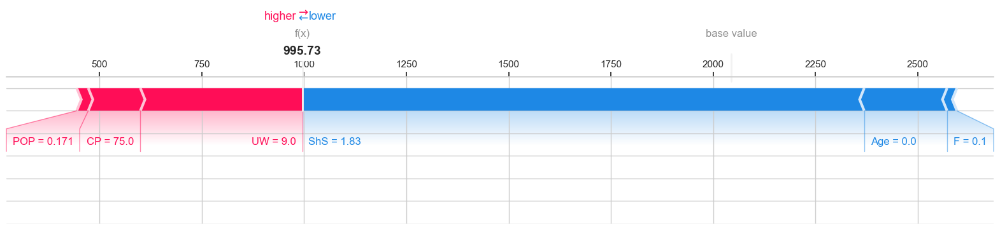

Actual Model Prediction (f(x)) for instance: 995.7316000000002
SHAP Prediction (expected_value + SHAP values) for instance: [995.7316]



In [32]:
import shap
import numpy as np
import random
import matplotlib.pyplot as plt

# Calculate SHAP values
shap_values_with_names = explainer.shap_values(X)

# Get the model predictions for the dataset
predictions = model.predict(X)

# Get a random index from the dataset
random_index = random.choice(range(X.shape[1]))

# Force plot for the selected instance
print(f"Force Plot for Instance (Index {random_index})")

# Calculate SHAP prediction (expected_value + SHAP values sum)
shap_prediction = explainer.expected_value + np.sum(shap_values_with_names[random_index])

# Create the force plot with matplotlib enabled
#fig, ax = plt.subplots(figsize=(8, 4))  # Adjust the figure size as needed

# Use shap.force_plot to create the force plot
shap.force_plot(explainer.expected_value, shap_values_with_names[random_index], 
                 features=X[random_index], feature_names=feature_names, 
                 matplotlib=True, show=False)

# Save the current figure as a PDF file with 300 DPI
#plt.savefig('Fig10b.pdf', format='pdf', dpi=300, bbox_inches='tight')
# Show the plot
plt.show()

# Print the prediction for this instance (f(x) value)
print(f"Actual Model Prediction (f(x)) for instance: {predictions[random_index]}")
print(f"SHAP Prediction (expected_value + SHAP values) for instance: {shap_prediction}\n")



4. LIME Explaianbility Plots

<Figure size 1200x800 with 0 Axes>

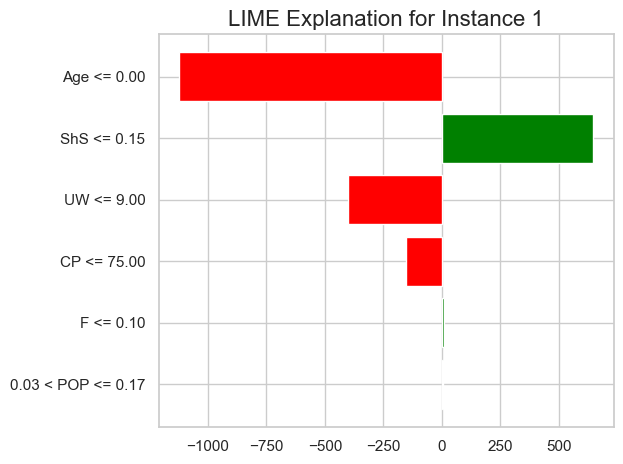

In [33]:
import numpy as np
import pandas as pd
import joblib
import matplotlib.pyplot as plt
from lime.lime_tabular import LimeTabularExplainer

# Load the saved Extra Trees Regressor model and scaler
#model = joblib.load('Extra Trees_model.joblib')
#scaler = joblib.load('Extra Trees_scaler.joblib')

# Load your dataset (assuming it's already loaded in X)
# Example:
# df = pd.read_excel('path_to_your_data.xlsx', sheet_name='Sheet1')
# X = df.drop('target_column', axis=1).values
# feature_names = X.columns.tolist()

# Initialize LimeTabularExplainer without scaling
explainer = LimeTabularExplainer(
    training_data=X,  # Use original data without scaling
    feature_names=feature_names,
    mode='regression'
)

# Choose a data instance to explain (for example, the first instance)
instance_idx = 1
instance = X[instance_idx]  # Use original instance without scaling

# Generate explanation
explanation = explainer.explain_instance(
    instance,
    model.predict,
    num_features=len(feature_names)
)

# Plot the explanation
plt.figure(figsize=(12, 8))
explanation.as_pyplot_figure()
plt.title(f"LIME Explanation for Instance {instance_idx}", fontsize=16)
plt.tight_layout()
#plt.show()
# Save the figure as a PDF with 300 DPI
#plt.savefig("Fig13b.pdf", format="pdf", dpi=300)
plt.show()


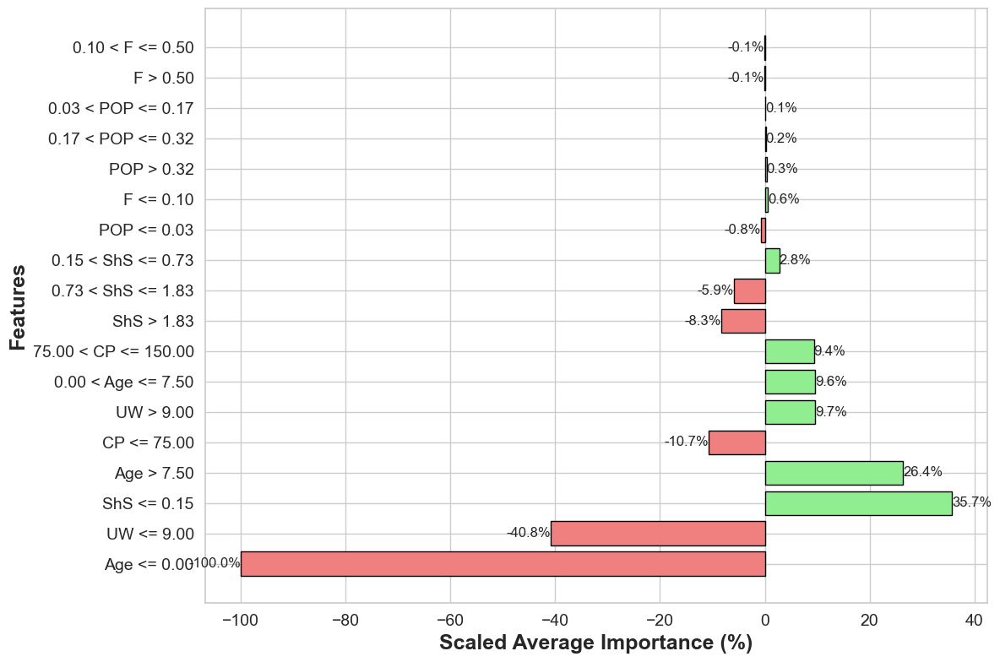

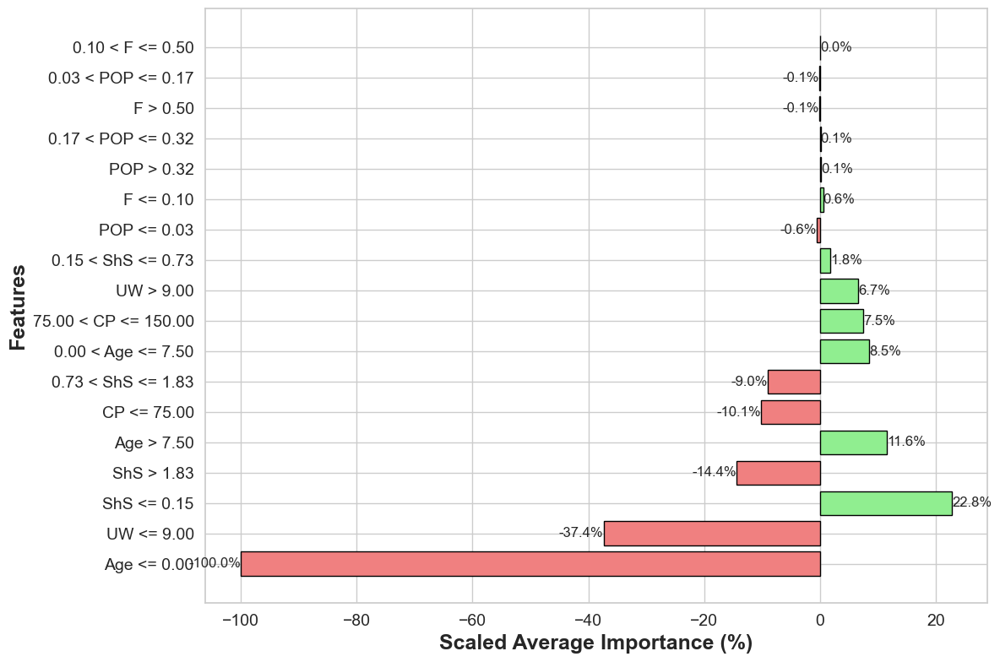

In [35]:
import numpy as np
import pandas as pd
import joblib
import matplotlib.pyplot as plt
from lime.lime_tabular import LimeTabularExplainer
from collections import defaultdict

# Load your dataset (assuming it's already loaded in X)
# Example:
# df = pd.read_excel('path_to_your_data.xlsx', sheet_name='Sheet1')
# X = df.drop('target_column', axis=1).values
# feature_names = df.drop('target_column', axis=1).columns.tolist()

# Initialize LimeTabularExplainer without scaling
explainer = LimeTabularExplainer(
    training_data=X,  # Use original data without scaling
    feature_names=feature_names,
    mode='regression'
)

# Choose a set of instances to explain
num_instances = min(46, len(X))  # Number of instances to explain
indices = np.random.choice(range(len(X)), num_instances, replace=False)

# Initialize a dictionary to accumulate feature importances
feature_importances_accumulated = defaultdict(float)

# Process each instance
for instance_idx in indices:
    instance = X[instance_idx]  # Use original instance without scaling
    
    # Generate explanation
    explanation = explainer.explain_instance(
        instance,
        model.predict,
        num_features=len(feature_names)
    )
    
    # Extract feature importances
    importances = dict(explanation.as_list())
    
    # Accumulate feature importances
    for feature, importance in importances.items():
        feature_importances_accumulated[feature] += importance

# Average the feature importances
feature_importances_avg = {feature: importance / num_instances for feature, importance in feature_importances_accumulated.items()}

# Scale the absolute values of the feature importances to [0, 100]
max_importance = max(abs(val) for val in feature_importances_avg.values())
scaled_importances = {feature: (importance / max_importance) * 100 for feature, importance in feature_importances_avg.items()}

# Sort features by importance
sorted_features = sorted(scaled_importances.items(), key=lambda x: abs(x[1]), reverse=True)
features, scaled_avg_importances = zip(*sorted_features)

# Plot the scaled LIME feature importances with publication-ready adjustments
plt.figure(figsize=(12, 8))

# Customize bar colors based on the sign of importance
colors = ['lightcoral' if feature_importances_avg[feature] < 0 else 'lightgreen' for feature in features]
bars = plt.barh(features, scaled_avg_importances, color=colors, edgecolor='black')

# Add labels to bars (feature names and their scaled importance values)
plt.bar_label(bars, fmt='%.1f%%', fontsize=12)

# Increase font sizes for publication
plt.xlabel('Scaled Average Importance (%)', fontsize=18, fontweight='bold')
plt.ylabel('Features', fontsize=18, fontweight='bold')
plt.xticks(fontsize=14)
plt.yticks(fontsize=14)

# Set title
#plt.title('Scaled Average LIME Feature Importances Across Instances', fontsize=20, fontweight='bold')

# Adjust layout to remove extra space
plt.tight_layout()

# Display the plot
plt.show()
# Save the figure as a PDF with 300 DPI
#plt.savefig("Fig13c.pdf", format="pdf", dpi=300)


6. Residual Plots

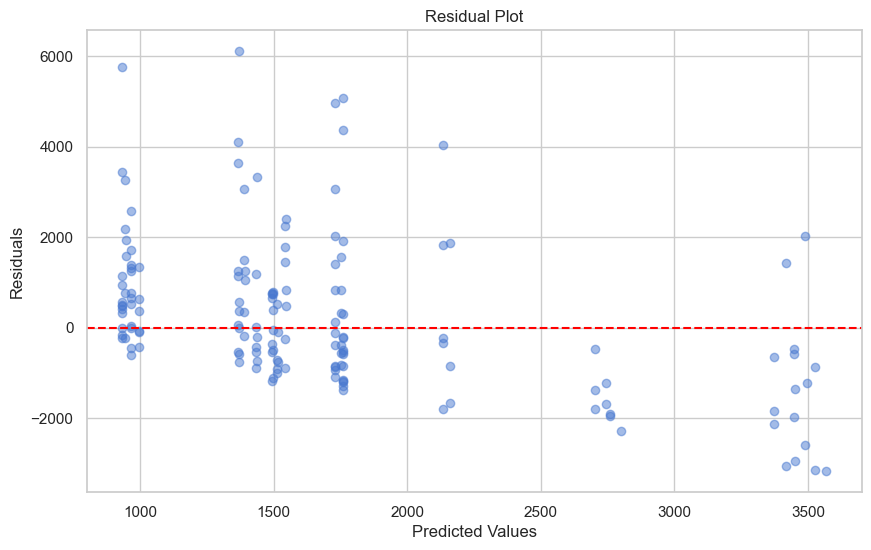

In [36]:
# 6. Residual Plots
predictions = model.predict(X)
residuals = y_test - predictions

plt.figure(figsize=(10, 6))
plt.scatter(predictions, residuals, alpha=0.5)
plt.axhline(0, color='red', linestyle='--')
plt.title('Residual Plot')
plt.xlabel('Predicted Values')
plt.ylabel('Residuals')
plt.show()

Parametric sensitivity analysis

     Mean Sensitivity  Standard Deviation  Max Sensitivity  Min Sensitivity  \
ShS          0.830556            0.420814         1.760983         0.402028   
Age          0.333638            0.328454         1.110180         0.093299   
POP          0.117496            0.037692         0.237596         0.066501   
CP           0.121520            0.049497         0.208330         0.079155   
UW           0.131792            0.132457         0.433322         0.036912   
F            0.072736            0.033933         0.134451         0.030256   

        Range  
ShS  1.358954  
Age  1.016881  
POP  0.171095  
CP   0.129175  
UW   0.396411  
F    0.104195  


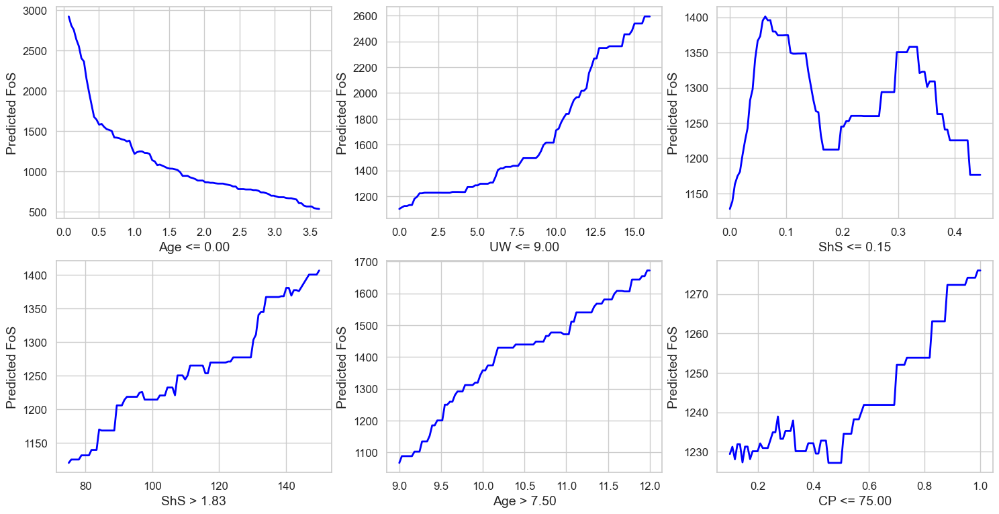

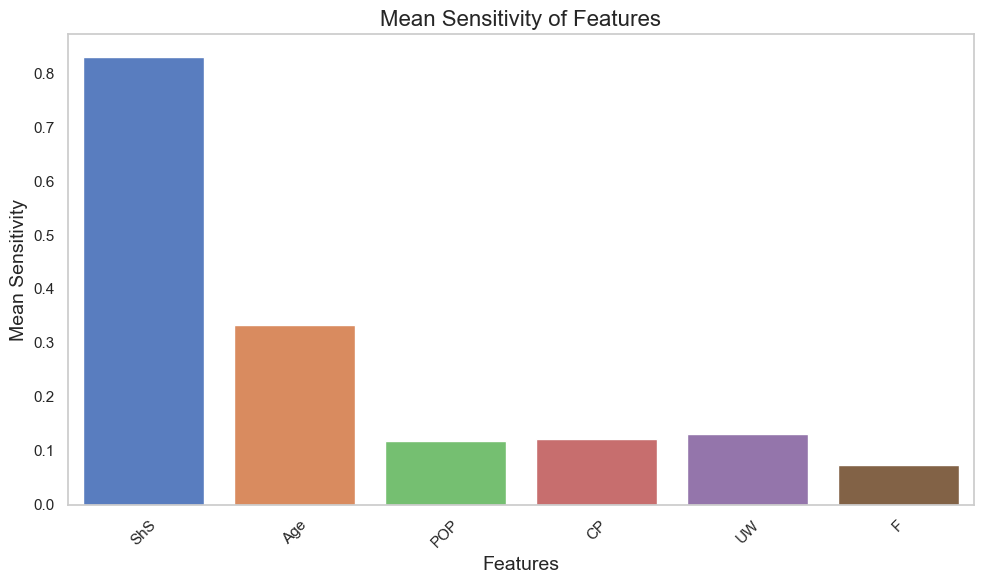

In [45]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import KFold

# Feature symbols for better readability in plots
features=['ShS', 'Age', 'POP', 'CP', 'UW', 'F']

# Number of quantiles to use for sensitivity analysis
num_quantiles = 10

# Number of splits
num_splits = 5

# Perform KFold cross-validation to generate different data splits
kf = KFold(n_splits=num_splits, shuffle=True, random_state=42)

# Initialize lists to store sensitivity results for each quantile
sensitivities = {feature: [] for feature in features}

# Function to calculate sensitivity for a feature over different quantiles
def calculate_sensitivity_quantiles(model, X, feature_index, quantiles):
    base_preds = model.predict(X)
    sensitivity_values = []
    
    for quantile in quantiles:
        perturbed_X = X.copy()
        perturbed_X[:, feature_index] = np.quantile(X[:, feature_index], quantile)
        perturbed_preds = model.predict(perturbed_X)
        sensitivity = np.abs(perturbed_preds - base_preds) / np.abs(base_preds)
        sensitivity_values.append(np.mean(sensitivity))
    
    return sensitivity_values

# Loop over each split
for split_num, (train_index, test_index) in enumerate(kf.split(X)):
    X_train, X_test = X[train_index], X[test_index]
    y_train, y_test = y[train_index], y[test_index]
    
    # Fit the model on each train split (assuming the model is already initialized)
    model.fit(X_train, y_train)

    # Define the quantiles (10 equally spaced quantiles between 0 and 1)
    quantiles = np.linspace(0, 1, num_quantiles)
    
    # Loop over each feature to compute sensitivity at different quantiles
    for i, feature in enumerate(features):
        sensitivities[feature].append(calculate_sensitivity_quantiles(model, X_test, i, quantiles))

# Calculate metrics for each feature
metrics = {
    'Mean Sensitivity': {},
    'Standard Deviation': {},
    'Max Sensitivity': {},
    'Min Sensitivity': {},
    'Range': {}
}

for feature in features:
    all_sensitivities = np.array(sensitivities[feature])
    metrics['Mean Sensitivity'][feature] = np.mean(all_sensitivities)
    metrics['Standard Deviation'][feature] = np.std(all_sensitivities)
    metrics['Max Sensitivity'][feature] = np.max(all_sensitivities)
    metrics['Min Sensitivity'][feature] = np.min(all_sensitivities)
    metrics['Range'][feature] = np.max(all_sensitivities) - np.min(all_sensitivities)

# Convert metrics to DataFrame for easier visualization
import pandas as pd
metrics_df = pd.DataFrame(metrics)

# Display the metrics DataFrame
print(metrics_df)

# Plot the Mean Sensitivity for each feature
plt.figure(figsize=(10, 6))
sns.barplot(x=list(metrics['Mean Sensitivity'].keys()), y=list(metrics['Mean Sensitivity'].values()))
plt.title('Mean Sensitivity of Features', fontsize=16)
plt.xlabel('Features', fontsize=14)
plt.ylabel('Mean Sensitivity', fontsize=14)
plt.xticks(rotation=45)
plt.grid(axis='y')
plt.tight_layout()
plt.show()

# Create a figure with subplots for sensitivities
n_cols = 3
n_rows = 2
fig, axs = plt.subplots(n_rows, n_cols, figsize=(15, 10))
axs = axs.flatten()
sns.set_style("whitegrid")
colors = sns.color_palette("deep", len(features))

# Plot the sensitivities for each feature as line plots with quantiles on x-axis
for i, feature in enumerate(features):
    for split_num in range(num_splits):
        quantiles = np.linspace(0, 1, num_quantiles)
        axs[i].plot(quantiles, sensitivities[feature][split_num], marker='o', label=f'Split {split_num+1}', alpha=0.7, linewidth=2)
    
    axs[i].set_title(f'Sensitivity for {feature}', fontsize=16)
    axs[i].set_xlabel('Quantiles', fontsize=14)
    axs[i].set_ylabel('Sensitivity', fontsize=14)
    axs[i].legend()
    axs[i].grid(True)

# Adjust layout and remove any unused subplots
plt.tight_layout()
#plt.show()
# Save the figure as a PDF with 300 DPI
#plt.savefig("Fig15.pdf", format="pdf", dpi=300)


Parametric studies for all prediction models with varying one explanatory variable across its range while holding the other explanatory variables constant at their mean

C:\Users\satya\AppData\Local\Temp\ipykernel_28724\1627126575.py:30: DeprecationWarning:

Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)

C:\Users\satya\AppData\Local\Temp\ipykernel_28724\1627126575.py:30: DeprecationWarning:

Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)

C:\Users\satya\AppData\Local\Temp\ipykernel_28724\1627126575.py:30: DeprecationWarning:

Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)

C:\Users\satya\AppData\Local\Temp\ipykernel_28724\1627126575.py:30: DeprecationWarning:

Conversion of an array with ndim > 0 t

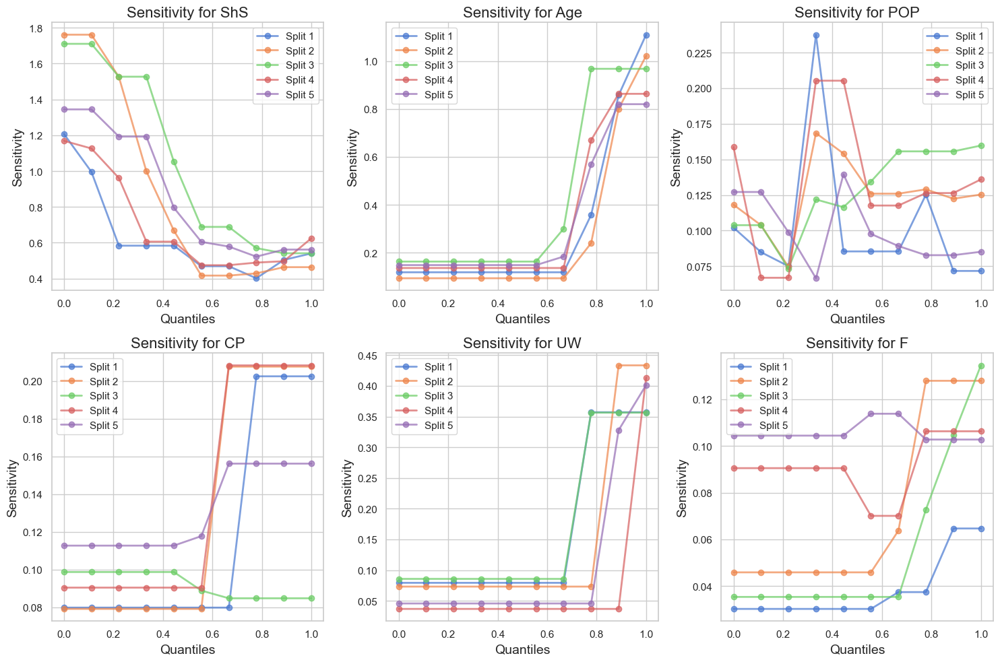

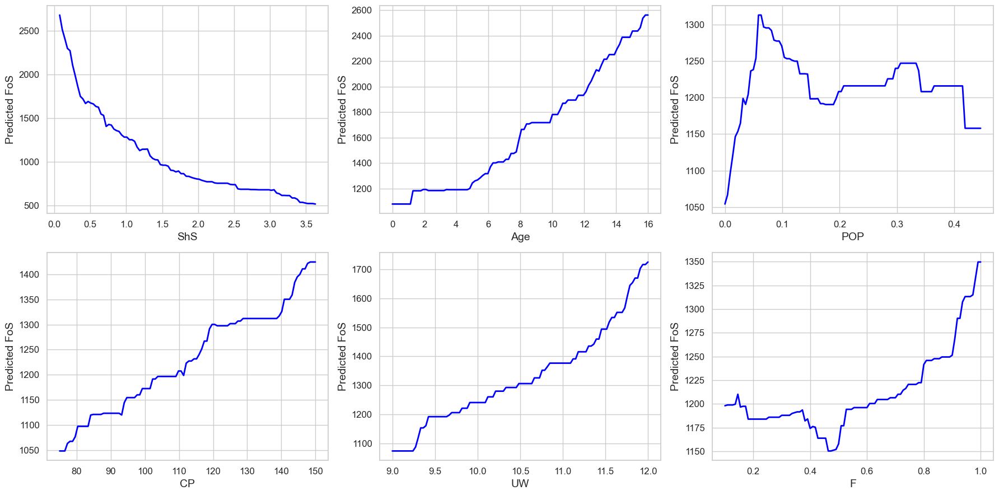

In [46]:
import numpy as np
import matplotlib.pyplot as plt

# Define the feature names (with subscript formatting for r_u)
#features = ['γ', 'c', 'φ', 'β', 'H', r'$r_{u}$']

# Hold other variables constant at their mean
mean_values = X_train.mean(axis=0)

# Create a figure for the plots
plt.figure(figsize=(18, 9))  # Increased figure size for better clarity

# Perform parametric analysis for each feature
for i, feature_name in enumerate(features):
    # Get the feature index
    feature_index = i
    # Generate a grid of values for the current feature
    feature_values = np.linspace(X_train[:, feature_index].min(), X_train[:, feature_index].max(), 100)

    # Initialize an array to hold predictions
    feature_predictions = np.zeros(len(feature_values))

    # Loop through each value of the feature
    for j, value in enumerate(feature_values):
        # Create a copy of the mean values
        instance = mean_values.copy()
        # Update the feature of interest
        instance[feature_index] = value
        # Get prediction for the current instance
        feature_predictions[j] = model.predict(instance.reshape(1, -1))

    # Plot the predictions against the feature values
    plt.subplot(2, 3, i + 1)  # 2 rows and 3 columns of subplots
    plt.plot(feature_values, feature_predictions, label=feature_name, color='blue', linewidth=2)
    #plt.title(f'Prediction vs {feature_name}', fontsize=16)
    plt.xlabel(feature_name, fontsize=14)
    plt.ylabel('Predicted FoS', fontsize=14)
    plt.grid(True)
    plt.xticks(fontsize=12)
    plt.yticks(fontsize=12)

# Adjust layout for better spacing
plt.tight_layout()
plt.show()


2-way partial dependence and individual conditional expectation plot 

7. Sobol Sensitivity Analysis

C:\Users\satya\AppData\Local\Temp\ipykernel_28724\4163508897.py:33: DeprecationWarning:

`salib.sample.saltelli` will be removed in SALib 1.5. Please use `salib.sample.sobol`

c:\ProgramData\anaconda3\lib\site-packages\SALib\sample\saltelli.py:109: UserWarning:


        Convergence properties of the Sobol' sequence is only valid if
        `N` (1000) is equal to `2^n`.
        



           ST   ST_conf
ShS  0.000000  0.000000
Age  0.000000  0.000000
POP  0.077720  0.007706
CP   0.000000  0.000000
UW   0.000000  0.000000
F    0.948799  0.065077
           S1   S1_conf
ShS  0.000000  0.000000
Age  0.000000  0.000000
POP  0.060663  0.029050
CP   0.000000  0.000000
UW   0.000000  0.000000
F    0.920800  0.069392
                      S2       S2_conf
(ShS, Age)  0.000000e+00  0.000000e+00
(ShS, POP) -6.938894e-18  2.543442e-17
(ShS, CP)   0.000000e+00  0.000000e+00
(ShS, UW)   0.000000e+00  0.000000e+00
(ShS, F)    0.000000e+00  1.842765e-16
(Age, POP) -6.938894e-18  2.543442e-17
(Age, CP)   0.000000e+00  0.000000e+00
(Age, UW)   0.000000e+00  0.000000e+00
(Age, F)    0.000000e+00  1.842765e-16
(POP, CP)  -1.898245e-02  4.419205e-02
(POP, UW)  -1.898245e-02  4.419205e-02
(POP, F)    1.527190e-02  5.538938e-02
(CP, UW)    0.000000e+00  0.000000e+00
(CP, F)     0.000000e+00  1.842765e-16
(UW, F)     0.000000e+00  1.842765e-16


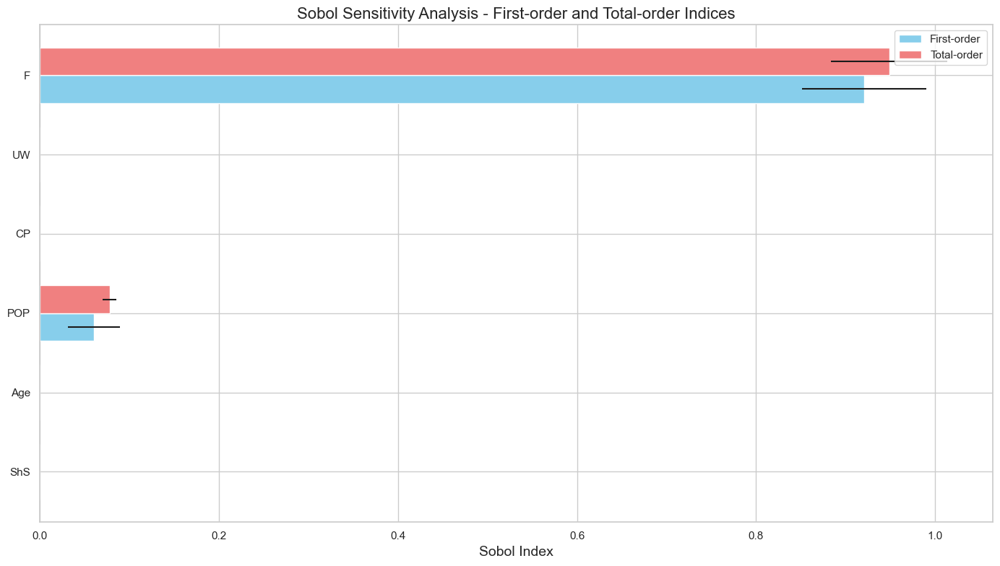

In [47]:
import numpy as np
import pandas as pd
import joblib
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import ExtraTreesRegressor
from SALib.analyze import sobol
from SALib.sample import saltelli
from sklearn.metrics import mean_squared_error

# Load the saved Extra Trees Regressor model and scaler
#model = joblib.load('Extra Trees_model.joblib')
#scaler = joblib.load('Extra Trees_scaler.joblib')

# Load your dataset (assuming it's already loaded in X)
# Example:
# df = pd.read_excel('path_to_your_data.xlsx', sheet_name='Sheet1')
# X = df.drop('target_column', axis=1).values
# feature_names = X.columns.tolist()

# Ensure X is defined correctly
# Standardize the features
X_scaled = scaler.transform(X)

# Define the Sobol problem
problem = {
    'num_vars': X_scaled.shape[1],
    'names': feature_names,
    'bounds': [[0, 1]] * X_scaled.shape[1]  # Adjust based on the actual bounds of your features
}

# Generate samples using Saltelli's sampling method
param_values = saltelli.sample(problem, 1000)

# Define a function to predict using the model
def predict(params):
    params_scaled = scaler.transform(params)
    return model.predict(params_scaled)

# Calculate the outputs (Y) for the generated samples
Y = predict(param_values)

# Perform Sobol sensitivity analysis
sobol_indices = sobol.analyze(problem, Y, print_to_console=True)

# Extract Sobol indices
S1 = sobol_indices['S1']
S1_conf = sobol_indices['S1_conf']
ST = sobol_indices['ST']
ST_conf = sobol_indices['ST_conf']

# Combine both First-order and Total-order indices in one plot
plt.figure(figsize=(14, 8))

# Bar width for plotting
bar_width = 0.35
index = np.arange(len(feature_names))

# Plot First-order indices
plt.barh(index, S1, bar_width, xerr=S1_conf, color='skyblue', label='First-order')

# Plot Total-order indices
plt.barh(index + bar_width, ST, bar_width, xerr=ST_conf, color='lightcoral', label='Total-order')

# Set feature names on y-axis
plt.yticks(index + bar_width / 2, feature_names)

# Labels and title
plt.xlabel('Sobol Index', fontsize=14)
plt.title('Sobol Sensitivity Analysis - First-order and Total-order Indices', fontsize=16)
plt.legend()

# Improve layout and show the plot
plt.tight_layout()
plt.show()
